In [1]:
import os
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.feature_selection import VarianceThreshold

In [2]:
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.preprocessing import StandardScaler
import torch.optim.lr_scheduler as lr_scheduler
from sklearn.metrics import r2_score, mean_squared_error

In [3]:
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
import time
from sklearn.metrics import mean_absolute_error
import seaborn as sns

## Load dataset

In [4]:
path_out = r'F:\Codes\joint attention\Nano-particle\output'
file_path_features = os.path.join(path_out , 'features_selected_35_original.npy')
file_path_labels = os.path.join(path_out , 'labels_selected_1_original.npy')
file_path_features_stand = os.path.join(path_out , 'features_selected_35_standardized.npy')
with open( file_path_features , 'rb') as f:
    features = np.load(f)
with open( file_path_labels , 'rb') as f:
    labels = np.load(f)
with open( file_path_features_stand , 'rb') as f:
    features_stand = np.load(f)
print(features.shape)
print(labels.shape)
print(features_stand.shape)

(3999, 35)
(3999, 1)
(3999, 35)


## Visualize data

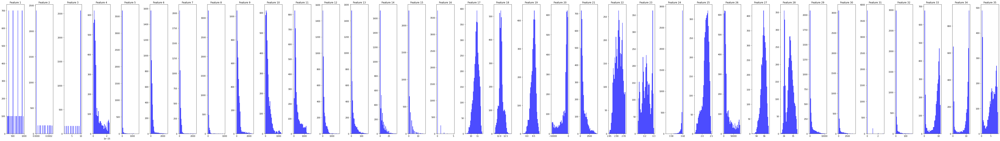

In [5]:
data = features
fig, axs = plt.subplots(nrows=1, ncols=35, figsize=(70, 10))
for i in range(35):
    axs[i].hist(data[:, i], bins=30, color='blue', alpha=0.7)
    axs[i].set_title(f'Feature {i+1}')
plt.tight_layout()
plt.show()


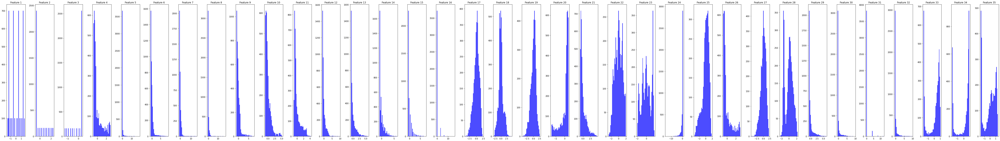

In [6]:
data = features_stand
fig, axs = plt.subplots(nrows=1, ncols=35, figsize=(70, 10))
for i in range(35):
    axs[i].hist(data[:, i], bins=30, color='blue', alpha=0.7)
    axs[i].set_title(f'Feature {i+1}')
plt.tight_layout()
plt.show()

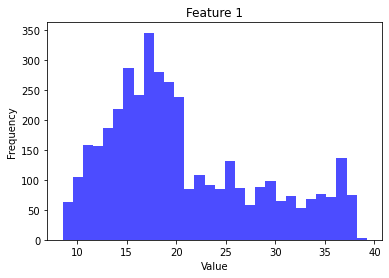

In [7]:
data = labels
plt.hist(data[:, 0], bins=30, color='blue', alpha=0.7)
plt.title('Feature 1')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

## Split the dataset into train , test and validation splits

In [8]:
# Split data into train and test sets
features_train, features_test, labels_train, labels_test = train_test_split(features, labels, test_size=0.2, random_state=42)

print(f"features train shape: {features_train.shape}")
print(f"features test shape: {features_test.shape}") # tmp 
print(f"labels train shape: {labels_train.shape}")
print(f"labes test shape: {labels_test.shape}") # tmp

print(f"features train type: {type(features_train)}")
print(f"features test type: {type(features_test)}")
print(f"labels train type: {type(labels_train)}")
print(f"labes test type: {type(labels_test)}")

#test set again split into actual test and validation sets
features_validation, features_test, labels_validation, labels_test = train_test_split(features_test, labels_test, test_size=0.51, random_state=42)

print(f"features validation shape: {features_validation.shape}")
print(f"features test shape: {features_test.shape}")
print(f"labels validation shape: {labels_validation.shape}")
print(f"labes test shape: {labels_test.shape}")

print(f"features validation type: {type(features_validation)}")
print(f"features test type: {type(features_test)}")
print(f"labels validation type: {type(labels_validation)}")
print(f"labes test type: {type(labels_test)}")

features train shape: (3199, 35)
features test shape: (800, 35)
labels train shape: (3199, 1)
labes test shape: (800, 1)
features train type: <class 'numpy.ndarray'>
features test type: <class 'numpy.ndarray'>
labels train type: <class 'numpy.ndarray'>
labes test type: <class 'numpy.ndarray'>
features validation shape: (392, 35)
features test shape: (408, 35)
labels validation shape: (392, 1)
labes test shape: (408, 1)
features validation type: <class 'numpy.ndarray'>
features test type: <class 'numpy.ndarray'>
labels validation type: <class 'numpy.ndarray'>
labes test type: <class 'numpy.ndarray'>


## Model Training

## Linear Regression

In [9]:
labels = labels_validation.squeeze()


models = {
    'Linear Regression': LinearRegression()
}

predictions_list = []
models_ = []

for name, model in models.items():
    
    training_start = time.time()
    _tmp = model.fit(features_train, labels_train)
    training_end = time.time()
    
    models_.append(_tmp)
    
    testing_start = time.time()
    predictions = model.predict(features_validation)
    testing_end = time.time()
    
    predictions_list.append(predictions)
    rmse = mean_squared_error(labels_validation, predictions, squared = False)
    r2 = r2_score(labels_validation, predictions)
    print(f"{name} - RMSE: {rmse:.10f}, R^2: {r2:.10f}")
    
    print("Time taken for training: {:.2f} seconds".format(training_end - training_start))
    print("Time taken for testing: {:.2f} seconds".format(testing_end - testing_start))

Linear Regression - RMSE: 0.5135292646, R^2: 0.9952187549
Time taken for training: 0.01 seconds
Time taken for testing: 0.00 seconds


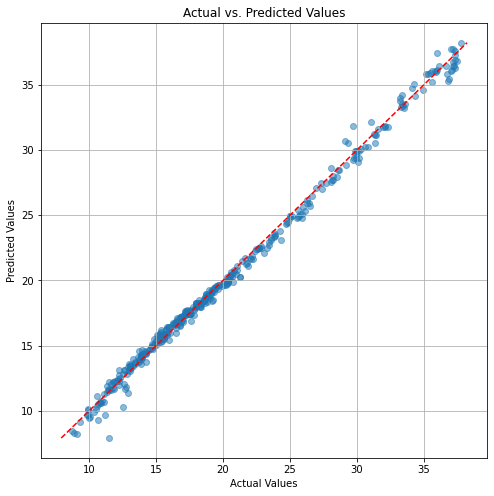

In [10]:
predicted_values = predictions_list[0]
actual_values = labels_validation
# Scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(actual_values, predicted_values, alpha=0.5)
plt.title("Actual vs. Predicted Values")
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")

min_val = min(np.min(actual_values), np.min(predicted_values))
max_val = max(np.max(actual_values), np.max(predicted_values))
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--')

plt.grid(True)
plt.show()

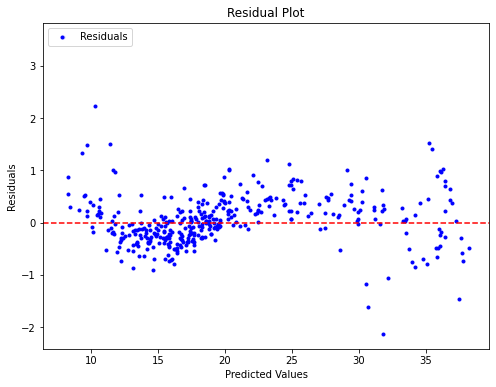

In [11]:
residuals = actual_values - predicted_values

plt.figure(figsize=(8, 6))
plt.scatter(predicted_values, residuals, color='blue', marker='.', label='Residuals')
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.legend(loc='upper left')
plt.show()

In [12]:
residuals[1,0]

0.14824789007552397

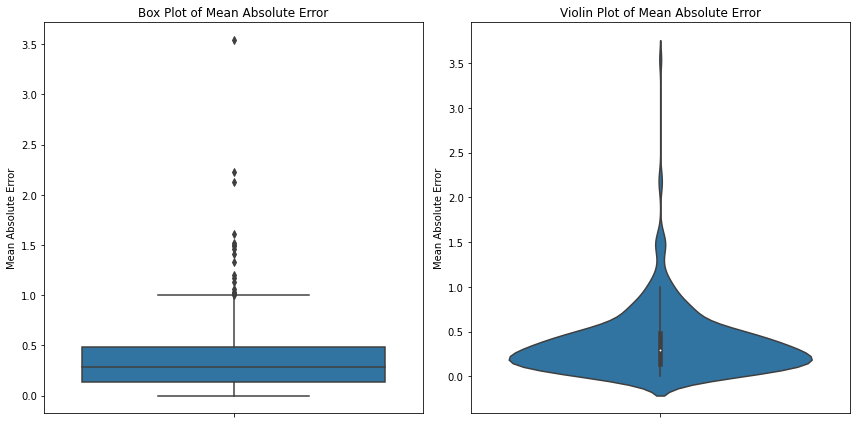

In [13]:
num_samples = len(predicted_values)

mae_values = [abs(residuals[i,0]) for i in range(num_samples)]


mae_df = pd.DataFrame(mae_values, columns=['MAE'])

plt.figure(figsize=(12, 6))

# Box plot
plt.subplot(1, 2, 1)  
sns.boxplot(data=mae_df, y='MAE')
plt.title('Box Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

# Violin plot
plt.subplot(1, 2, 2)  
sns.violinplot(data=mae_df, y='MAE')
plt.title('Violin Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

plt.tight_layout()
plt.show()

## Ridge Regression

Ridge regression - L2 norm <br>
makes the weights close to zero
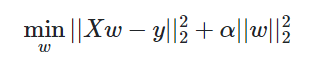

In [14]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge

X_train, X_test, y_train, y_test = features_train,features_validation,labels_train,labels_validation

ridge = Ridge()

param_grid = {'alpha': np.logspace(-20, 20, 500)} 

grid_search = GridSearchCV(estimator=ridge, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)

In [15]:
grid_search

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': array([1.00000000e-20, 1.20270833e-20, 1.44650734e-20, 1.73972643e-20,
       2.09238348e-20, 2.51652705e-20, 3.02664806e-20, 3.64017485e-20,
       4.37806863e-20, 5.26553963e-20, 6.33290840e-20, 7.61664172e-20,
       9.16059848e-20, 1.10175281e-19, 1.32508729e-19, 1.59369353e-19,
       1.91674849e-19, 2.30528939e-19, 2.77259076e-19, 3....
       1.43321923e+18, 1.72374471e+18, 2.07316213e+18, 2.49340937e+18,
       2.99884423e+18, 3.60673495e+18, 4.33785019e+18, 5.21716858e+18,
       6.27473213e+18, 7.54667263e+18, 9.07644607e+18, 1.09163173e+19,
       1.31291459e+19, 1.57905331e+19, 1.89914058e+19, 2.28411221e+19,
       2.74712079e+19, 3.30398507e+19, 3.97373038e+19, 4.77923865e+19,
       5.74803016e+19, 6.91320378e+19, 8.31456781e+19, 1.00000000e+20])},
             scoring='neg_mean_squared_error')

In [16]:
param_grid['alpha']

array([1.00000000e-20, 1.20270833e-20, 1.44650734e-20, 1.73972643e-20,
       2.09238348e-20, 2.51652705e-20, 3.02664806e-20, 3.64017485e-20,
       4.37806863e-20, 5.26553963e-20, 6.33290840e-20, 7.61664172e-20,
       9.16059848e-20, 1.10175281e-19, 1.32508729e-19, 1.59369353e-19,
       1.91674849e-19, 2.30528939e-19, 2.77259076e-19, 3.33461802e-19,
       4.01057288e-19, 4.82354943e-19, 5.80132310e-19, 6.97729965e-19,
       8.39165644e-19, 1.00927151e-18, 1.21385926e-18, 1.45991865e-18,
       1.75585633e-18, 2.11178304e-18, 2.53985907e-18, 3.05470967e-18,
       3.67392478e-18, 4.41865996e-18, 5.31435916e-18, 6.39162405e-18,
       7.68725952e-18, 9.24553110e-18, 1.11196773e-17, 1.33737286e-17,
       1.60846948e-17, 1.93451965e-17, 2.32666291e-17, 2.79829688e-17,
       3.36553498e-17, 4.04775697e-17, 4.86827104e-17, 5.85511016e-17,
       7.04198979e-17, 8.46945981e-17, 1.01862899e-16, 1.22511358e-16,
       1.47345431e-16, 1.77213578e-16, 2.13136247e-16, 2.56340741e-16,
      

In [17]:
training_start = time.time()
grid_search.fit(X_train, y_train)
training_end = time.time()

best_params = grid_search.best_params_
print("Best parameters: ", best_params)

best_ridge = grid_search.best_estimator_ # returns the best model with the best hyper-parameters

testing_start = time.time()
y_pred = best_ridge.predict(X_test)
testing_end = time.time()

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error: ", mse)
r2 = r2_score(y_test, y_pred)
print("R^2 value: ", r2)

print("Time taken for training including hyper-parameter tuning: {:.2f} seconds".format(training_end - training_start))
print("Time taken for testing: {:.2f} seconds".format(testing_end - testing_start))

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=4.91994e-33): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=4.88219e-33): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=4.97129e-33): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=4.9095e-33): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=5.12719e-33): result may not be accurate.

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.37833e-31): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.3612e-31): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.42156e-31): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.64061e-31): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.62803e-31): result may not be accurate.

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.27711e-30): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.78209e-30): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.75307e-30): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.82156e-30): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.77406e-30): result may not be accurate

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=8.7003e-29): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=9.08607e-29): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.04862e-28): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.04057e-28): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.05956e-28): result may not be accurate.

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.93773e-27): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.90122e-27): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.02986e-27): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.49674e-27): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.46991e-27): result may not be accurate

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=9.62065e-26): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=9.79621e-26): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=9.67445e-26): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.01034e-25): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=1.16603e-25): result may not be accurate

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.68803e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.66741e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.71609e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.68233e-24): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.80127e-24): result may not be accurate

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.437e-23): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.76676e-23): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=8.96357e-23): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=8.8948e-23): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=9.05711e-23): result may not be accurate.
 

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.47996e-21): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.58992e-21): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.98901e-21): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.96608e-21): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=3.0202e-21): result may not be accurate.

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=6.8759e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.18078e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=8.2873e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=8.22371e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=8.37378e-20): result may not be accurate.


C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.2801e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.32171e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.29285e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.39452e-18): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.7635e-18): result may not be accurate.


C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.60326e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.74201e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.64578e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=7.9848e-17): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=9.21521e-17): result may not be accurate.

Best parameters:  {'alpha': 6.69346971295864e-08}
Mean Squared Error:  0.26372156413282877
R^2 value:  0.9952185870076297
Time taken for training including hyper-parameter tuning: 4.83 seconds
Time taken for testing: 0.00 seconds


C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_ridge.py:147: LinAlgWarning: Ill-conditioned matrix (rcond=2.65607e-20): result may not be accurate.
  return linalg.solve(A, Xy, sym_pos=True,


In [18]:
best_ridge

Ridge(alpha=6.69346971295864e-08)

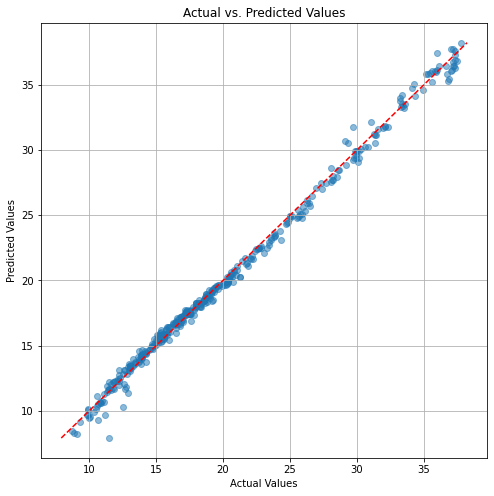

In [19]:
predicted_values = y_pred
actual_values = y_test
# Scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(actual_values, predicted_values, alpha=0.5)
plt.title("Actual vs. Predicted Values")
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")

min_val = min(np.min(actual_values), np.min(predicted_values))
max_val = max(np.max(actual_values), np.max(predicted_values))
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--')

plt.grid(True)
plt.show()

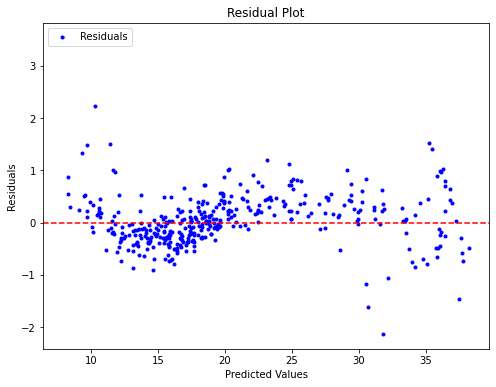

In [20]:
residuals = actual_values - predicted_values

plt.figure(figsize=(8, 6))
plt.scatter(predicted_values, residuals, color='blue', marker='.', label='Residuals')
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.legend(loc='upper left')
plt.show()

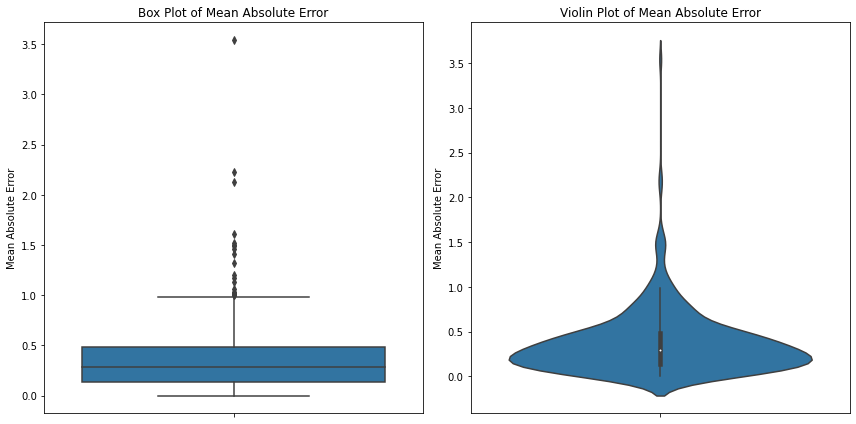

In [21]:
num_samples = len(predicted_values)

mae_values = [abs(residuals[i,0]) for i in range(num_samples)]


mae_df = pd.DataFrame(mae_values, columns=['MAE'])

plt.figure(figsize=(12, 6))

# Box plot
plt.subplot(1, 2, 1)  
sns.boxplot(data=mae_df, y='MAE')
plt.title('Box Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

# Violin plot
plt.subplot(1, 2, 2)  
sns.violinplot(data=mae_df, y='MAE')
plt.title('Violin Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

plt.tight_layout()
plt.show()

In [22]:
residuals.shape

(392, 1)

## LASSO Regression

LASSO - L1 norm <br>
Makes the weights sparse

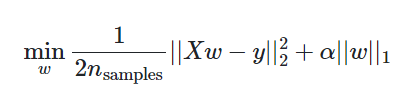

In [23]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso

X_train, X_test, y_train, y_test = features_train,features_validation,labels_train,labels_validation

lasso = Lasso()

param_grid = {'alpha': np.logspace(-20, 20, 500)} 

grid_search = GridSearchCV(estimator=lasso, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)

In [24]:
training_start = time.time()
grid_search.fit(X_train, y_train)
training_end = time.time()

best_params = grid_search.best_params_
print("Best parameters: ", best_params)

best_lasso = grid_search.best_estimator_ # returns the best model with the best hyper-parameters


testing_start = time.time()
y_pred = best_lasso.predict(X_test)
testing_end = time.time()

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error: ", mse)
r2 = r2_score(y_test, y_pred)
print("R^2 value: ", r2)

print("Time taken for training and hyper-parameter tuning: {:.2f} seconds".format(training_end - training_start))
print("Time taken for testing: {:.2f} seconds".format(testing_end - testing_start))

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929207657, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741758, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372126686, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212674, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420184, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372126794, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084202025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463141, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477417865, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372127, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920766266, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741815, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212736, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741951, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372128704, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084203974, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372132524, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420795, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463707, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214421, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084220436, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464874, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084258, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058468414, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292082484, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584791257, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920944766, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477606637, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372612163, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508471561, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058511523, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292212964, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478857465, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137359611, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924893667, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860481775726, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376574024, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509604352, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105957872, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293325983, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910618396364, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295858099, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860517341516, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171474649636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941519267815, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791068682615, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693208791483, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186078150412, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131716824273, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186139778052, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317231129728, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416077909075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317421466516, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99418091803255, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913418075004, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69700906536, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186890848645, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13179975485946, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188599525647, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13197411427035, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99442635576287, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3193771057476, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1325018355851, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99498472146985, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32094231702206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13409903241114, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99667466784774, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3850891542504, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7036301485002, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32567939011386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1498792582663, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01337137584596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.397213300783, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1866765911135, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.05230667554207, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4338932150562, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8511773084132, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.48146558678144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.29790376598584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.81005470364966, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6332153224548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5248876383784, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.62880920069836, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.09210958268505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.79256375855823, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.83881975341967, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.92313911768275, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.0762099622878, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.31518687888894, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.53052282447294, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5570115224568, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.3436947994194, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1170735447676, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.68650698023333, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4780454927466, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.92069754282727, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.926115774738, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6433648963431, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1786164816221, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.44726784485823, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7344978714286, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2027490093857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.6054998216923, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.67999919808403, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.7058824888037, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.17858695084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.49190040122477, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.01600490202355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.1167082154666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.80281206721247, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.27461300833204, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.3719486586085, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 446.2449234736613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 435.6816323643152, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 430.49208310705137, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 581.1034246710889, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 572.9259822332933, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.2976186797289, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 833.5973794715286, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 855.4171036029172, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 928.6200815306831, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1034.162489666941, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1151.6986485415898, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1163.6947292410864, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.29538376228766, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 724.1137657582974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 231.86905886664795, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1127.1139173241602, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1222.9867259696066, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1209.9709865061257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1431.9731615347705, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1388.733655631709, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1507.7876657195798, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2203.5920725196347, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2186.197425718872, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2079.895152201231, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1715.668763283133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1926.4802832883624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1720.8308220815466, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.528642736406255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.772311029977573, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(


Best parameters:  {'alpha': 1.2027083347685145e-20}
Mean Squared Error:  0.26626597693738874
R^2 value:  0.9951724554427662
Time taken for training and hyper-parameter tuning: 84.25 seconds
Time taken for testing: 0.00 seconds


C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.93587550019686, tolerance: 18.480465414243948
  model = cd_fast.enet_coordinate_descent(


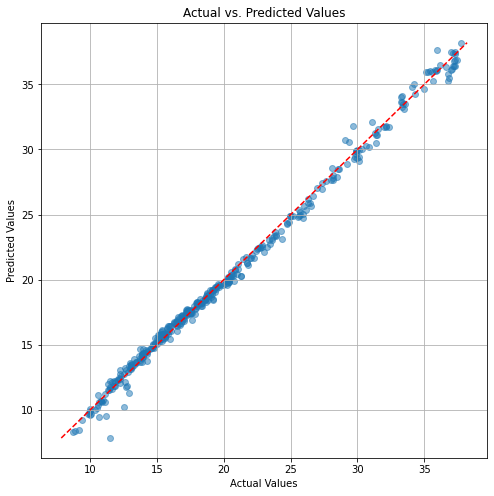

In [25]:
predicted_values = y_pred
actual_values = y_test
# Scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(actual_values, predicted_values, alpha=0.5)
plt.title("Actual vs. Predicted Values")
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")

min_val = min(np.min(actual_values), np.min(predicted_values))
max_val = max(np.max(actual_values), np.max(predicted_values))
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--')

plt.grid(True)
plt.show()

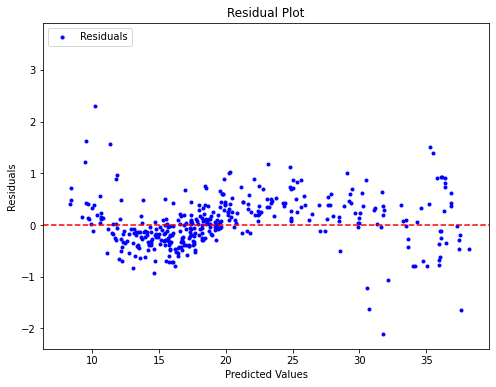

In [26]:
residuals = actual_values.squeeze() - predicted_values

plt.figure(figsize=(8, 6))
plt.scatter(predicted_values, residuals, color='blue', marker='.', label='Residuals')
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.legend(loc='upper left')
plt.show()

In [27]:
residuals.shape

(392,)

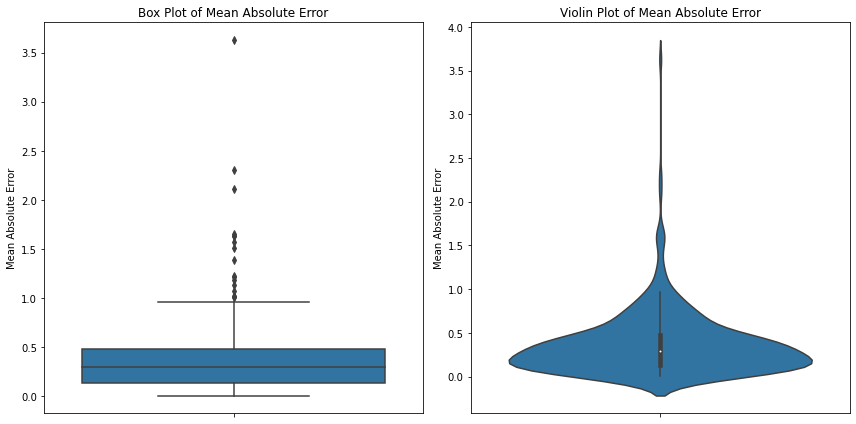

In [28]:
num_samples = len(predicted_values)

mae_values = [abs(residuals[i]) for i in range(num_samples)]


mae_df = pd.DataFrame(mae_values, columns=['MAE'])

plt.figure(figsize=(12, 6))

# Box plot
plt.subplot(1, 2, 1)  
sns.boxplot(data=mae_df, y='MAE')
plt.title('Box Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

# Violin plot
plt.subplot(1, 2, 2)  
sns.violinplot(data=mae_df, y='MAE')
plt.title('Violin Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

plt.tight_layout()
plt.show()

## Elastic-Net 

Elastic-Net <br>
Combines L1 and L2 norms
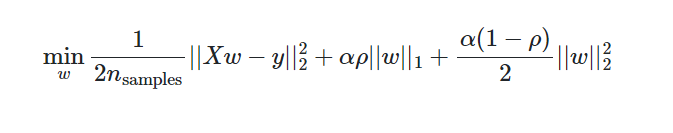

In [29]:
from sklearn.linear_model import ElasticNet


X_train, X_test, y_train, y_test = features_train,features_validation,labels_train,labels_validation

elastic_net = ElasticNet()

param_grid = {
    'alpha': np.logspace(-20, 20, 500),
    'l1_ratio': np.linspace(0, 1, 100)  # l1_ratio = 0 means L2 penalty, 1 means L1
}

grid_search = GridSearchCV(estimator=elastic_net, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)

training_start = time.time()
grid_search.fit(X_train, y_train)
training_end = time.time()

best_params = grid_search.best_params_
print("Best parameters: ", best_params)

best_elastic_net = grid_search.best_estimator_


testing_start = time.time()
y_pred = best_elastic_net.predict(X_test)
testing_end = time.time()

mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error: ", mse)
r2 = r2_score(y_test, y_pred)
print("R^2 value: ", r2)

print("Time taken for training and hyper-parameter tuning: {:.2f} seconds".format(training_end - training_start))
print("Time taken for testing: {:.2f} seconds".format(testing_end - testing_start))

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077489, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742792, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372137526, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477427335, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213686, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742661, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372136173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084212546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421179, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464018, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920772695, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477425386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213488, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084210415, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077211, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477424243, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372133644, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420969, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084208925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463765, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372132405, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420827, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463695, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131745, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084207476, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584636285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084206737, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463562, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920769296, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477421026, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084206026, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920768216, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742042, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584633863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920767744, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477419906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584633147, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076714, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372127954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084203196, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920766056, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741812, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477429956, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372139686, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084216474, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464362, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920776106, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477429245, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077543, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742846, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213817, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372137253, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421372, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372136605, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421289, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464113, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077338, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742621, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213578, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742549, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372134974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372134195, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421027, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463874, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420931, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463798, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077132, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084208505, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584637183, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929207706, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584636376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077004, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477422396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076922, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742155, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213092, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584634847, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076864, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742021, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212945, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420499, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212877, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420412, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584633244, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420317, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463255, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076657, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084202343, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463173, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929207659, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477432207, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214194, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421902, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477431314, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372141056, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084217935, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372140147, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421693, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464466, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742942, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372139226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421497, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464298, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920775503, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084213865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584642, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920774736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084212853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584641065, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920773855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464012, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920773105, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477425886, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213458, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421069, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463917, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084209693, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584638325, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077155, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584637285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920770643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742311, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420761, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463633, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084206527, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584635375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920769074, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477420486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212992, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084205435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584633715, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920767574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741964, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920766715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774188, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212809, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741789, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372127107, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084202326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372144905, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422235, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464947, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372143813, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422097, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846484, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214263, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421974, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464724, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477431707, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214144, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372140323, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421719, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584644936, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920776356, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742951, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213928, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421482, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584642833, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920775435, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477427523, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213714, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421356, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584640883, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920773593, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477426386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213509, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421122, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463966, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920771877, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477424453, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372133894, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084208897, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463757, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920770876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584636455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920769916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742234, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372130756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584635324, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420509, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584634164, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076798, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463302, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076707, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741909, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212727, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084202593, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372148804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422664, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584653326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920783507, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743741, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214739, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084223864, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584650854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078236, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743497, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214494, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422234, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464841, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078009, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743372, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372142506, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421959, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584646994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421799, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464567, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077778, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742998, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372139743, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464315, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077561, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742868, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077445, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477427375, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213692, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742608, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213565, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084211853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463906, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920772127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477424806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372133127, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084209113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584637655, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076995, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742235, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131774, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742105, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213043, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084204765, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584633846, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920767653, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584632493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920766505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477418405, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372153806, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423229, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465845, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920787503, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744196, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215222, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422901, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846554, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078617, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465369, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078472, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743883, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465205, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078337, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477437294, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920781876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477435697, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372145644, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477434043, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422129, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214237, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084219413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464686, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077768, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477430996, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372140727, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477429353, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213909, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084215724, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372137435, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464198, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421203, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584640326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920773184, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742472, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213416, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084210193, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463733, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920770655, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477423163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920769194, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372130836, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084205003, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584634074, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076778, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477418627, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721279, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420318, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058466397, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079338, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477448475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079165, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744651, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721571, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477444627, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215507, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084233704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215305, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084231424, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744089, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422924, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743898, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372149105, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422698, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465203, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078323, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372145536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084222954, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464995, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078012, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743369, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077842, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743179, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721416, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084216696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584644544, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920776697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464252, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077492, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213596, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084212234, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742452, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742264, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213207, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084205964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584634955, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920768483, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477419195, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372128414, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420379, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584631277, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920799355, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745509, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372163947, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584668435, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216165, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084241, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584666093, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058466377, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079152, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477446435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372156876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078949, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477444144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372152044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423035, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372149645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084227655, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584654287, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078337, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214736, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477435055, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214491, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422231, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743275, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372142625, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421968, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774305, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372140295, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421705, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477428205, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084214417, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464044, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077318, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742593, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213351, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420952, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463812, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131154, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420675, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846357, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076735, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741952, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212873, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746269, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372173935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508425478, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217102, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508425153, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584675546, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920801276, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477457286, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216818, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084245703, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846703, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079886, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477452216, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721629, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084242503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058466504, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920794336, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744944, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079183, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744679, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084233414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584659426, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078942, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744178, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372152004, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084230304, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465425, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743899, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721468, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084224296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584651416, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078035, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477434026, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214389, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150842185, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464606, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077798, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477428984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372138703, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421533, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372135787, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421208, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584640366, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463753, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920770666, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742081, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372130074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084205646, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584632255, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076607, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477418047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372181796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508426355, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584686256, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217836, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084259766, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058468282, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929208071, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477463647, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217487, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920804056, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746037, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372171496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745709, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216803, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084248136, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058466974, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920798167, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745373, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920795245, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372161116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929207923, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477447265, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215775, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084233357, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584659306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920789305, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846559, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078631, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744068, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584652445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078343, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743738, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078049, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774341, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372143904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421797, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584645624, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920777476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477428046, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213767, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084214104, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463946, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477424766, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131336, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420703, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463596, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212793, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420322, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584632493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137219289, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427613, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058469728, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920819006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047747701, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137218871, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477472975, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721847, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084266843, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372180506, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508426229, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058468158, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292080823, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372172906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084253707, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058467742, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424901, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584673307, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920801145, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477453864, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372164663, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424442, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744991, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084239814, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477446014, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372156484, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423515, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465743, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078761, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920783973, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477438005, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372148065, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477434145, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372143984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084221295, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721399, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421658, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464444, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920773394, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742621, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477422197, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131626, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420736, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372127516, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420271, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584632107, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920833313, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047749287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372205466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047748816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372200566, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508428465, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058470086, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920824696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477483474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584695857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920820466, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774787, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920816124, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047747396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137218558, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920811946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746917, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372180636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746436, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721757, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084256736, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372170757, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508425118, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058467517, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079922, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745483, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216568, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079492, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745012, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721608, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423542, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584661176, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079059, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846562, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078639, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477440614, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743587, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372145814, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150842186, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584646175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920777834, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920773537, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742636, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084207567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463631, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420198, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463141, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920850486, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058472481, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047750632, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920840237, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047750056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372213515, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920835024, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047749487, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137220742, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477489175, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372201464, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084285704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427899, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058470007, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427231, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584694066, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920818767, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047747201, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372183575, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508426567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372177555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084258936, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058468209, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292080422, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746053, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217162, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424661, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584671073, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079908, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584665195, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920793904, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477449123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058465921, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920788816, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744345, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920783694, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477437664, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372147804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084219794, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464725, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920778516, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477427216, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372136827, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421323, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584636325, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920769234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224543, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084334976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584749835, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084326904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058474262, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292086042, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584735425, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920854214, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047751628, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084799, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047750936, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137222266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047750252, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137221546, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084301387, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584713956, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292083578, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477495604, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292082955, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047748871, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137220111, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047748187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721939, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427715, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584692384, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292081724, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047747504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292081103, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217957, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746129, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372172377, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084253013, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745434, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424493, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372157956, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423689, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058466253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422883, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584655367, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078529, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477433645, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137213642, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084212734, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464097, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920767784, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741999, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372129307, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508435866, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584771026, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920884546, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047754315, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137225796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508434904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058475512, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920870955, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047753488, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292086349, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477526567, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224068, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047751836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372232017, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084319935, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372223337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508431029, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584727797, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372214805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508430058, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058471913, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920833853, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047749348, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137220604, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292082637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047748526, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137219746, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477477017, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721888, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084271465, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372180136, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508426177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058468461, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292080415, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477460407, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217152, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424406, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584668833, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920796643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058466023, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920789197, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744389, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078181, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372145587, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047742734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372136907, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084213337, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212828, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084203576, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463283, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292090723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047757532, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137229149, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084376886, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058478713, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292089822, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477556984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137227246, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084365177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372261996, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084353626, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058476639, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920872944, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477537134, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372251657, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047752715, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224119, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084330263, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372230863, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084318605, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058473524, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084306895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584724784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084467, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047749731, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137221007, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508429527, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058470583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292082825, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047748738, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137219094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058469549, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292081196, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477469104, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372180597, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745916, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217019, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508425065, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744927, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137215977, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084239, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214944, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508422729, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846538, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421561, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584643595, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077465, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584633187, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920765755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477417666, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713723249, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084424015, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584829046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920925064, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047759533, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137231237, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084398277, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058480617, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920914474, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477573343, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137228941, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084384356, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058478333, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920894744, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047756131, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292088394, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047754938, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713722645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292087323, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047753743, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372251975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604775254, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137223939, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508432823, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584733373, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292085179, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047751346, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084099, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477501516, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137221447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084288574, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058470846, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292083026, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047747959, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372191493, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150842745, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058468559, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292081054, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477467643, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058467312, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929207998, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477455615, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292078912, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047744361, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372154005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743169, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372141494, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421844, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137212896, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084204423, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463349, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920970385, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047764559, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137236506, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477631295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137235005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084452176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372334955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508443532, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584839153, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292093167, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047760243, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372319835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047758816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137230491, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084401545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137228978, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084384725, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058479416, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084367865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584779155, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292089074, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477544853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372259785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508435103, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224478, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508433413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058474902, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292085414, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047751615, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137222974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084303206, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058472156, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084122, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604774897, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137220213, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084286386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137218706, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508426956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058469158, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292080463, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477460935, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217197, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477446514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372157, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423581, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372141926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084218896, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846465, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292076586, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741768, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372126925, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292100929, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477688997, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137241029, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477671694, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372392253, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508449955, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584881365, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292097831, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477654425, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713723591, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084462385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058486322, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920949774, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047762271, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372340906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047760537, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372322955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084421906, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105848121, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292091868, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477588054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920903174, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604775707, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372286695, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604775535, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372268727, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508436099, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372250525, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084340757, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058475497, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150843204, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584736807, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920853953, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058471885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292083834, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477498566, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372196314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427983, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584700785, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929208099, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477466796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372178147, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477449493, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216013, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508423937, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372142006, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508421906, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584646625, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508460463, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584989896, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921071146, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584968154, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292105249, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477737075, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137244244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084555824, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058494656, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084531483, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058492477, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292101508, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584903057, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920996374, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047767465, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292097772, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047765385, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137237353, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477632995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372351786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508445419, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584837863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929209403, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047761213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920921636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047759133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372308295, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292090295, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047757054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372286536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508436075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584772715, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920884216, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047753241, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224667, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084336323, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584732896, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920849997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047751151, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372206733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508429159, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584711113, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508426728, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584689513, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929208127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477452494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372163293, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084242827, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584649705, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920778397, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743172, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929211331, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477826933, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137255438, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604778019, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137252818, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084652003, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372502063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084622626, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058500601, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137247587, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084593295, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584979824, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372449756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508456395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058495379, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929210207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047770164, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137242355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929209982, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477676713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137239744, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920975734, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047765165, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713723712, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047762659, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137234508, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508444666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058482759, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920930726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047760156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372297086, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084392905, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584801375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292088962, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047755561, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137227089, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047753058, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224478, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084334237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058472742, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929208446, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047750558, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137219679, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508428049, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058470129, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084251115, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584675166, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920799685, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584648904, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292077718, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477430405, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372641057, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084778536, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058514477, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292118051, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477879786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137260955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084713866, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058508714, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921153546, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508467851, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058505575, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921126455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047779439, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372520384, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084643294, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137248897, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508460797, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058499293, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508457272, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584961566, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292104534, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058493009, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921018367, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047769906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920991343, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477668965, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137238928, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084466943, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584867336, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292096423, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047761373, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372331607, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508443161, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584809714, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292091474, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047758356, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372273956, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084366944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058477828, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084331633, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058474686, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292086065, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058471538, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292083359, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047749323, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920806494, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746323, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372174315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920779477, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477433037, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372142875, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047800371, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372738947, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508488828, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585211074, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921259133, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477967496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921226755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477931235, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713726633, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921194195, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047789501, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372625413, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084725666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058509777, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292116166, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477828553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372556116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508468327, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137251817, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084640805, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058502216, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921069503, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477756123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372480383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047771997, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137244256, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508455591, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477683716, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372404685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084513487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137236685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508447109, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058487107, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929209395, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477611224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137232909, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477574975, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137229116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508438625, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584764046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920874473, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477538777, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084193, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477502494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137221549, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047746628, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137217761, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508425894, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584650626, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920776913, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477430155, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372863115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085027454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585366484, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137281765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084976454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585321055, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292132015, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478035344, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713727721, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929212811, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047799171, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137272649, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477948237, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137268107, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508482335, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137263559, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508477232, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058513919, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137258996, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508472128, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058509376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508467023, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585048405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292111812, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047777389, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372498977, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508461921, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058496511, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921046453, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047773043, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137241555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508452566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584919683, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084474634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105848742, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292096825, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584828717, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292092907, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047759957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584783316, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920889946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477556023, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137223338, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084321566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584737807, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920818363, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047747619, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137218792, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214247, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084219436, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105855155, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921518765, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478256624, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713729576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085133387, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058546078, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292143257, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604781605, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137290289, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478108143, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137284808, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508501061, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058530597, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292133848, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478055734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929212915, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047800342, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137273867, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508483676, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058519668, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292124443, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477907253, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372638305, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084775353, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137258355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084714, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585087343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137252885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508465265, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585032654, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292106409, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047774999, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137247408, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084540163, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105849325, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292101714, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047765394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137237377, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508447878, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058483232, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292093086, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047760165, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372273325, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084366285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058477773, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047750554, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372218613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047745316, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137216389, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508424348, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058571666, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292169032, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478447743, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292163372, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478384755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373137027, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478321687, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137307117, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508526071, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058551938, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292152064, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478258653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372950535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150851255, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585453693, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292141695, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478143153, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137288466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604780801, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372818874, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084977767, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137275295, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084904007, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105852565, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137268714, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508483014, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058519075, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292119051, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477891024, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372621224, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477827934, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372555485, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084682494, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058500455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921077535, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477764957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921020885, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477701963, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137242383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292096442, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477638907, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372357965, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929209078, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477575924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372292163, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047751285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137222622, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508431341, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058467586, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292079459, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477449817, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292186643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478643887, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137340785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508556414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585844344, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921798344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478504956, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373262605, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085475346, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058569949, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929216736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047842919, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292160557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478353366, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137310429, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508522385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058554132, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292153756, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478214304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372959096, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508513502, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585396423, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292141288, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604781386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292134477, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478062725, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137280073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047798702, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372721564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508486868, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058515921, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292120877, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047791116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372576403, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508470599, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058508017, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047777226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137249724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477696443, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372418003, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508452842, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584856354, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292094789, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477620586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058477719, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292087994, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477544797, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372193625, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508427684, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846981, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922116775, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047892288, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137369917, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604788318, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373604007, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085858095, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058602691, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292195319, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478740487, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373429407, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150856624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585931746, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373334205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508555554, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585836727, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508544878, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585741605, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921707656, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478391155, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137314373, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508534198, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137304835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085235233, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585551566, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292147575, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478208785, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372953315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085039533, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058537719, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921394073, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604780416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137277864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084932707, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047795044, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372683365, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508482594, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477859266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372588187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508471912, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372492934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084612355, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058499695, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920998585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477676923, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713723976, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920916697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047758584, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137230245, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084309874, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058472748, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920834916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463241, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292239064, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047922802, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137392255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086215214, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058642414, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292221021, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047902707, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137380805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508597972, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058621446, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922111875, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058610012, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922013485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047880775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373483505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085722944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585985753, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292183294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478606717, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373368937, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047849698, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373254363, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508546615, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105856617, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292163618, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047838745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292153783, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047827779, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137302532, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478168124, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137291078, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508508084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047805852, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137279624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508495235, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477948834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137268168, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508482399, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058509, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292114413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477839217, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372471703, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084588605, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584975606, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084460156, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058486129, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692920947284, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477528534, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137224262, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084331696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047741895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713721281, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084203275, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058681046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922621465, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479485107, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137417181, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086494605, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586672984, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508634016, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586535344, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922384746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586397857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922266375, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479089534, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922148045, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478957685, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137373562, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478825814, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373597834, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508585101, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373459994, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085696614, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058596241, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921792887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047856203, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373322336, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478430133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373184525, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508538772, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047829832, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373046754, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508523332, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372908977, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508507882, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058541224, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292131945, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478034486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137277115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150847957, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058516008, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929212012, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477792833, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137251871, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508464121, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137238089, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084486776, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584885066, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508433229, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058474748, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292084608, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048003643, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137486252, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508726904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058722459, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922973917, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047987777, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374558686, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086928394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058705922, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137439305, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086742715, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058689368, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292257058, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479428457, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374227386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479269875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137406171, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508637109, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479111214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137389602, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086185326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373730285, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508599956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586232164, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292200115, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047879403, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137356472, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508565901, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585928927, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921858876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047850321, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137326089, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150854733, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137309512, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085287575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058559806, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372929514, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508510179, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585432724, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084916006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585267264, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921289385, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477868867, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137259814, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508473024, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713724324, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508454454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058493647, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292088605, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477551623, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137226674, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480567326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375417045, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508789058, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048037652, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137521772, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087667285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048018579, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713750185, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087443816, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137481926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508722049, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058731925, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922907996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604798043, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137461988, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929227367, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047961351, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137442063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086587413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058675563, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922565486, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058655672, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292239428, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047923206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137385609, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086140624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058635772, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137365685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150859172, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058615876, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921909154, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478691567, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373457595, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047850078, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137325824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085470395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585595216, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292156676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047831002, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921395574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047811932, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137285971, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477928444, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372660446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084800177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713724612, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508457667, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058496516, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137226188, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508435326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058476619, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292413159, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048116757, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137604405, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048093815, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375804404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415088324974, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105881035, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292371973, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480708633, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292351377, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048047929, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375325106, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048024973, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137508542, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508751877, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374845746, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087250117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910587345857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922895985, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047979106, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137460605, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086757466, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058690709, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922690126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047937047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137416674, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508648879, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058646847, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929223126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047914104, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373727306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508599619, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586229225, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292193513, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047872034, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373487654, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478490836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373248014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085458816, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373008265, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085190077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058551143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292131739, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047803211, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372768613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047780276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137252898, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508465268, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058483347, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292090557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477573224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376886254, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150895377, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058938279, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508921455, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910589094946, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924566186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910588807307, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924318554, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860481375793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924070847, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048109989, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137597337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508824506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058823167, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692923823214, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480594037, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375444966, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508792194, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910587704175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292336912, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480318153, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374916544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087329385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058741633, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150870062, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910587128647, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292287384, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586840815, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922626206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479490376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922378607, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047921441, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137400369, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508603674, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586265286, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292213087, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478708467, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373475274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508571367, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137318707, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508539038, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585689775, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292142917, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478156653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137289866, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508479789, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058516224, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292118154, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477650696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372370266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150844747, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048289726, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137785095, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415090619374, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590057487, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692925386175, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048256544, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292508833, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048223351, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137715758, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415089518067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058936534, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292479049, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048162509, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376522087, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508912942, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058873076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292424442, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860481293177, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929239465, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048096139, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137582872, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048062947, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375482, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508796333, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058769249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292335081, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048029767, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692923053, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047996585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374788567, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086862166, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058700038, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922755127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586654266, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292245724, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479301986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292215942, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478970214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137374857, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478638333, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137340195, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085631307, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713730552, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508524257, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058555825, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372708547, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084853933, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058521216, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137236189, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084465244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058486603, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292662139, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048394157, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137894187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860483542334, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137852496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509137487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590671856, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929259049, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048314324, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171377760517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415090517795, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590255586, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137734348, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509005039, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910589839277, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292488988, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048201231, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376926505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048161319, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376509615, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508911542, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058865986, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292417343, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860481214073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137574512, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508825833, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910588243676, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292351664, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480482317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137532825, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048008316, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374911246, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508732347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047968404, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374494306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086855976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586647996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922441897, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047928489, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373729864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085998874, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058623174, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292178513, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047855313, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137331291, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508514196, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058546865, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921426906, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604778214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713725485, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508467451, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372131535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084206964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105846361, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415093016347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105924804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292744932, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509245402, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059197972, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292701844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048398373, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137898607, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509189183, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713784846, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509132961, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590978476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692925797705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048302374, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171377983156, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150902988, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105900606, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292536682, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058956002, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924935936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860482063723, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376562303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415089174386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058905937, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292414605, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048118359, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137606078, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048070357, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137555935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508804986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137505782, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087487773, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058755749, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922853494, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604797435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374556345, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479263474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713740549, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508636332, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047878329, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137355341, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085801, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373051864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508523878, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058555495, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292113005, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047782332, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372550505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508420795, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058463707, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292932232, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059407148, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292880419, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860486373387, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292828596, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860485795977, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171380879106, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692927767704, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048521861, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138027607, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860484641294, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171379672883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509266172, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137906969, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509198555, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910591562684, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137846662, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415091309334, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590960496, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692925695006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604829092, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713778635, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048233185, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137726032, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415089956904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058925448, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292465865, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860481754507, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376154594, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508871727, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058865233, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692923708544, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048069608, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375551394, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604801187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137494827, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087364895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137434523, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086688674, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586846056, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150860125, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105862439, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292206761, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478386665, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373138954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085336244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372535805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508466004, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058503971, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293095298, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048876738, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138398325, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509681642, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105958643, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692930329757, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910595140175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292970658, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048737863, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171381927947, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509518983, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059441594, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292856398, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860486105603, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171381202517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415093698934, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910593088316, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692927940696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910592364113, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929273174, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860484716856, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292669425, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048402248, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137902632, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048332808, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713783009, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509112349, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059019169, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292544777, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048263374, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910589467486, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924824454, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048193933, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376245646, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508881924, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910588743273, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375520244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415088006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058801909, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692923058653, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047997191, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374794894, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415086515097, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586691515, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292243542, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058596738, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921812157, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047858304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372739583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508488847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585243156, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151003516, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910599012315, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293301804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509937355, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059814137, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293226845, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059727035, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692931518904, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048939779, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138391471, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509741723, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059639942, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692930144686, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860487866714, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171383042226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415095624045, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059480264, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692929395103, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059393167, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292864557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860486196433, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292789603, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860485361307, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138042498, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292714642, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860484526163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137955252, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048369103, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137868005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509154848, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137780766, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509057036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059030268, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929248976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048202073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137693521, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860481185504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137606281, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508861413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137519038, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415087636027, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058768979, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692922648903, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479515325, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171374317926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047868014, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373445505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508567971, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477844987, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372573015, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150847016, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860493667796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138910232, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510323321, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060070535, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293444993, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049266332, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713871787, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510107643, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910599657846, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692932797165, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860490821896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138612934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150989197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059773743, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293189557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059668984, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692930994086, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048881295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059564237, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293009262, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860487808535, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059459476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692929191115, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860486804226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138105779, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509421411, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910593547304, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692927538347, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604849627, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138000842, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150920574, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910591626877, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692926636753, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048312121, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171378084763, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509088097, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058970637, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292498404, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860482116747, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137616105, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508872428, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910588658866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508754781, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058761144, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692923181026, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910586563794, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292227941, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479103426, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292137783, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047809912, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372838383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860497163257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139275365, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151073268, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910604173715, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692937404574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049595515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171390440135, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415104732833, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060291374, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415103317915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910601653914, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293523611, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049253238, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171387916094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510190309, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138665413, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415100488267, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910599134256, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415099073343, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059787436, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692931983246, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860488908217, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138413009, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509765855, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048770017, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138286812, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509624362, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059430478, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692928911127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604864922, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171380554456, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509364975, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910593044893, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171379292504, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509223491, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910591785027, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137803055, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415090820054, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059052519, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929247548, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048186129, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171376768577, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508822611, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910588215436, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292367049, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047964655, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137445492, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508681122, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058590569, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292168274, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478438534, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058464582, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294229879, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050140792, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294099486, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860499955013, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139567014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049850215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171394152306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415108894664, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060535714, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692938386623, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049704919, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139136969, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151057749, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910603841925, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293599591, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049438544, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171389851954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049293261, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171388334194, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415102371586, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171386816254, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510066995, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910599296094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293208367, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860490026787, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171385298523, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509755023, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105965182, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692930779644, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860487363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171382515856, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509584849, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910593740287, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692928388855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048591016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692927084844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860484457104, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137948024, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415091027106, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590709754, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292578077, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048179351, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137669768, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508932535, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379105879318, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292339, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480340595, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292208594, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478887637, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373661953, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047743473, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137214421, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415084220436, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061350696, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294535684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050481484, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294378834, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050306733, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713989213, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511253567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910609862155, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294221999, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060803976, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692940651623, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049957253, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692939083143, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860497825, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139344496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049607764, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171391619454, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510605472, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049433015, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138979404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510400808, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171387968583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510196152, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060044642, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692932809545, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860490835203, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171386143125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048908784, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171384317576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509786821, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910595282943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292967279, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604873404, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292810431, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048559299, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138066661, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860483845486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137884114, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509172847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048209806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137701577, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508968184, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860480350645, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137519028, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508763528, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373364804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508558862, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585867235, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512443288, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791062045624, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692951284674, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860509667894, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140581651, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512197135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061643784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692947826553, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050756625, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140179136, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511745865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910614246005, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511499713, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061205419, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692944053793, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151125357, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910609862365, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294216751, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910607670625, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294028118, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860499159575, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139300941, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510761273, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379106054788, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692936822975, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860495306586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139081399, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049320493, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171388618343, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510268982, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138642284, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510022831, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910598903386, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692931163934, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048900152, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171384227365, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509571563, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059488506, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292927764, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860485148496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171380202266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509325408, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910590866625, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292581938, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860483046796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292393306, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604809452, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171375811277, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047884348, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171373615734, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994150858697, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186051873297, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141528623, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941513258796, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171412645676, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512962752, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910625082134, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415126667077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910622445946, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295293377, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512370667, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910619809884, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692950665166, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512074624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379106171737, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294839641, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061453765, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692946127736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860505673296, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139944295, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511482539, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910611901583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139680244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415111864914, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910609265384, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692939699746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049851151, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713941619, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860495983744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171391521274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510594406, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138888067, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415102983636, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910601357027, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415100023094, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910598720885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692932515534, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059608486, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692930246885, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048797949, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171380959017, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509410225, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910593448703, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292608757, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604833454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171378318503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292381887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604808177, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137567798, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415085714355, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910585979824, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292155011, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860526601304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142350576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514180278, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063328181, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969296218312, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052356123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295945456, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860520521093, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171417154115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415131714596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791062694081, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295672599, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186051494765, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141133184, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415128154067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791062112827, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295172354, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860511907587, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692948994947, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050886754, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140498015, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294626641, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860505827467, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140180431, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860502787407, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139862855, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415113911834, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910608446384, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692940809307, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049974734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910605275886, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293808067, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860496707213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929353521, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860493667165, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171389101154, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049062708, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171385925267, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415099669676, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059576448, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292989494, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860487587034, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171380102955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509314201, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910592594034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692924892576, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860482013616, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137692709, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047897349, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713737513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508602099, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186053657125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317143392072, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415153479015, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317143010113, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415149196665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910642508075, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969296729718, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860529258614, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131714262816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052560228, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171422462005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514063205, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141864242, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941513634978, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063106865, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941513206746, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910627255457, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295690507, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860514633286, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141100328, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415127785153, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791062026467, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929508887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860510977043, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692947606995, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050732066, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171403364083, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050366437, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171399544524, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511493832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605000081, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139572487, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511065608, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060501203, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929377619, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049635177, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138872241, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510280515, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060119893, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293174548, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860489648585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171384902677, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048599215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138108314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415094240527, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860482335793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137726362, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508995821, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791058658178, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921900406, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047867953, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692983965393, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186054782929, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317144568128, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860543431793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171441087445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516151327, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064965414, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692976071696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605390343, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941515207093, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064506795, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969297212476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186053097218, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171428071536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514692059, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142347767, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415141770226, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910635895736, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692960941745, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052217726, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171418883763, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295699491, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860517779734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141428993, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295304797, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186051338235, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140969613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050898478, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140510229, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512116885, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140050848, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511601848, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061296513, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511086806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060837907, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294054947, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860495792324, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139132071, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415105717765, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049139482, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138672692, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415100567427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910595385085, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692929366533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860486997414, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692925419537, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048259991, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137753922, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692921472586, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047820241, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171372945374, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186056122084, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317145967052, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415182346894, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317145414548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415176152553, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791066651197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131714486204, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516995821, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910660996243, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171443095337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516376371, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791065548039, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692976997464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186054006525, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171437570327, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860534776354, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171432045186, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415151375, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052948748, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171426520165, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151451807, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052419857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142099517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941513898631, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791062882097, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692958009506, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860518909707, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141086582, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415127629953, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379106233052, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294930675, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860509213425, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140534082, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511627361, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061319292, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294455974, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511007923, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910607677156, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692939812825, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049422824, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713896865, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510388487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059756495, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692931109915, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860488939327, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171379557195, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509252853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059204921, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292240715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860479243045, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137403218, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941520472503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791069195494, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301218455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860573967776, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171472986386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941519727495, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379106797929, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693001717746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186056760673, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171460803727, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941518361663, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910673159, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415176166735, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910666525164, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969299029929, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860549583905, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317144751369, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415168716575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860543222984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317144086875, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516126656, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860536861933, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171434223636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415153816585, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142757866, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514636651, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063998979, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171420933656, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941513891649, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063335598, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692956995317, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860517779006, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171414288615, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415125258133, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910621193913, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295128608, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050611721, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171402106065, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415117808155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791060903185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929408192, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604997562, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910602398057, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929351099, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860493395175, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131713832785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415096699715, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910595764185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292464294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048173335, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137663345, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186060246484, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171502755534, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941523064942, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791070839131, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969302613838, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186059481441, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791070041265, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693019271733, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186058716392, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301240526, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860579513454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171478779253, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941519630197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791068445552, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693005538636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605654878, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317146412729, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941518734173, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910669828096, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692992950047, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186055783731, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969298608347, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860550186934, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171448143225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516195454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910653870904, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692979216836, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064589232, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692972350344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860534886056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692965483847, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860527235597, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142416714, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415135073923, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910629935203, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295861726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791062195661, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295175064, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186051193481, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415117153575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910613977965, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692944884144, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860497909, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139353103, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510819329, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059935065, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293229549, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049025866, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692925428944, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860482608215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137754699, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693055756716, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186062781287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131715292351, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860618611665, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171519622927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415249559036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791072388257, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696930392398, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860609410387, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969303098134, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186060020922, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317150039874, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941521902564, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379107046908, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693022722873, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860583340296, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131714827766, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941520824912, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791068709828, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693007582424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860574139074, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969299932389, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860564937824, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317146355247, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415177715696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791066790636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969299106547, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860548068954, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317144593026, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516693912, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131714363182, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415156162627, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910648714563, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514538613, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910639118587, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692966290154, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860520465244, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141709409, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941513460964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171407481906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512383309, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910619926816, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511305667, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910610331, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692941514757, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318604928616, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171388257797, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151022801, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059273841, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292637425, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048366041, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317156300887, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941529819945, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910775192114, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693074843445, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860649077254, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317155144841, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186063801087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171539887867, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415272277463, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910742492306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969305497839, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860626944444, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171518693537, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415248515663, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910730951256, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317150713299, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415235554704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379107194102, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693026836194, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860595589757, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317149557244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186058452335, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317148401197, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941520963269, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910686710467, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969300697127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605734569, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171462817564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415185870845, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910675169377, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692988761676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186055316857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317145125708, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860542102186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171439696487, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941515994886, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860531035824, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142813607, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514698785, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379106309286, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692958964083, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860519969354, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294903151, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186050890302, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171405014947, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415110265045, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910607846436, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293909899, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860488614745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171383820634, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415097304, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860477548275, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137226008, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508434303, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171590115684, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415328588293, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910802253197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415312999986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910788372676, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969309413028, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186065947312, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317156230783, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415297411696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791076292502, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969307222949, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186064616355, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317153681724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941526883322, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379107490444, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693050328664, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186062176243, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317152291328, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860608452905, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171509009334, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994152376565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791070971621, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969302643676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186059514326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791069583559, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301449092, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860581833587, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969300254495, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860568523945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131714672975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969299059913, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186055521438, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317145339347, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186054190463, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317143948959, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941515971513, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064031343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692966707197, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860528594996, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171413999055, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415131136544, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910626432824, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415115548265, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379106125523, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692942815385, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049088436, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171386191124, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509995988, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137228719, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508437168, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910584791257, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969314603481, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186072839255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171634303916, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415362504004, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910832455077, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693131667384, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910815760864, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693117299926, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860696377265, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910799066583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969310293253, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186068036963, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791078237233, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969308856507, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860664362097, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693074197625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186064835449, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171550691817, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860632346826, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171533969535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415265638436, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317151724715, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941524689025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791072950722, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969303109519, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186060033168, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317150052474, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186058432395, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317148380231, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941520939394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171467079906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151906457, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791067942445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692987992846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186055230883, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317145035748, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415156273983, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910648818274, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692973625365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910632123976, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295925789, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052029363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969294489046, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860504285964, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171400190316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510002953, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059873544, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293052297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791091615499, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693203218696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860792102265, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317168409728, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415433950554, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791089607661, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693171538995, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860756805986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317166398516, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186073755351, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171643872965, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941538885335, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186071830102, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317162376086, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994153663048, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910819109726, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693119699383, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186069904854, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171586888575, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994153249657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910799031386, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693088019665, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186066375232, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317156677637, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415283626576, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791076222116, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969307073979, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379107421428, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693053459946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860625247316, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910722064487, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693036180075, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860605994865, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301890027, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186058674239, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317148632763, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186056748984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317146621554, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941518967415, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791066182948, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696929843405, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860548237427, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969296706067, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186052898494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142599124, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605097324, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317140587906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512202837, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049047989, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317138576688, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415099479745, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186085589141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171767493805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415527447013, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379109592091, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693239691645, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860832736317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969321890901, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860809581127, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317171911575, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415450608745, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791091091241, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693198126356, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186076713009, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317167476917, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415423489404, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317165058006, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415396369915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791086261569, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969313924223, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860720819896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171626391005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969311845962, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186069766475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317160220199, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415319531687, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791079419534, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693097677015, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791077004697, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969307689436, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186065135447, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969305611183, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186062819936, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317152963473, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941523817361, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910721750177, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969303532913, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791069760185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301454654, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860581889134, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317146109909, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941518393493, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791067345352, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941515681545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064930515, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969297298123, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186051628285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141272091, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941512969611, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049312784, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171388531924, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510257675, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911064182657, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969332933596, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186093261121, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171823394384, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941559011586, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791103513921, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317179430207, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415557499134, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911006095743, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941552488244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910977052326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693254349727, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941549226577, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791094800885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693229354186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860798008415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171707024975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415459649055, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317167793248, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941542703235, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910889922, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131716488401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941539441565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910860878543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415361799066, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910831835063, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693129372547, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791080279172, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969310437703, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186068197146, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969307938169, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318606541226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171556714167, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941526394897, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791074470487, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693054386244, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941523133211, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791071566135, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969302939079, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860575217513, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171474285764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415198715457, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791066241501, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692983565903, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860547368615, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295857043, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186051951976, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317141610098, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510630145, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910604328175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692933574925, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861024882653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171944028215, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415725359165, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318609913887, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317190903855, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415686130743, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317187404891, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941564690237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911085708265, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693321970027, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860924400536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317183905922, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186089090651, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171804069606, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941556844562, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791098673769, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693261845566, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186085741248, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693231783236, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860823918413, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317173409025, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860790424366, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317169910063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941545076056, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791088194543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969317165885, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860756930234, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317163495292, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941537884176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791084701452, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696931165448, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186069552458, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317159996315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860662030437, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317156497366, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415300385164, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171529983975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941526115665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791074222226, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941522192839, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910707291473, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696930213478, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910672360624, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969299128552, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860555965903, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142501492, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941514347156, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063742988, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293617149, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860494560254, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171390025155, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941585532698, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791127130384, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696935057396, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791122929234, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693469583643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186108886095, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171975792704, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415760966406, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791118728072, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969340329743, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186101500771, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171933710333, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186097472414, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317189162793, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941566660582, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317184954565, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415619425594, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791106124615, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693294829125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860894156955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317180746326, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860853873405, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317176538094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415525065007, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171723298603, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941547788466, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791093521144, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171681216215, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415430704425, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791089319997, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317163913383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941538352413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791085118843, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941533634381, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791080917687, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696931080227, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910767165357, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693071866675, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860645741557, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969303571066, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860605457973, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317150587302, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186056517443, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317146379073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415186939564, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064113065, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692963398376, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860524890857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692927242306, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048460725, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137962596, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186124510513, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172174079904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415983268364, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911343127894, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693566338435, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186119665576, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693522853197, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186114820639, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317207285431, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861099756924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172022241565, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941581303607, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317197162874, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415756291927, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911183123697, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941569954782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911132596145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693385150043, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186095440875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317187040329, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415642803666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171819790415, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941558605957, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791103154084, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693261941893, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860857510065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317176917758, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860809060663, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317171856483, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415472571326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860760611306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317166795202, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941541582717, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186071216186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131716173392, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415359083065, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186066371252, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171566726413, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415302338895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910736796397, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969304451579, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860615263054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693001030566, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860566813657, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171465500864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415141563844, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063574095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692957545317, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186047798975, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137271063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941508481977, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791154752297, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969374078467, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186139101003, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911486753075, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693688484693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186133273962, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172214897673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416029023376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791142598315, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969359260131, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861225910353, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172154025335, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941590390449, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791131457138, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693540301364, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791125380141, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693488001275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186110936945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791119303145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693435701294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861051098934, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969338340128, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860992828445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171910535516, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969333110115, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860934557915, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317184966319, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860876287516, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317178879072, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415551296977, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171727918274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415483050313, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910939823104, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415414803747, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910879053055, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693165484443, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186070147599, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171606173455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941534655705, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910767641415, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693069600953, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186064320553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693017300887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860584935, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317148442844, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860526664497, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142355606, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994151418171, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186163460481, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172580965613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416439428427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317250775385, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941635734772, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791171834627, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317243454217, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416275266964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911645257765, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941619318624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911572169236, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969376023886, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186135427528, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317228811864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941611110549, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172214906837, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941602902465, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911425991996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415946943935, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379113529035, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969357153379, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861144028056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317206848338, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415864863096, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791121890773, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969345621408, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318610739457, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317193426172, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415714381746, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791114581915, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317186104996, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941563230099, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379110727306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969327799261, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860875378953, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317178783815, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186080529654, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317171462638, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415468139256, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910865646256, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969315218926, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860735214065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693089287466, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186066513167, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171568202796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186059504925, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317149499107, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994152218969, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791064638034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692963484084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605249669, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969415736394, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186185512802, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172811331805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861770839356, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172723279445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941659897165, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317263522705, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416500252437, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791184560469, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969393040693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861602262046, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317254717472, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861517973425, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317245912231, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941630281406, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911596542807, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693779102136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186143368485, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693703449855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186134939612, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317228301757, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186126510755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172194965176, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994160066564, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861180818845, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317210691279, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941590793716, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317201886035, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415809217925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791123027517, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941571049872, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911142370933, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969338823158, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318609279527, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171842755463, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415611779506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317175470306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415513060217, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910966562436, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171666650686, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415414341, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791087865816, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941531562165, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791079075389, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693085622083, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860590798016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171490545733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415216902486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171402493424, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415118183197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910614945326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941698518157, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791227741959, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969436253872, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186199923508, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172961868827, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416866451185, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791208359387, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694195728044, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186189786048, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694104740273, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186179648581, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172750066167, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861695111166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172644164854, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416510259954, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172538263495, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416391529587, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791174880403, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969383177717, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861492361827, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172432362217, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861390987206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131723264609, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941615406867, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911449255176, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693649801746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186128961251, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911343531994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693558813987, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861188237787, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969346782621, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861086863125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317200875675, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941569893538, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911132085645, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693376838535, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911026362485, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693285850735, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186088411365, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969319486297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186078273897, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317169105271, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318606813643, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131715851513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941532295557, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791070919287, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301288746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860579989564, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317139099872, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941510528302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910603469595, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417346726005, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912599369326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969463655936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186228739925, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317326289446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941720392801, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791236625368, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969443593471, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862165475167, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696943265031, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186204355108, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317300815787, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416799333744, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791211194556, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969421707146, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186182002347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317277464913, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941665653563, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317264728068, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416513737657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911857637374, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693907015034, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318615761753, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172519912314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861454251106, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317239254386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416228141496, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317226517544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941608534353, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911476175105, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415942545437, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791134902094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969356048135, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186108847853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317201043848, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941579974722, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317188307004, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941565694925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911094712723, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969325042485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186084463022, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171755701563, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186072270599, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317162833317, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941537135299, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910734442556, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969303156132, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186060078178, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292212964, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860478857465, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317137359611, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969498436471, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862776496547, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317377382434, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941763361389, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791285484395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969485275046, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912701914837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969472113618, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186248321847, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969458952185, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186233657935, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131733142636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994171183809, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912396056436, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694457907593, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186206774094, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131730334208, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941694663657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791211568619, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969421661452, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186192110178, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694085000276, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186177446262, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172727046765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861627823486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172573859697, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941643140351, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791165689837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969382177147, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861481184245, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693690157027, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861334545016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172267485504, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415944794333, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791135103978, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693558542633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186106570653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317198664256, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941577304979, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317183345544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415601305293, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379110451811, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317168026824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941542956079, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791089225168, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969305402051, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860625788687, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317152708116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941511469584, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791061188113, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969292240599, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913498963616, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695402673005, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31863242538503, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695244379466, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186306617455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317407642887, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417943842195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791313110542, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695086085943, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912947176306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969492779243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318627134466, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791276324712, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694769498716, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862537082515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969461120528, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186236071852, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173339472115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969445291153, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318621843544, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317315523284, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941691105073, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379122114594, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969429461785, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186186102019, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172817460753, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416704492313, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317263322156, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941649793393, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791184360085, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693846118963, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186150829187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172448982175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941611924349, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791150639706, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969368782523, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186118495754, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172111209985, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941591268498, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131719269705, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415706126376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911138538294, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969323932622, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860832229034, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317174273115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415327435804, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379108013343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693081032426, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860508894465, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171404958814, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415120877177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317488312949, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419020372693, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791408972249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695747125036, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31863626289004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317466154371, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941856491922, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913684165244, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695556744136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186323741266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174255302863, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941831649006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913278607954, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969520771238, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31863025298236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173849061997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941786103637, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791305739485, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417612607107, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912836181675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969482695035, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862424307224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317340589001, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941736417764, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173184303884, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941711574826, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912393755363, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696942875373, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186200007816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172962717914, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941666029429, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791198819758, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969409715614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791176698439, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693906774955, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861575848836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969371639374, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186136373419, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172297959323, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693526012554, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186115161949, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317207637306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969333563126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860939504753, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317185478678, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969314525002, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860727390006, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171633200477, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941516971656, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791066091731, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969295486862, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864562220676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317563925521, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419868064024, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379146228628, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696358212883, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318643071091, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969612924033, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864051997565, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13175106249116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186379688597, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174839746034, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941897170094, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186354177428, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174573242907, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99418672913197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913558644095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695442322245, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186328666255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317408465373, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994181251354, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791329258929, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417826347377, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913026534443, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694984376684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912760479634, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694755403816, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862521327133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694526430936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862266215285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173240726417, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694297458, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862011103317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172974223033, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861755991207, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317270771945, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416581396775, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317244121593, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416282608615, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911651916914, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969361053886, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861245767135, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172174712395, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186099065496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171908208653, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941568503188, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860735542745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171641705, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941538624349, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791063203855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692923619436, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048043051, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317645081518, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942077789859, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37915654768466, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69697009113156, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186503228076, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13176130290054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186472545605, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13175809764783, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99420059190226, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791474814172, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969645833883, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186441863141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696182951606, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864111806567, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317516871401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186380498163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317484818852, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941898112693, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913788183295, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969563217693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186349815679, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696953567895, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186319133183, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317420713732, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862884506734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317388661167, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417903062863, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791282822426, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969480601452, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186257768163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969453062691, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186227085639, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173245560057, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941688489058, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912188251215, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694255239204, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861708343376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131726579291, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416525535486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172337403097, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941616618035, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791154827777, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693474973815, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318610946924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172016877, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941550736233, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791096163525, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693199585896, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186053217884, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317142924552, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415148006926, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13177480305404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99421932055867, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791668252529, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69697837853533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865955587637, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317709480736, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942113969291, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791597696806, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969750664336, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37915592118475, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969717543311, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186521754693, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696844222864, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186484852637, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317593831266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419843097945, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37914822419026, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696513012343, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864171988417, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13175231565435, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419410899446, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174846066715, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99418978700794, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37914052719145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969557458235, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31863433946705, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317446056799, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941818633629, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791334716046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969524337163, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862757408186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317375381997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417754137323, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912641601577, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969463615162, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186238838682, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969430494069, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186201936561, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317298282179, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186165034412, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172597322466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416457539587, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317221182306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941602534005, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791142290792, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969331130693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860912301187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317182632346, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860543279424, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317144082396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415160940754, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317871848083, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99423320169154, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379179186161, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99422800361583, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791745575488, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696987681943, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791699289356, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969836984537, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186654826157, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69697971496373, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186610443801, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13177250282877, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865660614176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13176786641134, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942115430296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37915604308694, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969717479791, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186521679026, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317593663078, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99420201320817, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37915141446683, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317547298862, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941968151215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37914678584707, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941916170329, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37914215722384, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695979749116, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186351546383, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174545703555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941864189427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174082060885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941812208507, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913289997437, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694851091003, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862627814456, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173618418097, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941716910117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912441415847, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694452740845, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911978552745, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696940543904, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186174016449, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969365604003, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861296339224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172227488735, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186085251375, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131717638452, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415523036475, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13180579393, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942540644714, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37919776395285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69700352760844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186875748327, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318002176851, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31868223693726, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317946414376, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99424156094597, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791819911702, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969939456677, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186768990394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317844183111, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942300993726, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37917642430114, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69698516221575, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31866711288933, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317788420575, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31866177498523, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13177326580177, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942175958276, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865643708034, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13176768954327, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942113440517, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37915508461674, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969707892793, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865109917237, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696599829626, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186457612623, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13175653701916, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696120731203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318640423351, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317509607557, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99418737888567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913838397117, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969564163265, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913281708677, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695162533844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862974752056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317351613255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941748753067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791272501969, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694284185584, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186199613352, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172958505123, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941634136832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911704422885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693805086206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861017514353, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317193618779, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415716188497, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171378559844, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941509100851, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791059104376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131818868929, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99426872257567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792108169324, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318121623388, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99426120353684, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379204121627, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318054557443, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942536844953, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379197426317, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970022667789, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31868616936214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317987491478, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99423989957455, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37918515157463, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969965046399, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31867439948473, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13178645371073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942323805213, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37917287682217, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969859407089, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31866797954706, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317741582641, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99421859558225, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791661814976, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969753767701, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865620965414, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317674516517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186497897073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317607450372, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99420355745156, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13175403841757, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941960383818, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37914609550654, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941885193077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791394001696, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969571299445, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941810002304, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791327048295, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969513677826, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862410989135, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317339185424, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941734811492, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791204300306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969408038136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186176899295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172162304835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941596961565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791137346804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693023983535, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186059199917, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171491641083, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970390219171, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31872711953014, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13184152748266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69703209176447, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187193982482, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318334614226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187116769599, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13182539535813, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942760386384, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792106219421, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69701823144567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187039556688, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37920256944153, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69701130128095, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31869623437257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697004371113, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186885130717, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131801197137, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31868079176735, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131793131054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942398657807, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317850649668, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942308225528, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791770698257, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13177699887365, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99422177931916, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791690173049, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69697665039814, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865762782553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317689327764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864990650354, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13176086667625, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942036928386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791462018059, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696279001715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864218517626, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969558598207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186344638447, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174473445787, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318626742509, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173666834194, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417656307367, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317286022213, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941675198094, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912070208597, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693506920794, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31861129982394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172053609543, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31875811077066, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318739021186, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943304204028, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131864201024, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994319544101, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37925607270313, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970501688104, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31873953790364, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13185449992267, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99429960419326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37923831726846, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697041833865, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379228632477, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970334989129, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187209650108, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13182701343044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942778515381, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37921894767896, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970182181537, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187039398369, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13181731230316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31869465336837, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318076111682, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99425609885117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186853668954, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317979100275, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942452224965, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379181822557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969932132343, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186760804144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317801245833, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994225282493, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791721377255, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969779324249, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31865905518384, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317704234223, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969695974302, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864976868525, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13176072225644, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419446607305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791446973362, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969612624291, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913501248124, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695292742256, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186311956686, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791253276186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969445924104, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31862190915126, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172353438506, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416183685645, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911564274816, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293115399, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186048838519, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171383318513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187798857967, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13189664892093, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943559213596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187687169459, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318849813508, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994342840361, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13187331377145, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943297593515, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792651700821, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69705631026136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318746379219, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318616461828, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31873521034066, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318499785834, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943035972983, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131838310975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942905162552, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37923022617923, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69702623672407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187128725574, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318266433558, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318701703652, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318149757276, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99426435413625, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186905347372, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13180330808996, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99425127305966, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13179164044226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99423819197204, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37918363417316, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969861385581, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186681968801, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131779972784, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942142099502, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791622794519, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969761139967, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864772047874, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317585820525, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994201128831, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791409246985, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695773561097, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31863655151915, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317371912882, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417714675013, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912927663746, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416406560067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791176285666, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969376864317, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910598048546, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971282914455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31882657612306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13193372958636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99439749231965, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37932548420724, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971061878816, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31880194927083, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13191969693986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943686492346, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792998009604, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697094131375, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37928579189867, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970820748575, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187750835599, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792717828212, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69707001832734, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187616506847, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318659049954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99432145134284, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792577737306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943057186799, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792437646261, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69704590522997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792297555076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970338486641, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187213519804, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69702179208633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31870791905226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318214680148, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186944861098, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13180743525476, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942558984752, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791877280674, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969976788946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31868105315493, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969856222799, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186676201855, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13177936969214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99421132236716, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379159709703, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69697356565524, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186429930421, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317536428749, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419558959136, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913402615453, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695146180976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186295600357, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317279160112, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416674612917, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912001692644, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969293579242, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186049328232, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171388315675, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31885807368695, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131978326681, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99444748991016, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13196144955225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944285682579, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379353157486, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944096465829, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379336308732, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971251457775, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793194599569, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69711064533755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188069137996, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13191081804314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994371803163, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37930261116185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970840611535, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31877729482903, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318939408327, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943371132805, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379271721653, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69706956066545, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187476757931, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13186299922575, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99431819149345, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187315199278, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318461219569, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99429926968213, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131829244668, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99428034784916, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792211750353, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970139752993, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186992081401, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13181236735767, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31868305221656, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317954900278, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942425041117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13177861267593, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942235822085, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37917062823675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969704735313, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186507403123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317617353041, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186345843312, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174485791217, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99418573833174, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912288942636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694147226585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318618428331, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69721718276713, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31892561114347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320488789216, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189061806048, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13202858075914, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945038293611, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37940328899236, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69718230340334, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31888675003626, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13199136738433, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944621078965, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37938302492483, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69715033056417, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188511272563, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319710691381, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31883169660955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13195077086095, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99441659344365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13193047255453, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943938361666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793222325465, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994371078857, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379301968362, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69709510455357, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31877340450103, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13188987585346, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99434832151195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318695774589, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943255641347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792614399058, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970456915954, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187345429552, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318492790337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942838421888, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792242887171, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69702825167997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186989197724, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318120651773, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99426108471613, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791871374311, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969962784365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186794889065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37916687305164, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969788384493, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31866005801214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791466086424, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69696139844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864062708945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13173425406524, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99417384742566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912634420525, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69692942501996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860500366025, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13171395544094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189711722417, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13209647331024, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99457994352974, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3794676442741, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69723710317777, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189478030459, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132051716681, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99452976501067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3794432726192, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971986493413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189049594142, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320273039133, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944795863288, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37939859114204, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971776744697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37937421936743, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69715669956275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188582207507, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69713572461893, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318834851358, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319540653518, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31881148192525, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13192965241103, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943929136761, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793011037898, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970937746234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187881124522, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13188489524333, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943427345489, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37927673184663, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970553203337, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31874526831325, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131860482183, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31872189872547, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318360690773, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99428799349687, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31869852909676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318116559303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994260622898, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791833056702, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969923948706, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186751594277, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317668983811, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99421044334, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791589335221, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.696953940261, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186323149299, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13174248511234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941602636201, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911425113913, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969329649677, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31905481168445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321838461003, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99467789719404, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37955075320184, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69730792402225, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.319026705527, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321300172514, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99461754743487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3795214413784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13210065597247, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945846292851, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379492129493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972364489996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318947071094, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132071294632, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189189647116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13204193322775, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945187927734, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188908582698, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13201257176183, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944858744125, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188627517702, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319832102343, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944529559817, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793504545182, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971355423714, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188346452119, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971103155833, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31880653859514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13192448699283, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187784319192, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318951252789, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943542002672, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37926251760837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69705986185056, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187503251857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69703463490634, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187222183929, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318364016643, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186941115415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318070397638, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942554439197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37917458014664, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69698418086074, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186660046316, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131753209451, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941950925078, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37914526753747, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416217345635, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911595486645, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693372660527, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31914603621004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1322791423815, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947847334774, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1322438296979, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947451429646, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796350622668, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69735435169815, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3190784295468, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13220851692654, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31904462608713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321732040637, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99466596163296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3795351774854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972936717645, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31901082254404, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321084635819, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99459337839005, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37949992386376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697238048226, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31894884916187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13207315046446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189150453779, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320378372567, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945141962793, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188812415095, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13200252395933, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99447460507224, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793647841602, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971470273424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31884743755666, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13193778268044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944020209279, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793295301102, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970914031334, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187854634237, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13190246912984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99432943644206, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37926489745644, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970610625492, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318723489005, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13183772738284, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99428984476106, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318024135763, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942502529776, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791943887673, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969750971498, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318655880223, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317670996796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941776677782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37912975549125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69694475627506, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9949290971717, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37979886840344, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69751959106685, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31922864845166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1323654414813, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9948814817651, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3797211367327, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6974526933845, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31918799319357, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13228757860634, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99479418647024, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796787374584, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69738579533407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31911345823175, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13224510776433, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31907280262624, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1322026367905, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9946989546777, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13216016568646, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99465133855904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37955153886793, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972763250047, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189914910458, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13211769445354, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31895083507203, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132075223091, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99455610588393, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318910178975, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320327515962, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945084893262, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793890056592, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971668536904, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188695227559, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319548868536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99442119192037, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37934660538156, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970999540686, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318794986036, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131912414992, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187543294694, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13186994299986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99432595782326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187136727806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318274708772, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994278340555, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37918406979963, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969904811674, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186730159695, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791416689041, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695398998243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31863235903546, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6976465775221, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31940400525167, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1325486259615, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3193551094529, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1324975468705, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9950295843144, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3798458579454, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69755880556244, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3193062134774, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6975149193457, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31925731732355, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132395388123, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31920842099396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132344308467, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9948577824018, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796928768204, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69742714643576, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3191595244858, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1322506619422, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99475279140245, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796418827411, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69734668737846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31906988042874, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13219958175347, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31902098341794, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13214850137507, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9946382549507, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320974208115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945809864065, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37948889939435, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320463400568, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945237176486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3794379045734, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944664486791, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793869095686, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697163823909, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793359143787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69711993626726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188172439704, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13189309666654, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99435191010116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792849190038, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318420151603, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942946404931, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37923392344373, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969955870893, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31867869938685, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.131790933466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941896456606, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791404311009, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69695169884125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31956601028475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13271786197856, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99527658113584, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3800571891578, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6977392078963, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3195072035838, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1326052354795, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99515031092557, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37999585972204, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99508143583057, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37993453001855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69763364455355, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3798732000474, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6975808625393, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3193307819449, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6975280802966, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3192719742198, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13241069664514, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31921316623783, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1323492627617, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99486332933236, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796892085269, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69742251512156, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31915435799965, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132236633268, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947370557391, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796278774839, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321751986134, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9946681787987, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37956654617375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69727296289204, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31898773326435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321137636868, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945419036081, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37945410474146, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972201793139, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188799161636, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13200113228044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.994473025795, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793416624105, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6971234088238, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31882110647206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970706245971, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187622965246, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13187826061187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187034863192, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318168243711, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942663905128, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864467585945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13175538785555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99419751146945, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3803237864866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69796687479, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3197608525113, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69790339513065, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31969012619294, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13284751645745, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.319619399503, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1327736317081, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99533909781235, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1326997465652, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99525626213654, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3800902116474, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6977129541672, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31947794501264, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13262586102763, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31940721721134, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13255197509693, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9950905894518, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37988122033966, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69758599186963, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3193364890381, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13241651653544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9949387212599, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3798074579598, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69746960859914, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3192068197592, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1323426294885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3191360905353, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1322687420483, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947730451635, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3795984624436, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6973426437632, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31906536094147, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13213328071953, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9946211738455, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3795246985776, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69722625816553, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31893568905514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320593921645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188649584096, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13198550321545, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944554943377, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319116138728, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99437265391657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793034046556, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942898130506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792296392397, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69702522587806, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186527642492, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317638340064, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99420697174, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3805706602439, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6981772077918, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3199951871567, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13309214490835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9956961851349, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38048194992217, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99559656022853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3803932390388, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69802451483895, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38030452759585, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6979481676454, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3197400004463, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1328255623453, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9953973084876, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38021581559263, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13273670035255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99529768165155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3801271030279, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697731847993, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3194989863415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1326478377899, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99511503077986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37996446187253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6976554989631, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31934303374464, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1324849216114, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9950154021211, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3798018188322, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6975155244974, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31925796793047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1323220035192, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99483274790737, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3797131036541, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947331174251, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796243879143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6973628232436, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31901694521366, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321442725088, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99463348629786, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37946174093554, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697222845412, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318931877343, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319813504162, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9944508275616, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3793730236076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9943511946117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37928430571935, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970701404875, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31869084879946, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318036150386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99425156101836, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791216548019, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6969301592897, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318605778873, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38079644474334, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6983689587072, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32020881652215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.133300298991, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9959295420737, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3806897537453, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69820061992203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32002126068215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1331934275195, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.319918956398, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1330865552236, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99568990520237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13297968210446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99557008536993, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38036967588994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6979251514303, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3197143455011, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1328728081619, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31961203888767, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1327659333966, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9953304429119, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3800673734366, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6977415023057, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31950973149986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6976496767046, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31940742333586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13255218139255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31930511439487, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13244530415477, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9949709722454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13233842609355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9948511468283, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37972949828895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6973741957437, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31910049418644, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132231547209, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9946314644781, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37953388264583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69728236737154, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3794271820548, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69719053830687, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188958708736, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970987085486, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.318793558053, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319109056109, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970068780982, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186912444566, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318040234313, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3206364765462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13383610731205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99653024278575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3811177325731, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6986423823804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32051343984716, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69853195105264, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32039040202585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1335790454319, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6984215187232, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3202673630808, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13345051270414, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32014432301486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13332197878515, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99595383241194, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13319344367534, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99580972645276, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38058307768705, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99566561914656, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3804547574858, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6980718097356, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38032643611143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6979613732311, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31975468873276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1328078311948, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99537740049465, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38019811356446, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69775890370454, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3195291058459, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13267929132, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69764846436084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31940605904504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13255075025256, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9949690815179, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37983452664656, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69753802401465, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3191804703283, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1323150885335, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9948249663582, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1321865440896, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99468084985006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3795778713899, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972251042592, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189343692434, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320579984545, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99441663275644, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37934259995, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69711466007254, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37921426841245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69700421488346, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31868826366815, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1342662930847, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99701252243966, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38165412358313, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6989896278068, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32090030939133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13411171321684, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9966947938211, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3813712020132, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69885681479536, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3206290215532, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1338283123175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.996521484543, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3810882747437, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69861332050806, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3204810440694, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69848050338857, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3203330649625, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13351914109245, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9960304310123, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3807796203109, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69834768482053, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.320061765714, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1332357280816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9958571142676, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3804966811208, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69810418034837, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3199137820064, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69797135767203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3197657966758, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1329265436449, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99536603958273, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38018801368435, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6978385335478, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3800336774224, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69770570797454, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31946982114215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1324885205567, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9950193892155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3798793394627, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99484606111014, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3797249998077, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6974400524786, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37957065845694, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69730722255605, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3190258456651, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69717439118403, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188778505923, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1319989489675, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31872985389515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13184434382225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942971759253, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37910762422354, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6995669775841, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.321543547818, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1346287404641, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.997418853915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3820159615414, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99721042294783, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38183036398533, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6992475196497, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3210393163718, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13425691827507, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9970019891628, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3814900954275, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69895467584405, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3208613478322, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6987949398894, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3206833769438, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13388508611513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9964114114748, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3811188839586, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6986352018386, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3203570908827, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1335442312099, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9962029668912, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13335830681996, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9959945194911, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38074766267806, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6981825993083, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3200011334504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1331723799382, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99561235860585, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3804073678824, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.698022853221, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3196748308855, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1328315075122, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99540390322306, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13264557356666, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9951954450229, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.380036127791, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69757022791885, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31931885544714, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13245963712706, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3191408642057, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13227369819424, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947785201697, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37951018752557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697250717572, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3189628706145, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37932455684705, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6970909592527, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187848746757, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37913892371506, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693119883794, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31860687638755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9981230009648, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38264299412845, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6999415245186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38241978406484, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6997494240728, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3217467981631, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38219657045454, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69955732059486, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3215327648536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1345860611883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99737097704923, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3819733532943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6992051230089, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32114036163176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1343624648684, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99691138882645, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3815641126197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69901301093927, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32074794699423, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13395252891723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9966606985684, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3811548600163, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69866079760203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32053389783306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6984686769405, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.320319845277, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1335053122401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9959503873751, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3807083890281, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6982765532457, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38048514821037, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69808442651873, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3198917299719, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13287173058865, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99544897154135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3802619038443, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69773218630917, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31949927900575, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.132648106624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31928521002953, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13242447905174, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9949475394068, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796293588641, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6973479126361, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3190711376559, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69715577125004, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31885706188393, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13197721308927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31864298271506, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317535746987, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941953606377, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38340463500566, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70059055996177, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.322683926492, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70035953110084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32242652431376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1357060409491, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7001284978542, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3221691172234, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1354371410692, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32191170522015, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1351682359747, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9980236433811, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.134899325663, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9977221573596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3822860908182, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69943537179796, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32139686647383, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1346304101362, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99716941768105, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3817939031474, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6992043210069, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38152542987274, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6989732658298, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3208820080752, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69874220626656, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32062457150647, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13382363226447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3203671300242, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13355469587555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99621463884483, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38071997924993, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6982800739799, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32010968362806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1330616322816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9956618451333, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3804514854417, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9953603129405, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38018298650013, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6978179241461, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31938022548485, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13252372472806, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9950587748511, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1322547631263, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99475723086755, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796459732139, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69716318184294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3188652901042, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13198579630955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942043849179, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379153692994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69693208791483, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32351065441577, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1368385597862, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9998962689847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13651517743074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99953371253497, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38389922925194, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70077691823434, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32289152456116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13619178753396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32258194897435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13586839009315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9988085740645, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3829844760495, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70022119864325, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.322272366282, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6999433293318, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3219627764846, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1352215725813, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6996654536767, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32165317958055, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13489815251097, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6993875716766, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3213435755686, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13457472489443, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6991096833314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32103396445007, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13425128973546, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9966933920886, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38137006030195, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6988317886424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32046632560724, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1336583056823, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99633076033575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1333348491451, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99596812005433, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3807242420269, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99560547124725, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3804013217507, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6979980665022, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.319537410517, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1326879134364, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99524281391285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13236443426285, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9948801480506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37975545892016, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945174736611, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3794325163651, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.697164287251, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.379109566383, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70244778118473, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32475308451376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7021136458031, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32438080589, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13774754230576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00055196560396, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3848059785296, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7017795012475, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38441771159194, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7014453475166, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32363621781144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1366456020618, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9996798889278, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38402943391725, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9992438320954, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38364114550524, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7007770125291, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38325284635323, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70044283127186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3225192586073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1354787463385, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99837168143966, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38286453646407, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9979355876154, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38247621583497, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69977444122685, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.382087884467, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6994402324388, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3214022068962, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69910601447407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3210298357665, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13424695875517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99662723214914, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3813111895107, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69877178733054, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3203471286591, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1335337685563, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9961910889941, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3805991813915, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69815901372954, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31997472839885, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13282054167485, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.995391461177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3802107981093, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69754620927705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31929196788496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13243149336824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972119392992, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31891953849237, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1320424341455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941555911831, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911032047265, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70356613728944, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38642808029124, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70316430568016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3255513544139, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1385805748594, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00184920313507, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38596116103366, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1381128562173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0013248262019, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38549422624794, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7020257107244, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32428278326154, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1376451217954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00036342217453, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38463813880674, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70162382824526, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3234618795141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13678756770366, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99983899471385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38378199916286, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7008870092312, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3230140927711, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3833149918989, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7004850891471, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32256629116125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70008315578986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3221184746834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1353841829521, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9978285242213, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38238093076876, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6996812091578, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38191387690114, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69927924925105, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3212227971184, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13405863358133, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99677947904183, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38144680749866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9962549296934, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3809797225599, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69847528961037, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.380512622083, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6980732898745, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31987916924135, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69767127686157, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31943126353775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1325769872555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9946811745957, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3795783745147, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6972692505696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9941565538781, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791112274214, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7049110574725, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3879118931138, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7044278230215, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32695904841347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7039445693796, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3264206293759, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13987838498514, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70346129654513, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32588218883967, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1393159065878, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00214800949607, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38622729499787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7029780045175, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3248949920175, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.138284636919, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00151734701103, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38519771885433, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70209191927916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32435649056254, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7016085728648, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3238179676058, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13715952796696, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70112520725024, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32327942314515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1365969392491, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70064182243914, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3227408571782, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1360343277042, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.998468781347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.382951108805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7001584184271, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32175343037926, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13500281390736, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99783796837494, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3819212923838, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.699272127867, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32121480347405, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38135954250146, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6987886694489, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3206761550567, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3807977701445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6983051918256, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3201374851283, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13284576433256, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9954196129326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38023597531327, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13228300055897, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9947886752307, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3796741580034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415771171846, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791123182181, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7065284074566, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3287598099595, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1423219593039, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0060436526908, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3281123327144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14164557827195, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00528533809796, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3884582964844, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7048818422389, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3274648243786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14040546065957, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0038949978078, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38778298694746, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70381629894547, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32627764500575, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1397289861096, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00250453214005, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38654483508793, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7032350541829, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3250903611103, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13848869702923, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00174604347006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13781212894213, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0009875174916, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3851939994202, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0002289541984, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38451853284573, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7014911533034, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32314730742553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1364588937114, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99947035359014, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1357822265635, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99871171566394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3831675021981, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6998439063181, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32185178276416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1351055263914, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6992624717948, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32120397376474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1344287931911, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3205561336504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13375202695966, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9964355779459, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13307522769765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99567679071936, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3804650508582, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99491796615956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37978935674926, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69742107920416, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3186124265955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13172153006553, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99415910426427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1444713491548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00845330759245, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3918420759207, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.707192152231, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3300387779252, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14365798211526, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0067814619303, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3903533575108, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7064932748102, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3286112071141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1421666852382, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0058694696976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3888644811997, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70521189527136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32783246841836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70451290409767, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3270536847478, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14053963292184, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3262748560977, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13972603514554, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00313316929333, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1389123896199, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0022209612408, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38629241376384, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7024156896344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3247170638462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1380986963388, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3239381002359, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1372849552977, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0003963832305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3231590916316, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1364711664945, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9994840132634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38317822786104, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70031811368557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3223800380297, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13497909628876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99781119478473, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38236571792964, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13416517213363, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9968986718581, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3815531609784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6983367377295, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32017247508696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1333512001986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31939324895404, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1325371804804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99507346401606, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1317231129728, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99416077909075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911520797087, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1470559971528, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01135092118113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39442240892305, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0102543789396, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39344597308275, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70913141900957, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3924694693095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7082910023254, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3312629612338, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7074505275836, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3303265443487, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14395854883253, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00696428416546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3905162579359, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.706609994779, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3286096111356, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14216497285975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00586742986394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1411865608705, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0047704975268, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3885627747462, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70422816979914, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32673634371923, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1402080798206, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0027592522042, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38677184299235, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7033874143633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32501895329347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1384140185043, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0016620987213, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.137435341742, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00056486716824, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3848178386642, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99946755754104, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38384073450885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70086479948094, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3828635623522, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70002381164016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32205203643076, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1344988968938, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.997272704025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3818863221863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6984818496561, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3203340493664, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1335199437323, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3193968732748, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13254092145337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99507753810354, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15114392226303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0159338749346, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3985035243677, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7126139132833, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33607921300194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.149967931609, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33495337086924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14879184115324, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0132968860595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3338274347056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14761565088236, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01197822243296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39400252555845, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.709582179441, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33270140449827, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7085714335746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33157528023816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14526297084643, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33044906191196, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1440864810558, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00802155462134, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39047899762636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7065496898998, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3293227495087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1419293237234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00560309096954, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38930429174013, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7046961297063, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32725759905367, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1407525509483, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0031842479088, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38715040894095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70368497785313, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0018647190181, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38597542448, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.702673741973, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3240653806937, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13741781885204, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0005450772039, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1362406630504, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99922532245137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3836251605162, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69980811723633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32181159507087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13506340729947, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.320684561013, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.133886051584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99658547407716, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3802949463246, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69778491699077, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.319557432775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37911938801886, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7170057736234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3409722502958, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7157908724723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3396186704382, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15366528566904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3382649546359, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1522511569404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.017175054252, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3984323225755, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71336070605275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33691110286736, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39702028229095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71214544074996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.335557115111, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71093005402776, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33420299134895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14800790469593, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3328487315602, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14659319851995, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0108317448619, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1451783479273, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00924550957205, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39254788390906, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00765911105503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3911352514532, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70708052816445, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3287851358241, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1423482134012, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00607254928593, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.140932929426, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0044858242395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3883095599912, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70363518285245, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.326075391488, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1395175009441, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32472031510406, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13810192793386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00131188421244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38430552323666, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70120258694243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3233651025517, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6999861066197, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.322009753807, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1352703482432, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9968143506105, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3814784566916, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.698769504697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99522667260885, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3800647099444, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69755278115235, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40687322773164, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7205845481252, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34495935168934, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1578274571394, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0234265852379, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40517595897177, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0215203451396, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4034784848611, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71766285908524, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.340347599716, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1544266657741, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0196138692139, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3387195457164, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1527259570244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01770715741554, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39866785938386, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7135225977592, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33709129505075, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71206099251583, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3354628476844, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1493239132032, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71059921163584, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33383420358086, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14762257805353, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70913725508814, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.332205362705, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14592103402634, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3305763250204, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.144219281085, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00817005882783, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14251731918836, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0062619308824, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38989129486174, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14081514829996, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00435356676064, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38819197091277, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13911276837985, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0024449664165, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3864924412402, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00053612980736, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3847927058059, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.701581013223, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3224281832287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1357073812927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.998627056888, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13400437404795, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9967177476151, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3813926175013, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1323011576187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9948082019452, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37969226455874, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1644775726583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03088193096556, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.41181507806994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16243357387884, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0285903601895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40977445250456, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72156867652194, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3460555985752, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1603892734398, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34409832938763, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1583446712757, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.02400619588815, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15629976732106, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0217136022091, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4036507941704, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1542545615077, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01942066741117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4016089806312, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0171273914165, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39956686993713, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7142472358264, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39752446202294, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7124894340646, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3359399801446, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1481171322455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01253981553566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39548175682324, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7092661376485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3323487416268, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1460707183269, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00833333792974, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3917360249602, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7075076159457, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3287565462677, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14231817456783, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0060384117474, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32679676354775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1402709042617, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.003743143925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1382233315743, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00144753438434, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38560448871533, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7007642606982, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3228763434805, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1361754564365, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32091570600625, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13412727878125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99685528984895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31895478348906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13207879854264, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9945586547001, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4184362337617, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73042830386476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3559262349043, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4159830782248, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72831696132084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.353573899953, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16619482614146, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03280687676113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.41352949351017, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72444521402207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3492602188088, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1637367593699, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0277542204967, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4090301398253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.722332832066, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0249975276046, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4065753384962, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72022008307664, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3425909031541, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1567698671677, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0222403414373, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40207375352355, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7163457563417, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3402362387975, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1522600105026, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0171842185467, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39961773467604, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7124701950516, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.335918285489, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14979946988535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33356245513176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1473384923209, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.011666555768, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39265667948035, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7082409013093, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3312062130385, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14282556487973, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00660696268125, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39019901195826, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0038464846295, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38774091407464, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7040101368778, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.324527956871, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13790069505046, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00108551228584, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38323328316784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7001306435314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3221701354588, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6980140348976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31981190178396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13297407517393, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36442144562767, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1795741176357, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04780624284007, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.42442961326833, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7355157102755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36159400616816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04173508408525, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4214803906623, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73297739848044, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.038422533854, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4185305476126, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7304385564634, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.35357970282706, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16824880720065, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03510927102985, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16529285444926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.031795295381, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.41262899939943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72324228989845, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.347919675549, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16233627070636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72070141382756, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3450887700594, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1593790557731, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7181600067313, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3422572697526, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15642120944494, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7156180684423, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33942517444285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1534627315196, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3365924839407, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15050362179664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01521471672385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3954019558812, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71053259762556, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33375919805997, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14507694570955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00913069903544, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.392446623734, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7058690477728, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3285632936563, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1421160447912, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32572831984646, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1391545112954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0024908493699, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3840698021707, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70077949948234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3228927499449, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.698233926925, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3200565837489, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13322954576984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3736899175327, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.18925570492206, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.058659910814, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37029159961895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.185705869149, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0546801688226, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4300544947731, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7402716689803, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36689242370966, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.17919547131794, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0473813019753, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4265087866917, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0433986430457, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.42296218161607, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7341674634164, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4194146792068, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73111421049293, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3566897447583, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1685354847072, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03543023396594, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.415866279124, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7255145874774, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3504509676896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16498033148247, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0281222359771, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4093585463766, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7224591602243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3442093004207, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15846017966885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.02413459368773, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40284779319956, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7168555488081, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3408035357361, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1519369577906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0168212349935, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3992951994576, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7112493543882, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33455739784773, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14837754199567, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33114919333286, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14481721179624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.008839065809, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38922463068377, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7051305579298, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32774012707733, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7020700054318, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32433019875066, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1376938067726, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3209194080348, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1341307312425, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9968580579401, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2016017341316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0725005300591, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.44887867535067, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.75331642896873, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.38142557384106, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19733601326345, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37734063130887, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19306897669645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.062934459025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37325444865314, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.18880062382254, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0581491926607, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4325460957034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74231365717554, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36916702530857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4282822904787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7386438509481, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36507836071183, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.17669980373785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04458285412164, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4240171879915, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73191299308485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.35757924993203, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.17242639937484, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3534870653787, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16815167575584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0349994138054, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16387563227164, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0302054567178, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4112140910322, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7208908162124, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3452989654386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.159598268311, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0214126592733, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.403384219146, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7172145357597, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3377888340371, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15175300278094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0166144724332, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3955499753891, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7104718008601, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3336906343544, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7067923696008, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32959118850584, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14318946268423, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70311182532356, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3254904959236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1389057077861, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9982075747578, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3827208639784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69943016752603, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3998485891885, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2165797730133, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.08929165992953, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4595687806422, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7654489174007, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3949421659557, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2071824409499, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0787564025611, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4544503897915, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.75737105272236, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3859424061, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2020539305992, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.06821392447046, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4450618124338, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7529626784342, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3769366226971, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19264672043676, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.06246043577414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4356669392614, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74487650053544, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37202183619047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1832331102609, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0519067837837, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.43053980711295, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7367849366549, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3630067317685, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1780957139386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.35808685712306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.17295641047554, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0403854518341, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16781519880874, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03462155191903, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.41514715025863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0288554944325, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.41001250773456, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7227958972968, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3433164430421, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1575270466121, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.02308727816, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1523801039537, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0173169018913, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3997375811381, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14723124883596, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0115443644107, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39459729499976, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1420804801915, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0057696645051, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3894551255884, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7014131311485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3235973437676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13692779695367, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99517709434554, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3800229202861, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69698441492807, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.47684773632875, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.78017335894907, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4113463169108, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.22345723648186, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0970011234782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.47069916924926, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7704691690889, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4005346918599, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.21729615743266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0843357502079, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.45941977709583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7651727018269, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4532635495082, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.75987392242206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3887302703295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19982484297975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.07050707310555, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4471046147942, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.75015348334654, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3779004445927, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1936532237958, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0578198577934, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.43580619754573, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7448481446497, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36706189792807, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.18233143441864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0508951479907, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.17615200730535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04396732218174, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4234702543439, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03703637826396, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4172982099764, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72891821476384, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34930725548037, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1637848734009, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0301023141329, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1575971629082, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.02316512767885, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40494596675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71385408866877, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3374578153759, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1514066875893, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33152918663126, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14521344558824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.00928137936654, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32559794979886, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1390174350496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0023348132838, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3812403975342, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69788347695567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.31966410317096, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.79803743838926, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.43124812873964, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2493769590982, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.11914854450134, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4904242589693, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.79168151316617, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4830361667092, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7853222543549, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4170819989058, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2284101190655, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.10255279612784, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4756441710409, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0942481967337, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.468248268866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7725937254733, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3969877224515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.21359081860544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0859391090194, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2061752072469, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0776255293484, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.45344473260764, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.75453875812224, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3827854294112, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19875561753685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74816000101106, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.375678657651, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1913320462748, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3685681317693, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1839044902542, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.05265780215365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4250274859663, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7353924294414, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36145384878955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7290036096937, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.35433580573397, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1690374110957, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72261143044483, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34721399962143, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1615978815297, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71621588904145, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34008842746573, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15415435434784, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33295908628054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1467068263285, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.010954743487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3258259730738, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.139255294241, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0026005717696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13179975485946, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.99424187148196, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3791916046379, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8171590630943, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4525506563879, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.27162701038503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4440470836302, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.26274510783765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1410435791865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.50253089124027, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8018888935094, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4355381217673, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2464467611214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1227721088283, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4936523807548, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7878743161262, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4199243446371, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.23754863902263, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.10447887748103, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.47736045959044, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.78022316850735, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.09449156539745, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.46846595543474, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.77256719198425, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.39575822638074, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2123061295545, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0844977610732, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.20338599252904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.07449745817894, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4506599762943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19446009904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0644906503726, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.44174849051427, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74317446509815, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37012315969673, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1855284435161, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04612792030946, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.42539603292533, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7354950843, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4164684642547, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7278108478403, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3530059551829, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.720121751114, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34443918936347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15869884888184, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.335866974248, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14974408933165, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01435881520075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14078353976623, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0043128443113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.38816028773454, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9942603238971, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3792089885494, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8490159610855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.54694030562905, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.83985961559415, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.47784005780056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.83069633642936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4676313409027, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.28737792893304, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.15868877404756, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.52564207604917, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8215261157127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4488951604464, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2678083961084, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.14671849288135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2571223952096, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.13473886840023, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.50431132562716, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.79550605810795, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4284258228011, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2464281160513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4181794449302, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2357255488527, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1107515457048, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4079252491198, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2250146840446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.098743825552, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.46333621485223, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7678944011398, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3976632264147, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.20535651578757, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0767052833752, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4526272971787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7509896295826, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3788291601832, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1946220886208, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36854491255394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1838793267583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0526271733658, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4222408339665, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73252118593956, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3582528035945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1641625840553, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0305224404468, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.41150045440054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.153396154445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0184519305223, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4007518445802, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70630943125167, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32904905786194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1426213528301, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69704472237, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187267301645, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.13183816944587, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.511930223572, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.333644808443, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.22052171229416, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.499682359273, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3208529091804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.20618178785384, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5572917382551, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8484627153365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4874232888031, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2973701957892, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1798570143741, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.54449733666945, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1654789698813, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.53169119845154, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8264251375403, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4526282653287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.27170698410276, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1510874349533, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.25885745298314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.13668239059797, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5060436474602, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7951364199401, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4280126440391, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2459959495511, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.41568789666337, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2331224568036, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1078316974456, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4033518374107, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2202369580903, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.09338601048137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.39100445070164, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.20733943660855, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.07892673775325, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4438671927528, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.750826206152, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3786457209256, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7397233355643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3662756324458, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.18150825796647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3538941695961, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1685745670445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0354672131084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40513562577405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71748711652896, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3415013166812, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14483138693214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0088481146206, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3922012988791, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69706813813167, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3187514516263, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1318633960967, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.90533550624593, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.55078190134435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.37422027705986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.536092629083, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.35887921680865, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.248807683775, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.59313648281267, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.87895036210625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.52138721295836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3307094266585, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2172292134324, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.57778662015073, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.85471325180123, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4943852657844, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.31531975472905, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1855854854939, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5496012491351, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8414725040263, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.53420338363185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8282172511821, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4648664157839, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.81494746942207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4500825945443, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2690473498649, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.80166313484614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.43528247329715, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.25358865535924, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7883642235004, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.42046602503956, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.238112632871, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4056332227569, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.22261925284033, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.096054857195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.39078403935457, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2071084862417, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.07866591300376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19158030379157, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.06125728862526, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.43887324255064, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73502232952484, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.36103642053064, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1760346761431, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3461379306257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16047157387754, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0263808655837, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.144890967517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0089129997823, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39226073377586, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.43816697433186, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3376846206271, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.68509099655785, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.94451460704556, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.59442726386806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4197998134645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.57681600026325, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.40140803707965, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.29647944999635, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3829915957383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.27583509202776, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.62999276304186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8970269129359, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5415236894962, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3645504396564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5238425500969, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.34608451909907, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.23446254811074, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3275937841576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2137342486081, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5746755338094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.19297785480205, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.55618756588296, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.84669753475697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.17219330953674, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.53767507112923, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.83076042541643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5191380007087, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.81480230645155, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.44991890102085, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2533816974431, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1305395352399, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5005763056541, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.23476613737176, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.10967019112366, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4819899368722, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0887724653777, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.46337884513326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.76680147554293, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.38154768282067, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.19745961564263, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0678463000704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3636544025865, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1787685523786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04689163717524, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1600522193715, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.02590841830994, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4073967379364, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7051895722165, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3277963747279, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14131056534103, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.66369903414767, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.492136849861, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.39817819810844, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6426247665676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.47013037283926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.37351076247137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69867000942276, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9688336982764, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.62151712143253, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4296931326998, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3281831554844, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6766287277901, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.93401938106126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5827328195544, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4075861017921, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.91498727645023, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5615301729021, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.38544341684695, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.25786551587834, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.61398796872186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8959250972354, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.59181198527483, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.876832772074, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.519023749858, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3225114305768, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2080340940463, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.56960065914967, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8417516425535, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.47994062009053, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.30023126889546, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4585744252453, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.27791503318156, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.15804002608496, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.43717415667084, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.255562635749, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.132981750782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2331739890161, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1078825144595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.48040023274945, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.08274221660577, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4580109195243, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.76164173250265, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3727680912883, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.18828759249544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0575607564613, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.35123070931644, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1657896656931, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.03233803269444, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.14325513446823, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0070739438761, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.390627510434, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0685335058732, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.73257989557567, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5640595223797, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.70736060096067, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.537726771669, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4492764514297, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.76256462614003, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0232129322907, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6820933761997, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.48931790137755, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3950151275122, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73617301726586, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.46284070816483, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.36533629989094, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7097310749255, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9587146672353, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.61024141997916, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.43631225138955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3107745729775, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6611229747639, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9358677885755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2809312090265, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6345376364469, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9129775194451, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.60790140918067, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.89004373611806, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5337388068099, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3341422423658, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2210691143026, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.581214146754, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.84788503814553, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4867709058505, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3073639004615, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4610825011751, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.28053341748137, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1609720498147, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4353448222103, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2536506409893, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1308349711898, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.47843753824634, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.77857968476826, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.40955772697345, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.20422922513455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0754296147892, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.45150152603645, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.736030598927, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3621525676223, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1771974506934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.33622468429104, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1501127928612, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.01475896305874, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9071835144931, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1469881654655, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.81997158858303, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8757666983468, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1199329666382, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7898336165584, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.59755982967727, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.51633708837943, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.84427816812183, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0701723094147, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7344020988934, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5659606776342, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4513408542206, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.78636212208784, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0429427761738, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7546690633243, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.01565131065354, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.673666339713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3801173771456, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7229033420619, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.98829770132124, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69106470814177, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9608817356804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6126521971579, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9334032002633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.58204013332255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4068599976895, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2726540132113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.62716769591884, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.905861880627, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.23666420249896, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5951088114949, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.87825756134936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.494923288589, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3158770658096, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.20058955011353, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.53614200615067, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8274852997216, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.46404035689403, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7997013029322, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.433086172775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2512899664389, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.09791466334275, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4715293452073, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7718534715209, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4391107755773, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74394158524416, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37096305840424, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1592714679168, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.02502300861454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40661703284667, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2415750491844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.9253291978784, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.7652894114914, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2092853130656, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.8893617000838, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.72774233832587, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.85329595822185, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6900910817809, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6200425583103, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.65233520745187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.57772596537137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.89898880718863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6144742787533, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.53529070462207, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8611722068838, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0792454173492, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.74450522644986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.57650785660354, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0465134005414, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7080424554273, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5384354998169, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6714794027641, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5002567637717, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40726790310276, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4619712022724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.36435294446824, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70886250353806, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3213167904747, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6705220905857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9422695024986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.56118440064745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.385077805022, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.278158927013, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.59995553379133, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8815027355088, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5242160557168, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8482278821201, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4871453347845, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.30775168483405, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8148612442997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4499718120033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.26892521072415, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.11158359695145, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4837068622372, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7814024417608, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.381551931649, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1974584622432, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0678301294714, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1583203673226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0239518950347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.40566738969045, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8827616814258, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8359668582565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1291768817496, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3041004139114, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.9949698260782, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8379817381203, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.743835040029, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.04704540242375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2654584638178, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.91595154770306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.7554979795143, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6933424578191, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.7102942908184, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.64268018024126, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9568827005385, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1552865466816, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.82920651905897, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6649396082819, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7856197286397, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.61943317345833, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.54084310574456, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5737742237268, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4896665776278, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8205212771416, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.03751555682004, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.69801405520116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5279619916095, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.395392578773, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7365217445633, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9980000567715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3437231464113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6904883016379, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9583542393706, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.644301760039, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.91857745889655, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.56551455170194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8786690653575, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5210542157339, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3431646905411, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.47644573847845, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2965743407028, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.17894007601205, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.50481586766324, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.79845481754836, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.43168837843353, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2107477557488, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0827229335615, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4580092301844, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72445579975897, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3492440551865, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.16370764128044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.17902623856463, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.03007749212554, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.00104389569884, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9767891784191, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9413300150908, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.22312252826543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.37748517677016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.0767030731739, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9232888159189, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.0252402439881, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8695751364012, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.82118242945677, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0711198282283, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2848979132368, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.9735750039273, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2383320546459, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.92170615655095, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.76150270304703, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.86963249584653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.70714136131375, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.63913966612114, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9083159269504, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.14465052675246, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.81735280633063, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8536170818012, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0975326892831, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.76486586290866, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.55192663809447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4651715354755, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.798700655311, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0106656509637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.66809741044887, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4967205400474, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6150165087255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.441290831021, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3411589630117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5617235657386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.38563615138713, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.27877219579176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5082173082613, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.32975512681105, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2161296953472, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5301618788391, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.81893228463065, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.45449645306064, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.22671411775724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.10061567647165, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.47394996629805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7300282234444, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.35544656038127, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1701842339205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2089796494687, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4618243170051, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.61999802702155, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2962771923122, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.15242636065597, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.13813077349096, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.34574376113846, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5199674573657, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2353913997496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.282005456876, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.46504434810464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.17421978528824, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2179668385625, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.40986414302887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.1127603315844, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.35442503269314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.05101100232076, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.89647043922844, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2987251906127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.98896974165535, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.83171324048664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.24276277314164, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.92663447452634, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.76664431599875, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.8640031061494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.70126140997127, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6325413853565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.80107352169364, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.63556224517913, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5589059179159, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8273079777412, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.07328136887884, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7378435861109, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5142847302252, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4229710542838, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.76110645004485, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9685158646434, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.62113479176867, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.44767692981054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5570420877506, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.38074393114226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2732798154251, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.57180139131253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8531766680281, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4926406570955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7950916072201, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.42792826399676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2458927612599, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7367269045143, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3629026505828, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1779697444984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.54574844322, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.4126899652973, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.42972094804395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.3377261234574, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.34573579843743, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.58382933320036, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.669232507831, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.40162229543535, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.26233621197395, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1905107738122, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4453587810659, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.6039816234881, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3692264069288, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5383653789854, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2558737567508, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4723806970379, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.18238250593106, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.033573420777, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.93295156356896, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.21566726799904, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4060244657087, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1382331470826, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.33929353792126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.0341485308337, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.81387769470444, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.75874517470805, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.06035768458247, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.7354766032596, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6708787614677, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.98203709673777, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.14815977427287, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.82124635345184, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.65661976106605, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.5084500822971, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8372805315118, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.07996270741035, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4191133197841, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7576778252799, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0113752215789, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.60486413813834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.430681995396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.32924878917015, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5276470464006, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3500407720103, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.23885179946166, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.52962526306726, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.814894247016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4499818985706, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74477866655775, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.37186478380386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.18732774651886, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.7810264129952, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.658074229756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7045985605553, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5695307915298, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.6054131987055, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.8155563282812, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.8569431748633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.61065369488125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.48038704532803, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.65171208625696, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.77967868951595, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.5246112795941, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.31537732273006, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.32068526003525, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5614904806054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.6366813758304, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.36536045962623, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.22449915851024, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2776640557901, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.1329967440961, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1163387613442, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.302533653298, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4786656468917, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.1893724894703, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3988549401901, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.1004796814347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9480932625214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8219573255637, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1167186395639, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.31850172894843, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.9359274657381, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.77633710638816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.71666102588335, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.944140799862, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.16976003154934, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.845297392704, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.08783933004855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7540419916512, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.58644945011963, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6621547682804, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.49050384595597, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3962930788716, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3938809618381, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.28798419161507, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.64086513421, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.83866856457996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.47645842447406, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2965735988138, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0874033493101, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.46220981683825, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7544556550856, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.04783444399266, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.2105499332488, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.25903576218, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.9751154699041, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.86044682462796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.93126152658806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.0190720709245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.09388478360256, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.87448392327127, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.66743882119863, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7150747098952, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.91344769596947, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.560949302648, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.59578631491195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.8069762116172, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.45359056375764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4755168260881, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.69964738658433, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3542540904854, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.59145082417245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7251106773416, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.37660177468445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.23622250804874, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2319857531615, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.12619128667234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.10869925338665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.372412053127, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4566418019797, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.16483064411653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.0152470292358, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.0576421180276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9033783267611, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8590204705078, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.79057357489495, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73260199813427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0370760581755, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.60511297579205, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9234450442543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1491767006976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4765397482048, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.80886859193373, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0504100624792, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69333485318094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9508234577499, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.6013936735439, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.85040663286344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4895232235932, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3102136833529, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3767112197981, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1923802491055, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.0620791671153, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.532821437462, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.5340990615467, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.3645895682658, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.4105851049879, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.4286245616794, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.2471664884051, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.32215684510595, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.12863212911515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.0204801867723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.1626224068618, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.2146818160107, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.00897063969654, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.10618511060517, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.888165866582, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.7697838730045, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.7662013463509, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.6426030757639, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.68723818079155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5141765844021, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5433731721231, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.76021447136895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.77441714378824, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.5187256127141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.38448600677816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2758994557148, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.521563259725, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.6616845079454, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3895832124869, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.54785412669617, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2664052371208, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4329098873676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.1383836336985, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9876403206504, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8275213753984, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1217057803186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3168353603548, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.9003770438607, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.7392142088897, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6750245677604, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7687206763959, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6017637128592, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.52097025938303, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.73301013031096, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9816715181315, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.63574442009804, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8611060682243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5014283268031, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.32264124709167, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3657520443655, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1809258372811, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.04922001698486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.9061084213297, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.852808824243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.71935446554073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.7631691706711, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.7294119746988, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.5819974106154, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.6046349556538, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.44309643238944, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3482067654743, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.3409913617956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.4724400081495, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.47845448094876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.1843474380832, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.0785483976879, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.17549099080276, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.92904597857887, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.0080573447621, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.17505831499517, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.7777999998733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.83865635023557, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.02380100667557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.9813252731747, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.749117459475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.624779780049, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.60066886502557, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.4699539147187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4938119717157, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.3132902536037, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3182963168759, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5594026425209, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.15475587863784, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1406687222993, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4009567484174, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.99431708098336, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.96089083963926, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.24063363495225, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.29899966933357, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.98921244208987, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8319393401776, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.15766022211994, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.8317742778536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6675872870551, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4394953418746, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7758936194375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.01462788684097, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6080564824702, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8698720655447, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.51117635926596, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7233614184946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.34794687188815, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1623185024604, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.22036935887536, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.1284343878917, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.06202853742764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.9685218064256, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.89552012252625, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.0901727036898, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.00153167829694, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.9310996068223, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.8064789919282, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.5843762775014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.74185783795923, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.8307068849428, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.4113709328829, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.54815728174543, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.6575745930537, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.5079209632237, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.3354097458812, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.23598151597764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.16479377808685, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.05815840486434, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.1526329107909, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.87785059043637, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.9506947429572, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.12385553150705, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.0418280247938, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.81646775606504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.6950056288347, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.6386586921308, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.50956958390265, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.53816831622197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.32148698706527, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.32745566094354, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.56759465787127, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5560459417207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2754904267288, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.1307007762471, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.09002359844715, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9371522264997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8968068682352, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0202259220724, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.22062790390964, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.90189398143906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.04930018716567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7110438138364, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.54152462623074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.26475455357775, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.6202393592698, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.875490096555, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4158418745034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.69914328775684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.32094231702206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.64199944524887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.59760956433405, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.5503624108016, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.4124529991176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.3576739427192, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.6073963273691, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.441773618561, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.30660276543017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.2243805087769, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.13493072971585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.03332266311645, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.9629879364554, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.83920781019054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.760839263503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.93938251216105, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.5553819327759, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.7093689833973, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.8016878562157, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.603248260014, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.4415088247709, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3465340420131, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.27767725477185, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.4159195921629, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.4202387523503, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.0654176364047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.9545573787475, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.0365778671993, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.8554399658864, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.73563379915015, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7913738309285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.79637765448837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.8851162972601, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.64193808828105, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.3245148882816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.33081904237383, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5706201311917, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.07339879729307, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3410077638634, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.49188076454016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.1074409745296, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.290211688393, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.9793770638765, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.54484668352256, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.86981672603855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.08505872175266, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.55736142892033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.38102875920214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.2734691894613, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.3214161444223, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1345825426535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 287.9971862560757, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.42855493223334, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.15427482081185, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1675356566723, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.207826058008, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.96335513597614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.95513502338537, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.73505461688444, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.0296339603432, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.9830056062212, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.50645812299797, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.7738572235017, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.75397874907617, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.5131535542257, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.5206263218249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.369064365052, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.2828246160573, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.1634497205171, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.06503507364187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.7939227005543, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.9763848012375, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.04044516104574, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.547056663329, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.7000150142135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.7933544923551, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.5591022154736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.3923348790082, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.2952809525669, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.1459057017803, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.03844763675636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.1304966158286, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.89455100284886, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.77640276953923, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.83700498322656, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.6381216177774, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5089860932544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5374512409395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.3764622945998, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.2360307157315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.23164560986004, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.95736275833036, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9193903108154, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2037068602752, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6728009877521, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.60047913127886, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.91942588081235, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9123799443353, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5584542237733, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.3821564229407, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.9164324040048, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.01523658427436, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.0242211384756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.24199870530816, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.06974671133395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.70294751366737, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.81784783523335, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.48488482475966, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5352696923786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.26209548831815, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.28744773993816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.2678630759422, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.38058270448215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.2974183639934, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.0344241319689, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.8188064734819, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.78047696972897, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.0804154178616, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.555047471774, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.5060479144742, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.7733601046426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.5196678316584, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.36139415531557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.28529491082935, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.1134399782718, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.0093421429462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.9379917642543, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.72697291305764, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.64391169897027, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.80841056341353, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.63967986714175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.60011816154577, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.43796079209204, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.33433804133995, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.1420685675256, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.0344330619619, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.83904760239847, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.71851303784274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7721209388867, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.6953350758764, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.78343312663145, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.5286371281951, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4978332289325, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.21056350706357, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.06290988651364, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.72051018745486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0264447330863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2051319498344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.60656209085033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4323804674848, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.3309531995234, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.383242295565, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.5996399252804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.7748766361697, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.35959669401285, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.50799214886416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.5359321186423, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.1135519407094, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.2344056701916, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.25185025558125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.45495502294534, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.26086104901674, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.8612777253796, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.1220704011424, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.96220034656903, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.60253441767804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.65575114715085, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.33706993802866, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.37081082947805, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.09247859519263, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.42940664949685, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.34120476725246, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.0688933348687, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.01823599478996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.78490191806674, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.68650196639027, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.49762426702387, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.4368551464018, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.2024752311697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.10839409679363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.0411114268176, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.92578371039303, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.9952710523142, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.8991267913125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.52274243496936, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.6349887454435, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.5872324470662, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.12665147183236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.0183445898911, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.107892935656, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.6369506377002, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.6807085754826, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.88295539371103, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2406309299487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4902746487029, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.5965032412463, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.99639747094085, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.839370646508, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.78706734594033, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.739389038522, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.94682609997153, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5967464366483, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.9507145911466, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.3183794334799, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.5737738957724, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.0500934702348, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.27558089081566, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.3324555834348, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.96868122185543, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.0140678797469, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.5776580241073, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.6861241619913, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.2111908131927, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.93991743607324, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.34818762964824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.8334844114454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.60068816462825, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.44401371082654, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.2510848567247, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.8442228212648, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6459158457611, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.64045161541225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.04222037626926, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.5815769750272, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.26373276739986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.28918457304405, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.1998533317139, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.9328137827953, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.9210373001169, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.55812384849685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.83153025408166, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.8057293223539, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.2979286653874, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.21457709901136, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.15163946884354, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.8109357351603, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.7313294533067, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.9061705146666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.39353303128, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.29647620561906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.4192998469158, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.96165301983433, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.84631160431144, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.9151577903889, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7049312021961, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.77085063801127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.5145292028208, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.3549666886921, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.05133999858856, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8966954332056, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.57120370852664, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.39541167503717, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.28939663171764, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.86931641356557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.1072907034453, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.45037630704144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.52769593887854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.8105784203612, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.12070033068875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.50388343909333, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.7798871194155, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.8553671163238, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.4273625660624, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.4898563527398, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.1091567270119, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.06251241863754, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1114039212359, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.6863563274812, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.7193100416625, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.2482185707618, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.97323198857504, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.1664725741597, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.29315577905396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.3128235568273, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.80141385230775, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8871859122452, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.89113713023863, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4659544086952, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.4533819060617, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.8329550559468, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.0285841497666, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.998621501478, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.324296566128, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.52584536546493, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.79534576034536, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.7733890338143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.03396125832654, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.24486361623156, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.2807512733527, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.7546198471202, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.60980000915214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.5217868202544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.2945593600331, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.09762559024006, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.98804009336186, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.5637492713285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.4313288087093, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4502275931184, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.00676185355826, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8501382919922, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7989981326542, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2428176593424, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.1182567620678, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.4900177710526, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.9102323431637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.3422506154793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.47341497376846, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.9757612963189, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.4285418862464, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.5837884700025, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.03856081570666, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.24466257148924, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.6029385716937, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.89210088424477, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.21122628947523, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.30236470589426, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.8036161813289, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.87994211205904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.5447894885876, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.77188259425895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.14334411456076, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.37912028632496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.3140084607809, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.74531088276717, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.9366670580049, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.58301223557464, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.09581981010473, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.83638864687464, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.0861485396676, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.540421237459, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.3377177187091, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.95952009532897, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.8165725827803, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.44382718275057, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.2713989267929, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.97008803277623, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.96238346350265, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.4740442453152, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.4104399932641, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.35546509141454, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.83175341607983, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.7529573499633, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.930231237304, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.12008260597304, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.2216157206639, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.36612626181034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.47608313812805, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7005263927271, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.73675023887193, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0000884416631, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.12846534170944, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7988966727642, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.84675790823894, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.85526066996863, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.12605365764404, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.76616234837365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.29263184302454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.45618648642113, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.41080486711604, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.89807764805266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.04831043743536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.48584444752225, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.62195350702353, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.4892376349441, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.17583036662995, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.99143666030113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.44274065231053, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.24510715838613, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.60336456434175, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.7085336741146, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.130330817167, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.21851924100986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.92279987119423, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.05042263163847, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.37274445251484, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.63401451833624, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.9036866309168, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.1126532130586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1633713456048, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5643019747016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.59429834076957, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.10834688596043, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.34836412701594, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.89112009497796, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9868091375999, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.4695761781786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.8508983265604, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.7192487926609, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.8640106983294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.84428037156255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.8068571365549, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.17034347000816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.10550086336025, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.32475649360305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3620268232725, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.49244468179245, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.6081793170574, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.60821332638875, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.8185279653934, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.8194762706311, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.8942151198064, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.73257997129696, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.66704802662673, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.7633966612783, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.974898526979, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.11254124810426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.9174348417318, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.72988087611355, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.3622679362378, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.3504793081499, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.9411936166077, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1262043212552, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.9518002053139, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.498647891536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.66905571818086, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.211711955446, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.5443918464495, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.5323357377106, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.03768239095797, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.09041662738014, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.54221903828403, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.6241899425263, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.0243964367731, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.1444170445112, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.4771692070924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.57780410047496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.32384097291083, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.8979592823445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.977672271383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.6537545555437, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.70687731523304, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.05780219015196, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.2838781708441, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.77993707123426, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.3157106776732, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.03408512608, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.95380870645585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.05643237271283, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.0668669975244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.2957371426986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.32448798965964, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.3062183446618, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.91435792844146, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.88018913099853, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.5930887537526, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.01776435650333, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.8411751563956, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.70588655386035, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.84665392096315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.9151563236997, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.09263253064285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8512747076962, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.79994464569637, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0976967986663, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.17662484375285, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.9671920476426, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.21595657748867, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5512342288839, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7873141143583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.0174178612035, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.3345350161983, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.5131086685944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.6272501000263, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.8555211392187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.97943484976383, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.14366008313357, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.54404485335436, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.155944146233, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.34792390873264, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.9157737706231, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.18092361372703, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.0740144234319, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.60927701766207, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.5745839163884, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.07976400154877, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7300529828953, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.6096449388506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.00073191332086, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.89019736787674, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.35159642746646, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.47575059412793, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.30129180169786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.3955795994448, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.12028550984564, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.0417367951092, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.3312742131405, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.58773446537447, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.6418425731458, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.82136704366957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.8610466057338, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.9961011421219, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.0041501308341, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.44842135384073, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.07781554886844, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.41246778023697, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.3264745423979, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.0732456345496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.28839527275716, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.3200643056332, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.28821240427266, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.0901618055345, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.98009160485935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2604518390686, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.94558144158054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.78609545642536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1328041278744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4159569133706, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.83022355966096, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.97505016235584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.3396007719446, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.285207554414, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.817966057328, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.8112861159913, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.3600765284972, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.76471101781306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.00729558060857, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.26228256506965, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.86090976597166, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.52832819880285, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.24800903567916, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.29221865679096, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.0305689422183, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.69575209029693, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.3992072524443, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.4707975154895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.6831912058636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.7480890482996, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.0293778243792, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.9250943619006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.32564950968964, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.30897126902624, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.7847209995088, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.56606303938776, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.6438717696484, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.04604727488174, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.9237134047762, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.24597854112136, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.33822816599513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.37652781984997, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.43696132464, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.0495515431095, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.45292577290127, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.94995237990116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.7057695560148, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.35481184946167, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.38994826358226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.37416997941796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.6456105261018, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.63985394068163, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.32859866666234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.34667306491116, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.1952558649843, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.98650586763233, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.6647529795125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.59055041226657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.91136081942943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.28852520239724, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.3080892833614, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.62423483781095, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.76229959284314, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.5796553883455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.89616953244786, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.48814983552774, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7814323371462, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.23670287703976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.27489340986136, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.6731522386089, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.5885210212088, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.62743628448084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.46691486109836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.73057229146804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.1139593865159, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.89749235281494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1440769512501, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.55961667888926, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.28260496787595, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.51030718507906, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.6165799981297, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.8233058953173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.94328923794467, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.07607126522765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.11046526308087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.3572352690566, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.5959790415578, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.10328004224266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2603172060748, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.23877953650236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.36616481856026, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.20334815150085, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.81563189715905, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.9616897494048, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.2880305748771, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.01637777024786, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.23744697058436, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.29264476567823, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.07043106977267, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.0812454556647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.5342736897538, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.72571297852124, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.01818957465036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.97358839183374, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.47700844492294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.30002405515233, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.19869501485493, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.70873406739724, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0168853633787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9852284479684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.5447989581453, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8938452303214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5849626698033, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1153559769308, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.45317620843645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.09530548069995, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.3966908231572, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.6002534013677, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.6533526874339, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.88451673952125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.1504075882505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.15493874223824, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.00803905403916, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.488629185995, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.33056357837256, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4142436371882, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.8280657119138, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.7295011348669, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.65975902883275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5026286865392, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7673005987639, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.4567969686244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4835675699632, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.04031863514615, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.1925491979953, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4173986167995, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.60501547315454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5741592521752, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.6654789275018, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.8596650162034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6398061757197, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.62388742091593, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.91733656292234, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.02008075132875, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.46360114936067, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5987259005044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.33614665871295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.4315214995796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.15991260689657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.06511551216477, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1137931675129, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.68811004025116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.1293282389124, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.56304681573886, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.62121428468384, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.44437465699554, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.07600041827874, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.96659976497676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.49716013084424, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.35608152865836, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.0515145092962, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.20028208141184, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.0357665355967, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5680170710095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.18429985591314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4075010636331, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.7783854626125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9620605499775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.32176230285904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.06019807966703, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.82593901461877, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.50937899295036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1729260533805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2856391438387, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.90896743872395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.6249949001416, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.25194809629846, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.02594364872283, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2593108587978, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.7448580772659, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.04530227538646, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.52991702459013, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.76894575409466, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.15189928729217, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.04811808959056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.4554078493554, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.27587509494845, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.53375205509934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.41514981322825, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6468570400312, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.8604116999296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.44980731939944, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.65108196011647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.7510063164169, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.00102656166604, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.82709169147887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.35953594061397, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.70946555964093, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.11840235031144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2414487051233, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.6927621661233, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.764665980077, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.41497803446157, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.038163983696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.047555839484, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.49611366163145, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.63487464759396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.1912619127098, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.09463155536287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.04648760657653, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.017551832545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2927055662174, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.54525774735237, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.91357784056845, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.3204508118199, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.51499937844017, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.91260467683327, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.8262703221463, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.46838804189207, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.33324720087444, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.84036024608025, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.79405383798985, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.34699569597393, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.2892910117034, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.08665480416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.44946473576135, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.20188325118903, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8613159947668, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5485212450513, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.20877949508565, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.80319162384563, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.87788973088044, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.20931471078984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1702369692401, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.48246148484174, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.0158966278242, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.12979856935203, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.448830141677, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.3770989524841, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.90766400321434, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.26396674028877, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.2169466218693, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.8850958173408, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.643161879261, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.8818228433364, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.8566156531769, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.50207756547445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.70495514587185, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.5603272813014, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.8602455991552, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.6670169241129, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.91144924705276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.02713604807633, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.8242910236911, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.18155258639456, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.76325732001067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.4373276352567, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.99568403779574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.9895032118875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.95739475914024, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.3664907046185, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.224856689052, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.2170411704152, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0114483520246, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.4428155868567, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.5234652567522, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.5258210043005, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.19886939667987, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.636477670834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.82778541242413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2260058877898, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.63996692425025, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.77473687483524, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1783593383613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.1210027041582, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.1335156693823, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.9694316208722, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2762659387457, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.469357315841, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7227737616186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.1013365505809, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3450468075981, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.93657110478006, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.9109927165474, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.53148022303134, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.88004021897285, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5691280879336, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.76121387305756, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0894545987521, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.69052381109077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1872697435799, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.6873985243602, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.51195645982756, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.99401858480906, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.872695246684, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1480521960644, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.6977527311047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9380049573842, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.1841768670964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5112217221294, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.5946033912264, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.79606620503284, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.803730258106, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.69056531711453, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.0747956978075, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.3914772014381, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.6534010065233, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.72363584269937, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.15947529158166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.134024394143, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 292.47372244858894, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8215376356385, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.76458270845865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.06792713955747, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.4129235725549, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9787444395965, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.43048222565454, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.62564920161856, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.07006538898054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.2186214907091, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2368199091927, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.67299925381303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.7784947690332, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.71305836785734, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.35276457266315, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.806537496081, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.91994177135507, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.32779368352004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.74400284391356, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.24662688359973, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.67720407666263, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.43556309549007, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.06159529358615, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.88982475493435, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.18798642919904, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.8116749689011, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.3633844408573, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.2702690278929, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.855417783225, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2122418617329, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.93796296528444, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.80586275073375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.88591517536247, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.9691274006819, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4291382549076, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.95611353067636, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.7568840680386, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.92883613053255, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.20574131273673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.5951599770039, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.73734453872555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.96037834787086, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.03388698612815, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.1916835753682, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.76348703294843, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9421403777724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.5931840206673, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.6973396423123, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.45540437117586, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.80983881844423, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.2291161501693, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 293.06035148416936, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.91637207534905, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.20372089643246, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.74794526441303, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9237274431974, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.3942768727321, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.6854967233669, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.55910336417975, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.97566368963106, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.60056170538485, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.1936425695994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.6520987349976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2429625900271, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.29217577165275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.84510981444527, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.29404476137444, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3997930627544, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.83939452649156, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.96275782218487, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.82171840820945, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.4355976173862, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.897970564019, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.84683135239817, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.8621755993048, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.2417549349221, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.4347227954532, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7907756090796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1946531789916, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.7693624028089, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0544440084349, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.44092621587885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1945793684775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5599138159326, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3238762841295, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.0485187174767, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.07401202363906, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1772290521653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.97066651941344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9547434653286, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.26076040836284, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.3674137684636, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.31163058807255, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.62062458876693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.928036884949, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.14414490558084, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.2991633561419, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.6167560200474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.75662101337457, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.6371535205211, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.54556810265194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.5739050773594, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.08280253118636, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.26592405366404, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.11928822955105, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.09703877042136, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.7817597847557, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.26845639704896, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6531281009982, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.9709412696771, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.32380818528793, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.42494589161737, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.4866474011517, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.16501035804197, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.64015288622153, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.15814009062404, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.80204034958496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2701690076005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.39352861429495, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.8535732988555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.08641269917206, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.88842624051534, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3694233188482, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9303178863562, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.93565684730964, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.069234338244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.35008519828455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.43529116904034, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8974188863455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.3261359369806, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2020552387347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.61528954730716, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.6050764284911, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.3051306840245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.0649457238247, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.38133221267253, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.94989224483345, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.7566540921546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.31345681257454, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.4365698572389, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.1073349231147, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.0932756427322, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.6087486454796, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7428955332365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.7019513491898, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3932839583684, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.68999551334286, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.696617293139, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.89298085719076, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.9040915557617, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.1723266008807, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.4290897328848, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.03785269876994, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.6858442488228, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.7167136127224, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.4504289451645, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.31151064275434, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5663243449984, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5712142729998, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.7425752293165, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.30472189554445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.5061171443196, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.2908290831972, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.00762105113125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.2423164444409, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.99953007570133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.94612506245596, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.6724050018347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.15702992923724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.18564043350256, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.297730481004, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.6111707962033, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.95485428489525, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.42589330550624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.7201011201813, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.46318618084064, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.86764619476673, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.48080962973495, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.36968410777615, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9303819925373, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.38094689352704, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2834666217713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.72044930378286, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.8303910489305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.4728764958636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.0872821932004, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.51222449268147, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.24199322462647, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.57696774470196, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.9756891293139, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.1959790711799, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.419105071041, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.78985209269274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.21280366210925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.90341478225844, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.8680411524054, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.98813308106054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.1263600796241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.0180438430211, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.7417670350014, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.37272476986163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5707690426802, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.5247097954159, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.5894043541631, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.21620181636854, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.41227630949425, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.2272998349688, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.095291579342, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.23927155167166, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.3292663992505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.1992787941657, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.11606655849994, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.96399464886383, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4714593758557, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.7002570812673, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.2032064101708, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6869932118506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.4277135031085, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.6074708832915, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.40255612489847, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.3007431970545, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.06386096665705, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.5555720832012, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.67505628219686, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.1596624431562, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5322744513224, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.70024593127374, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.0236473617911, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1486205581929, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.0614882930214, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.6947940952452, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1606787671374, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.49143305148993, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.06470685847813, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.5179445550893, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.00726639218465, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.2935348710352, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.8016147055158, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5319395477206, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.95240576209824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.97834300117023, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.37730377838375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.07051081691986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3868228184994, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5409221118307, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.30160043232223, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.8980297542009, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.25345863089075, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.26690647191174, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.58115328900556, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.81788282190297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.56625836861934, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.8017419983282, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.45397091905124, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5522600512213, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.2907462106399, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.05424325604014, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8036148753159, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4312449808752, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.879513529777, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.80615731531634, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.32742482302314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.69233973462264, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.5996967917737, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.11764145125227, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.3675527996587, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.88170094494876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4370738025335, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.15060118236084, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.2436298568504, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.10459410310267, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.3627970734646, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.86327675394006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.8456325120786, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.01892615687564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.48289753570094, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.49445101049037, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.3570475939389, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.12581205637633, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.61856150316544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.93730509558617, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.6622097864572, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.1464963513769, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.00455997738885, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1312207120422, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.43539963175107, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5551314806817, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.0181596996337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.2678728375302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.76597043681943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.2040134981817, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7466152096275, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.3373265491891, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.40482154258257, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.74057126632835, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.0198908174141, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.94322102517043, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.40036590161935, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.69669726777096, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.86530476892716, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2217934263769, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.41168948740284, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.3332313281394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6210494184271, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.4270327249608, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.64713105407543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.83195837909227, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.99490012171395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 290.42134284653304, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.2322013960249, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.43880505691084, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.38608226083034, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.36453421749894, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.2261095138959, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.188185173198, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.7153982774059, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1744520159674, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.05743539681424, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.0460222704235, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.8039477040323, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.3251057884229, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.9269542524137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.06909138944206, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.6439873797553, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.56703177916376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.3858179007219, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.2612940207823, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.77360330352934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.92210843844305, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4287088338106, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9359007623116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5709165132006, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.7153152221425, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.5211628374012, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.2794537289188, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.0398420986781, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.5309479968732, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.74658733923894, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4512142036431, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.9314624918687, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.7148036193808, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.180878063143, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.44772449911994, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.2137092960521, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.37599700785984, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.632911677141, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.0779672293942, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5007402787464, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.92023903527473, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.47245876965883, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7237773845287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.10158760170344, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0482779967317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3560468698119, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.8715981994134, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.99662984012826, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 297.01319087802125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.5614717412515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8511773084132, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.48146558678144, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.29790376598584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.7969737330739, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.33334964568354, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0403410828, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.72545798736695, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.6375031785152, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.6414344146299, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5470233633571, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.47803058750964, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.46569927562945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8296742622935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4841864423521, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.3439926004313, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.60150388401803, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.2321191526392, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.110881487263, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.8883995439102, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.8155582210415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.33681275537043, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.5097063332486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0260169082652, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5960827238401, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.65585734919, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1867941975906, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.1447485210348, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.88180431335127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.70468647970375, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.2074517704495, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.38836829370194, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.15980306824395, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.6529596138297, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.46909249988556, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.94955528862175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2985945156168, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.0277777160284, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.2776215293176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.4624324543756, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.8276863044879, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.32954214988087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.7670112119202, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.25044169816294, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.6826841991843, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.21080865734234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.29592724934514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6371952876842, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.2952466286898, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.92931798739664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.05485206807754, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.21722236491433, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.8823865594887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.51442029476055, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.33153204251084, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.50840907060496, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.2915210438752, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.1399667764957, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.0841690757096, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.62466966610594, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3615872739739, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.02910389797955, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.90495548503424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.9358560265343, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8578605631816, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.7514881074849, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.7668215940464, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.14020821186375, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.8268701157867, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.66107967562306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.57980457477726, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.4325569155158, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.36979907681257, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.16390101548427, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.12821873634005, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.0798098858107, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8434769586131, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.8395391604033, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.7613940118522, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9593699555834, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5220473135925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.45467098226067, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0005167123619, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.9729085486937, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.0518819885124, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.3602370710405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.4944146578137, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.2765380411746, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.7573684655306, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.46230531328814, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.94249426985533, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.3344517235078, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.79263672960803, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.0164623494062, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.66807983393744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.0909218991304, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.12962271584854, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.2542917958022, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.7803296300206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.95570637608023, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.4787109892897, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.09515783920006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.76025497701875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.37195093631954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.24836446253045, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.618581673724, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.450984083733, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.53646577319864, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.08332310910333, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.4217732646699, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.967011897908, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7388811872152, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.39398073262413, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.2284860739291, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.29179015721036, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.71104729222935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4566221132622, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.24372049837467, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.26925006679636, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.07041048152166, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.9376099786843, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.8069062001197, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.34322296119433, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0507146802327, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.1093288198795, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7924626423285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6293919189427, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.32821359635153, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.3000640969566, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.828703048947, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.9623058191671, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.485661563075, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.10343709191125, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.63439761767074, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.6392386079772, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.5400561274166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6071847470063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1321235102117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.094698116303, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.906412788701, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.356777652883, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.3789650321202, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.27773380423275, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.38406689493866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.5702015810275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0312425987847, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.4830345660798, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.6725545278059, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.10220453159656, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.03141918478434, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.48328659248597, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.460730504519, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.87160613336573, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.77516407460786, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.9649718882759, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.60162916946075, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.42052467845883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.21099886575945, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.94110784992733, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.7180612254521, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.7488108185083, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2985101005855, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1038463669576, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.74967909379745, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5454041346718, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.6400448068986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.0844449148868, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8680500722122, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.62426204579725, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.711599283871, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4796268325598, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.3018663534684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.23465304764756, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.77709258791964, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5291785413831, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5817424281825, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3136485801962, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.111608318474, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.7921848551989, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.81116266695153, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.3474069098659, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.52897136017447, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0609738540027, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.73868081508624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2810607054512, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.21613858676614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.17613900154765, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.80457467075644, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.7221016742698, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.24146079402396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.1156910940265, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.625038415477, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.15131814600034, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.75879587192907, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.19274229372047, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.2280015526996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.3229245163882, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.98090440108194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.4514780308498, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8239661247456, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.2497098731651, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.30378158527486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.43787794352374, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.75490378021436, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.31006780925657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.47888920258447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.36154037310894, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 288.7251854548506, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.9471789533426, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.08059499974956, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.63470556468565, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3966286094146, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.11248784348464, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.8708862422891, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.91890281110494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.47080521502437, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2932028381945, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.9271286348511, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.70292277026726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.8128269059321, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5913290015959, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.69029455816883, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2390361760014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.90658009997435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.6599845040147, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.46098163024783, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.40771252645953, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9524759444744, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7222606452928, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.321657863827, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.154221605584, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.20958483842065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.9337832192775, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.9668428095687, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5052281760723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.6573832433063, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.66227673215735, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.196127854697, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.52826776118474, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.38546043734385, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.3002643230184, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.86424604745594, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.82053628439047, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.73924306090163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.14125620214213, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.9893356975125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.49633232507233, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.8435128669941, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.3301761638859, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7173544495637, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8739529575867, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.3219127683725, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.49183793881116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.42448499942134, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.5434171170505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.68927211352354, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0841885922833, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.7275322641522, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.5490035402778, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7242809657035, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.41427198092964, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.14388050438953, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.23672544813064, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.79278804984125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.64669439420237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.2762076954205, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.0177325195039, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.15764345953755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.63717552773613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4758381667773, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1855998963084, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.85670233614013, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.9813060347285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5338951053141, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2533131930526, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.980357589923, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.7482816524951, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.7468926356603, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.29624804489043, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1007499195618, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1299786731162, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9175623227834, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.67026484732, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6933090758767, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4629935267343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.2770722526925, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1311840901408, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.67178393661976, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.41219172424223, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.929939495232, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.7891409257941, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.80709447085974, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.9854267240869, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.65419749636527, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.50216275205264, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.00621454597524, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.9031820736978, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.8383813289797, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.0038702576986, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.99183547151193, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.823597830951, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.501627488773, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.546301014569, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.2260228207261, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 304.51194483003354, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8683397208038, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.271515837855, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.2473768231579, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.2950878140426, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.8677143984857, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.0485260619022, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.92646453903274, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.5998039109594, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2670981633303, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.4296348493661, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.98810767173353, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.362175198821, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.91973790148506, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7855814471789, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4059171514577, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.1345228906367, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.28511246578745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.76743263437913, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.61858266915203, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.3171539571717, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.97492697843387, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.110612792727, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.66476700321425, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.99072669176456, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.54324271280973, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3722373009924, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.3969258785578, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2112227469248, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.941632758149, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.5724671102679, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.669040073075, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2170993827534, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8093456060722, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.57042430225346, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.36919973943566, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2090647618525, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.750570354051, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.49861716945315, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.37122224043196, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0797717980455, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8959410207563, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.33324912125687, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.3038470747801, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.831759592149, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.59354981317125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.4873613066899, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0021822725945, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.31278897190816, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.3403367508652, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.31012075667275, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.3270064898004, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.5925086704107, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 305.5268687796283, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 299.52475544778594, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 294.87137445322963, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.1643342150035, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2158902359239, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1086675438616, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.76617645585026, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.42830309345646, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.6044989634719, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1651081929665, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.001926493125, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6688787057175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.3761442487348, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.49499425834045, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.0541206031082, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.93230843248773, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.54486653262893, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.26087105090136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.4227164228969, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.910832016429, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7755151571214, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4615082571638, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.1091975278544, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.25726304793164, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.8131731058963, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5632852599857, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.26636657627944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.00382040586237, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.0269680085514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5797383674573, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4119664752426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.9849749817072, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.7447711450705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.8579869027919, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2297226637468, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0265553595407, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7712910318266, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.33551505217713, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.40802561656966, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9521309630713, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3776533959424, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.171631432095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.9912456246422, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.5789447792689, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.11079443714317, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7912664181, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.73957244765023, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.2581922848097, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.84841381985746, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.6589176098465, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.0778051106854, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.12448120907345, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.55247210888035, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 308.5223646101851, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.93898314505, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.278791797668, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9203463905378, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6130797298213, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.7690259046811, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.3316184141663, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2339881518861, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.84239194289194, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5383993704336, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.72324905901087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2419887376765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1367832605862, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7918301449541, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.44539392702745, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.62289513960025, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.18348377172043, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.01265058968886, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6787678691529, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.383963473431, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.4924579130449, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.0512752608439, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9288742657243, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.5275115446013, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2427926848432, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.4028479681632, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.8707328357074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.73117307937173, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.42090256579166, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.04414747849415, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.1858829410571, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.74053799776226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4410503206244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1539195396012, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.89626782919447, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.9464059755766, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.70372353541325, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.8125290081123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.441595098455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.524285111272, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.06973563671585, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4737338358275, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.26075723604805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.06216844177726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.57979449665146, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.11130239152305, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.79086996311617, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.74868438928326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.60218620243296, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.4949312004187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.35091670198517, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.00545049360346, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.4744591785726, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.26291865428215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.1443123037693, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 296.7765844503625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.9087026885009, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.4729409154436, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3860707557511, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9864547146733, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6764737705862, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.87108220666374, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.3995306761588, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3071195948697, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9459626206641, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.60026132058994, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.7896540458568, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.35221289476385, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.20785106421226, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.85639491044094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5506452144468, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.68568862403833, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2468112356003, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.141723701024, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7384471987417, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.4385156401854, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.61533720246274, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1058376441909, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.98810606107685, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.65647244018135, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2845667989971, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.44814495242133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.00602930336936, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.76809733402445, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.45495269774597, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.17247609042084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.19849340602485, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.75297716082173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6013992571294, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.136803901051, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.8752720465101, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.0004603641728, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.32698143539363, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1324540496317, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.86951755327016, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.32591386497677, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.39631973006203, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9395579236225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.7749106978595, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.30896670565426, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0082815700087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.09386784762387, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.66377911258786, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.58921587112303, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.71384156586123, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2979159128207, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.75189640874106, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.0995104732637, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 289.4201291246466, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.82642015464273, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.0034339439227, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.568676419743, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4881361809989, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0803634892114, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7688897036609, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.96908518587753, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5016803467491, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4166631347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.04412676193056, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6988666857626, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.89494898657887, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.4586094986625, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.32693932369403, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9639175110546, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6534081206625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.80044345948414, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.36276797649015, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2671411756704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.8579418840997, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5507655142089, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.7364351099347, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2343460846584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1277981063372, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7839182731476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.40942760758224, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.58365964199595, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.14299358751055, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.92643479852256, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6002372797854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.3058327017937, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.3526940391795, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.908875416265, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7719772960832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.3042265226819, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.02691789634196, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.16630553733864, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.50401354061523, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.32675098165896, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.04900658563184, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.49011319680125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.57643833856866, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1218074192611, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.33656070691006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.134873810169, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.9048502739461, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.00777171257994, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.90766035682657, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.6630984904368, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.1577616739651, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.60788669179016, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.7953808114284, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2190620892489, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.9120391962629, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.11863927032977, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6610270071545, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5856484861176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1929707551813, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.85892613745773, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.063609571923, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6293103680691, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5214472308857, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1369648952977, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8256518287898, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.9966787744067, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.56136573346004, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4801864736604, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.06633628673785, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.75374641222646, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.95322133702155, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.47548017420706, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3883275191306, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.01906771103825, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6613146677723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.85497196413195, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.4176030214475, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.26495701582377, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9083107521519, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.5978489853636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.71915556068467, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2798834971209, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.17688221299903, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.74673462256465, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.44225474045476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.61906256171875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.07149622967387, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.94954585362944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.621557644977, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.192119705026, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.34667311988517, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.9022834669563, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.549617506158, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.25455227341735, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.9735377340413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.8082360561905, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.35636464853314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1630009794029, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.40371494348204, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.1468360868445, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1971179303845, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.88844436886455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.8067521336236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.3243220501139, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.36040845671135, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.74523466049135, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.60760321972657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7644506391602, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.693422371824, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2856715632346, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.961674199574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1699751261385, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.73683349094273, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6387351007534, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2390987272201, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.93258133165483, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1128381241629, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6787661077546, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.60419184851133, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.18155745175227, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8710098489729, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.0764628144172, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.60729918586935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5288019154282, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1437042766146, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7942267900888, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.99609006897134, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.56022029726176, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4304121864039, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0568015953393, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7428731748474, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.8886583827459, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.4512165515396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.36190165809865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.93388047621255, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.62100613844416, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.81180673551364, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2930457953461, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1906792813338, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.84135568201424, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.4349829559177, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.61094522346156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1696099373216, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9056834815694, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.58166168597154, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2806167233908, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.24259760381597, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.79618044841664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6465811517296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.41016222608806, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2211513327862, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.95238179862025, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.0714239029208, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1125893381331, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.64993506907786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.9007203145835, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.40189335175904, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8893142903771, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.29191017132524, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.8602624496474, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7915821998919, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3508142880319, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.05746448312465, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.2675111490035, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.8131347984499, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.743578713035, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.32830809267153, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.00749603951806, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.21714177567276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7841493289287, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6865289239199, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2803233143307, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.9766067515789, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.15679360112415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7227801664482, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6501734720624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2200962923013, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.91065932630374, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.11795851700657, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.64606229262455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.56963975640497, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.17976066046884, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8267883838724, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.03055158672123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5945426946019, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.46128150452626, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.08450160065235, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7692997161314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.90907847276276, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.47126602017755, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3830751619135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.94200128751777, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6268233141974, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.8179990564587, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.27933320931373, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1751300886944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.82750888171626, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.3870583942047, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.55852369107896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.11577383010643, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7772010401414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.46425130459124, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.16068687119383, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.9692722735979, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5182952508243, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.33908876806294, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.39271617888056, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.07576109179, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1157724949215, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.7985694328314, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.9593738937996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.6637023909131, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9367125205774, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.86867766069975, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4312097431593, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.133509880764, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.34395844693546, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9125270076124, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.82287024400887, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3943102378405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.10772390194836, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.2955221702466, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.8631594787223, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7947416592342, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3502338727147, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.0548571996612, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.26564206644514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.80493048837656, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7352825553887, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3220236945971, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.9919306400467, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.20196405515077, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.767924076807, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6610711715167, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.25920339514636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.95149541642235, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.12108393307, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6857005842308, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6112530080847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1739662740597, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8599482111131, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.0656194678138, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5730946745311, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4918678794586, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1119370481288, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7293219117384, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.9276614022363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.4893195804653, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3046679015209, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9448691813178, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6269355184407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.69244606828653, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2507395114361, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.143147639526, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.61608859266215, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.3021976301049, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.46543316105186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.6944168780384, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.53187152534895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.2394105947405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.23515094058786, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2900746446907, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.8282455545575, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.44651321403927, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.4766615097954, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.14656422568754, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.49166088629994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2296414958268, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.43907400231257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.98855457797805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.92050317322605, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.47325129944664, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.18359392511417, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.39423794262234, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.962885913157, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.87238325732915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.43517162986933, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.15599010176567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.3428178119783, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9104222692383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.84276281812504, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3894073960242, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.09925313154406, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.31099056146485, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.84822453605864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7797855747173, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.35986329328136, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.03120511572115, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.24264142398715, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.8083671401587, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.69999916661254, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.29302330359576, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.98697299088957, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1540827677735, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7182886180676, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6453318934067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1990793024254, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8844363421861, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.0916442700805, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5896087489406, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5090924145969, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1276058433601, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7290410533467, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.92745498780016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.48814510340526, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2741810459497, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9177764688835, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.59621992150653, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7075380807686, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.38570093016443, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.5560088280871, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.7618324726888, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.60449062820265, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.3067025606761, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.10013783122696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1383524177522, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.6729973667677, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.35665856559007, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 307.2321840519599, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 291.2792340185889, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5478059086472, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.30299816502276, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.51123904253285, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.06080909850846, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.9918204907273, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5297693913872, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2556501736247, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4656552211208, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.03472266991315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.943789314526, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.49275500567825, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.22745035070824, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.413915829875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9818476087883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.9144739706087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.44874658313256, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1699593561457, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.38218318925414, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.919931439125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8527387462327, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.42056643172646, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1018537254165, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.3147356233083, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.880656461942, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7754732099049, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3572776670419, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.0580326728006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.22845655207186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.79279081781976, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.72294192923283, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.26876824063385, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.95742144275215, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1680599125396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6682868008574, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.592401890538, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2012345539939, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8055482868096, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.0090277205339, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.56978508595745, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3639280374886, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9989561773433, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.6739468395306, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.68385087922314, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2398360372775, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1288913571756, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4501113407198, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.1091189037268, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.25155437979515, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.7291619953696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.7237285612455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.25028850729007, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1109382108593, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.62054012295863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.4035161283383, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.58927121440274, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.15995236127054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.08803258931533, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5888398680393, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.35681053574996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.564487650402, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1122439056556, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0424097272832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5697905827062, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.30513624832014, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.51504563424504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.0839006386118, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.99067490435857, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.53059395053504, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.27427536109514, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.45874064446707, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.02629084493594, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.95898688685156, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4836592985522, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2110751805116, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.42403955839995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9583429527964, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.89176094050555, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.45329709183153, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1353923686404, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.3495382374682, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.91477002588886, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.80598330939375, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.38371897998394, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.0859200513456, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.25160633827056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.81497904839665, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.74598716973753, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2814200554916, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.9682996395981, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1801628397314, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6640096773819, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.58743394938534, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.19768091406434, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7713295748469, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.972819104062, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.53162600973184, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.25505916340614, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9015366531757, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.56764266969276, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.37914793915894, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.92927577795183, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7849449070348, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.2599904598227, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.5932860849999, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.56813483074785, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.26664249229395, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.19001558067464, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6800349246223, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.4659904680031, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.67036533851586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2415704096909, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.14592661869506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.648298993735, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.4389246641496, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6222664371251, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1921842630462, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.119902127052, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6125092486287, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.38534387682535, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.593830448947, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.13722856999976, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.06755564655833, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.59075088042994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.32524785477705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.5364553801093, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1041913068077, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0070972925739, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5451882759734, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.28883159836965, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.46966634655956, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.0358217456175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.96927405141895, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.48866685976924, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2125319853179, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.42740569854124, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.95202091404997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8861056352427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.45049593689987, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1164128856377, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.332285438221, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.89552132833325, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.77086474466347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.35594486968347, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.04905203761456, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1917445752599, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7523995159728, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6805812114238, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.18784798452765, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.86222642131, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.06983527004917, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.46356245212127, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3703325940911, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0059909981357, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.33105008354914, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.492804258334, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.04278192839536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3269874311543, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.13738028005577, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 310.1898315636855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.74115593821426, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.575626941079, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.776650962575, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3270311058245, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2480064371139, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7240512155949, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5248512312021, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7286357567616, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2995434570207, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.19996619521066, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6899627898746, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.4950768111428, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6757775558262, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2451982883762, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1715138008845, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.65135812651357, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.43583783486787, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.64440194608943, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.18439057838606, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.11403180645925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.62778057406143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.3688876550694, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.5807570161179, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1476349738762, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.57801570389313, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.3279993123702, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.5416557987668, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.0708762810266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0047513145445, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.54584340597603, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2412037928612, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.45775953758096, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.0216532218918, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.9095557996632, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.47133424108944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1841043847101, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.34581891443975, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9073224156014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.84145184444793, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.355703597343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.04382891400763, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.2604160705916, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.71946472011473, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6452348609586, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2500944059534, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.763319605697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.9642023434846, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.519138104252, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0155230468447, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6859432107396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.2982709246502, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.66511013644373, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.14563019744094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5457786026663, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4398206566535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.35432565009376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8016590948419, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.63972941482103, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8402955029099, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4122156792835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3066891619249, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.76861960204707, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.609981204096, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7875477164537, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3578766720486, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2786637996849, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7317207239567, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.55103318841424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7564635988358, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2976927032957, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.22266996448906, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.70953460476306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.48509686892936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6941865621945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.26178463359355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1589292798391, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6638128012799, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.445396546415, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.622840302961, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1884554657456, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.119710847406, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.608628567512, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.3632858509788, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.5785419593706, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1009475942648, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0355286360365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.57230073186963, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2626654754195, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4815440751213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.043579792154, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.92320387835076, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4847385784603, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.19415724890206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.3437849544324, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9028297895081, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8372661103566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3303346772567, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.00847636788137, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.22537448675706, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6141701162237, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5307308413401, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.15096252818506, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.3676459097988, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.5287376537053, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.07444063775824, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.91666647834427, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.8236626050727, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.78799459379314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.96236279706153, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.53540848401536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.4444440663097, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.85268576498675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.7353720228772, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.934465911589, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3950772931664, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.83384880392015, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.7044478746758, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8794192411952, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.44983786247747, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3660039006587, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.642971655277, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8469401351693, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.41633706590784, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.30793245702415, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7736346997196, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.60640821817253, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7818862033561, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.34926653956086, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2731220428351, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7273785183188, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5324954856692, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.74273542322004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2727872946515, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.20172134068457, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.69867454300254, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6618453567697, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2256731832408, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1572770275847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.63642973042863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.39317654157907, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6108549676102, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.12405117987254, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0598236261696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.59434575429145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.27356818167283, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4956301958364, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.05508737732686, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.92108249478116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.48597904927396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.1872090162626, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.31187498818514, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.86735675106354, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.80050797845007, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.23716644733037, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.8933621628341, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1041851301291, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.12323601565737, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.98427573156215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6607093034405, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8893114927311, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.085484111383, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6593730882307, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.53882718089176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9364819700113, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8605199475516, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0336529804168, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6058541065164, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.51167038646594, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9020451258483, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.80336870991994, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0031831156116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5467717430072, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.45778125002465, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8816240604103, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.73960032993386, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.94259100725805, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.51179002737956, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.39754219664724, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8405236139044, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.70150355116806, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4415766561225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.36140224825976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8156890226701, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6242166457439, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8336687865165, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3993055830756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2873997798207, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7642904104254, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5771149616632, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.312239756788, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.24155792604483, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7319852499939, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.4784773062078, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6964139332316, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2577721594928, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.14218693299756, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.66030429324036, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.41529504767715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.5787866060909, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.13681760148154, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.07443477944975, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.55594218880947, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2675400617762, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.49377028737973, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.95114185777777, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8878549900515, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4621780005794, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.97655995999884, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.1938529393192, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.74357978167836, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9893681485845, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.66782440450476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.05611606107436, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.023160152838, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.989216501884, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.18627696055995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.73536584215276, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6328570088494, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0054260046191, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9338045072126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.1326780559957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.70445831845694, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.5801423130684, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9701078608319, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9008439882348, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0730802786744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.64283616030644, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.54884093428234, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.93046054699226, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.83450712897707, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.03759605364104, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5736265146277, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.485866840503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9066179877086, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.7589798108804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9659634985224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5320230266629, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.41397313186087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.85777569354747, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.71303346595687, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8836881937033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.44691717447944, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3699529114965, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8000073246376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6176373218414, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8329513247851, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3465328931772, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.27709026781696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7630570193763, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5020967057128, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.72437591112475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2823739940922, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1588043704083, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6781438095755, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.42568997724095, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.57900847495563, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.132752588223, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0729072684832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.53677102685697, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.2289289578733, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.45965385468213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.82907115203386, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7573852122623, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.355109524996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.6053235210478, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.64673146608317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1641693302146, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7620345524281, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.09831026707315, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0965411202605, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.843912148314, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.73526189739545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0805150864723, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0409418471593, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.24139673398844, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8125151352092, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.68173498532474, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.04490674793186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.00762882754594, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.1804726430561, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.74948603187215, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6497628355055, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0046948911552, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.94005582513694, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.14396745272813, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6780556749932, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.58506061970695, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.980412917648, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8623158623494, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0697922231235, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.634826911707, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.51068290601654, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9305176200517, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8146480154518, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.54586333063145, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.46495793254763, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.89966392602014, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.93083001300715, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4907961175493, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.4146555092162, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.83383459331526, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6520607836624, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.87192791734446, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.37312760962976, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.30616117752925, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7906767840396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.5135287553081, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.74208314580454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.295495909247, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.15964265811135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.68546310215794, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.41693589205283, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.547764199326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.09545148498364, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.03778830514204, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4348894979127, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.0811899408405, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.30751969514904, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4464993440215, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 303.264968652665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 302.68104374226647, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.2058790313494, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.40887968928877, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.980554587877, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.84124761647513, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1587573981053, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1767544687333, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.35446416790546, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.92438001441155, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8127651239648, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.12320576559205, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.11764846234973, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.3218704884194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.86068910819495, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7552075541075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.10182132185923, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.25574995311564, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8221813443615, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7204373691191, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.05818736449265, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0080595393662, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.2156280212065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.7432044448269, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6491360670699, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0315120563143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9214870062415, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.1329233560834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6946975783856, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.56557849242785, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.97589546870626, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.86745643804676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.59310759925205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.51332227888315, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.94092985354104, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.7520025704033, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9733998928489, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.52896185555346, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.4003929631198, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8645562039912, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.67726820834025, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8373747908958, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.387809414835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.32507007956843, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.75936882612064, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.50505714697766, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7425350933226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.18254543596515, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1279078244711, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6692455739568, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.15916805398456, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.39252375376213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.93011063691455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9972953580452, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2710964903406, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.3386277569163, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.52519181704577, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.09485656285614, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.97243607089587, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.24014688280045, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.2882297493295, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.49672447256773, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.03944694439946, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9222511640765, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.22157495463745, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4390196577822, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0059367690721, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.89197011849564, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1948245980727, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4040443510302, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.96972994180703, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.83001107057987, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.16081533725134, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1561605429297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8950955751283, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7920660797686, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1358301441406, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.2877971856336, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8490365838188, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.75062381724865, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.08374351900244, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0245688296983, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.23916822080866, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.75225003323783, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6635468713229, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.051108315736, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9158563424944, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.13614327290236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.69112586530065, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.5574451389531, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.9808102796117, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.84562988057337, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.00864704392365, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.55827201536204, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.4883216158391, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.88995509912854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.68794822366635, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9238068765761, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3827643069997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.32665140256324, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8242636235785, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.45799693491125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7073671953675, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.24546236112985, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.94228195219875, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.52620058406694, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.12333711082186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.66588680634, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.2331245735542, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.1039901279339, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.33884569810306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4236631729742, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.63980770297786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.1825504292767, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0579900901077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.32182249574015, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.371458719732, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.5867989093815, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.15184704920324, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0052604533065, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.28714521694525, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.33939387641533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.5256170687685, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0886136477302, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9730500992302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.27245003985587, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.48802152630765, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.04963760072945, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9061679432783, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2221584069278, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.2305627086172, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4094151830233, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.96790982653886, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8645344671538, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.14115193352643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.3601043425012, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.9165099551517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.776067509228, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.13699229926675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0837953463357, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.25428895507207, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.80599710747674, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7194854828899, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.06526742863485, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.95736113807015, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.18581149405634, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.66678885507724, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.5945999003004, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.01789828484493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.79129498634956, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.03180629919586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5733257381275, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.42607339061954, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.90555184154147, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6741121858013, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.8070202371253, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3389903569158, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2915924829988, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.5971056281033, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.13435592129844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.3502680238786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.34961486814404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.21692698273927, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4390388603023, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5359188331244, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.761664990146, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.3241620440694, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.17284347599366, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.40994620769135, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5099284459599, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.71069338842034, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.271884153405, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.14603241343036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.37648521758763, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4558693390223, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.67949442449924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.09060904008754, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3559573180054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.422174559419, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.61454776768807, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.172523433303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0562706808671, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.31306526581767, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.350549582189, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.57398292631024, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.98371715346525, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.28614922103924, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.30482920779053, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.48746696019015, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0401484501357, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9376454585167, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2283404124111, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.20474570086355, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4319578253171, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.9276105383037, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8372979451344, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.190903879767, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0755616509195, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.3093668334015, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.85346823553664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.70820510100117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1070086416325, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.9876198341028, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.1478271223305, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6837348542328, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.61989281826334, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.776348217526, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.0337205638393, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5638991086704, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8991757401992, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.6121525797146, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.88222670439427, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.41611449320163, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.23317103296677, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.7210755037023, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.66743308838375, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.9060019817384, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4633871182237, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5149653731737, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.644884126924, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8821222812825, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.41733821810647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.28638296840325, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4992101445851, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.38899862516377, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.260493600374, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4821558143301, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5686958991073, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.80280958237677, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.3579140658749, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2065957189166, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.44679989369723, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5362361331421, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.7392934229644, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.29224782153636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.17290338043415, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4046307978047, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4664060055801, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.699201536415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.2119189795723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.1008713706796, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3778854741682, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.37861492725017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.61245392290346, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.1599299061755, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.01099025923907, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3196108654346, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.32034682416764, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.50221948817097, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.04409772689513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.95162516775673, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.24459679759974, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1862447938916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4281734339491, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8901568562271, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.81548168067695, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1934753841055, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.99817674570426, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.2542513756678, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.782253086117, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.62352108736445, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.06989415102845, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8587669462881, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9928924332224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5063444051887, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.47098574611704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6354520598127, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7958383305667, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.04988188568745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.58279946163316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.44731695185317, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6224056818182, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7590678869916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.010093231159, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.5602343177726, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.4074725604471, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5958872608649, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7363531642404, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.9639727618892, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.51337033249683, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.3830582953903, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.9354431981952, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4841502344131, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.3563383959904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.54611283360106, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.65816813969246, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.90398355561007, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.42192265586056, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.29989693225616, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5250933015775, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8367348479065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.38202359764796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2639965692998, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.47996513877234, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5491024424657, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.79338320872057, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.29405748218744, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.18544626455486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.4506930180249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.45117715198063, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.6969596978908, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.2354464112681, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.08358212536336, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3849524760489, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.383766765279, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.56863113863176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.09962187209777, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0137258553822, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.00372412538417, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.92964408595464, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.28617871053586, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.0988160608699, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.36717569175227, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8853722506599, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.71897476174877, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.1519242331857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.94074535842134, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.5727992171375, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.54872019482025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.04458089776347, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.90594400912244, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.1760224426224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.71754676875975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5667662907651, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7210697180434, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.88799157749565, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.13844252357455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.68004839688285, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5468090046237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.69569033995947, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.8506590531089, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.1155119061733, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.635952920269, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.50570091885396, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6802179201996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.80588556322346, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.06772755712757, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.608324935344, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.45697516157486, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6479222761003, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.77733107335337, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.54896697077027, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.42614518807267, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6276019528303, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7146331070241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.97310929715104, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.5104984265114, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.35894210236916, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.58371182289727, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.6729743171369, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8909468986141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.42431147421746, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.3145330846292, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5273333017454, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5765383686787, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.83551972747455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.3082865445653, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.21221774416233, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.48882369848354, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.4395656384947, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.7041867016061, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.2258306787414, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0672615730247, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3958336386657, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.3367954008335, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.50896186437586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0165826831274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9585010848914, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2524903918858, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.05329779225923, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.3545842468864, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.134546086737, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 313.8030147140712, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.1409353841637, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.84198746387057, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.7097680194079, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.83917721513535, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.29253117100995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.82373417977317, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.69207189634665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.81633914297714, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.98824628579797, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.2725796613622, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.78602824200067, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.65606949724884, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8026107214427, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.95066746495314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.2314497496694, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.7625985173289, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.61402543661274, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7743651799764, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.92689971320254, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.7126537405634, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.58771213474216, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7568161073761, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.8751568100373, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.15134201281734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.68048058711037, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.53091071305386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.71917334637186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.84100712693095, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0826793242258, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.6087795713288, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.4936979693492, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6713972473218, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.762395024157, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0366300469393, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.51252920510956, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.4084248619571, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.639051454704, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.9278254583125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.44410342258783, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.34848778576253, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.56104186535396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.5678294458636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8485214547744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.26963138304023, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.19716498948156, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.50271846471423, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.6382673486851, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.1309204998887, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.07774410478635, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3417256889497, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.1357319559064, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.46053344075875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.98538527015774, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8582881010437, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.96546551899576, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.96935618500316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.84219113327157, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9541460969634, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.433131834004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.9521253095584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8251005709365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.93171289494484, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1100926171704, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.414208887304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.9166682498398, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.79056295176514, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9183309267322, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.0750203153241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.37537768638117, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.89467310186035, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.7504979268105, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8909737255521, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.0528558120677, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.3292900712629, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.8477428746661, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.72547094805105, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8585243666447, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.00443823344983, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.2999052387501, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.7886948240152, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.67138125664195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.83774166057685, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.94115309913883, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.2347176256813, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.7490797300329, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.6013554844249, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7911271828534, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.897122186805, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.14691602857204, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.6553781012084, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.552708988691, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7883343538781, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0839222120516, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.5872827927856, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0042158731801, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.50038931666927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.41800862649535, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6198519173717, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.59010932021755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8988851524895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2074710614597, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.53675178807123, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.42473069264224, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.57270800655, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0249513743538, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.0139047244572, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.28167592861644, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.6142016642407, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.11808815440503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.985013810305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0808186783649, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.26775722814, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.0885897951044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.96817405980397, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.06876180417, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.2394453889344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.56548361554513, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.0707914927775, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9344938248596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.04489795634385, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.22207839030017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5285127100245, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.03395979621854, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.91416650523735, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.01789924556704, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1854274928607, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5057547783205, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.9896259990588, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8719010418838, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0013186827552, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.45726931670464, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.96095122889517, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8451817138015, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9658793552021, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1095300152802, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.42575933718604, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.8961512385294, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.78610755096867, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9427457263123, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.35417293714994, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.8514038420401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.7461450383082, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8896726920756, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.98762622673564, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.303834934058, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.74017504118063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.64902799266855, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.85153721800054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.85028525129724, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.17378227983977, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.652849111665, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.7310000451591, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.06549898798454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.53148251053994, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.34943228369957, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.6601317526942, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.54544367092876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.6881715210252, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.10599653036786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.11705126062407, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2340817089623, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.42039711068975, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.77714003122594, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.25213619018865, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.14118396359737, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2219634100091, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.3944438458638, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.7468158012671, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.23583088534525, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.10922924332186, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.19847511544464, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.37886821965026, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.71328360425633, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.20286455262374, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.0904024022381, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.6931637084152, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.18272572906534, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.070302331351, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1573259756669, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.3267181016618, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.6713393763059, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.14018812532356, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.02900009133504, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1406449867819, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.1129327604209, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.00318152417253, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.122390249954, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.59613864602596, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.0819041535463, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9743351923137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0835135385476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.2219420638516, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5625466738372, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.0101868158846, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9097465477344, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0578188543039, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.1407994565992, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.483327922412, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.9582856687855, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8175780458948, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9956315880409, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.0776165461113, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.81712536486253, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.7444020218469, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.94694374237093, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.88233333052136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.2492251154759, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.6902778545051, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5045634256417, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8054578730067, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 314.67032051652643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9730532332339, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.44230878375987, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.3454916563062, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3940711680098, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.57384756886063, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.95694521089905, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.4137794219885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.31418027140484, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.380845096376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.5472108374723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9258700081536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.3970977075959, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.2807509923016, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.35546832448244, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.53139444750644, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.8921026132925, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.3637721690557, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.26131970829067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.32803071715756, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4991531529092, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.87211487125563, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.32558028741147, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.2225993063648, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.311841718657, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.46153581066005, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.831806399585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.30208746275974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.17876288040634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2796246488033, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.437941672373, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.2520082452442, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.15171155520915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.2600586586541, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.38561699950964, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.7547908272578, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.21900849829274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.34937250153604, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.71980158671107, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.1797400345349, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.05172569624534, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1892434941867, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.30401308285667, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.00018260862123, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1534399852448, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.243803686215, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5616679938079, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.9942043752937, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9299745527335, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0616649946706, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.0504906476186, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.45248184471683, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.6724122986462, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.67312172516404, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9701403285453, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7605740507274, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.174996819156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.6247836399222, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.5270962566217, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5762550269475, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.74597560551996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1428622316339, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.5940186484221, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.5080850675348, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.54852075168407, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.71739974103264, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.12459136190984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.56067319352326, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4717169995177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.53276460203494, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.68572453245054, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.08924518331264, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.54101765131804, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.43273766077454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.50235225704074, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6669530788903, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.50197679062614, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.410277864553, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.48499951309793, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.62912686243294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.02912403126254, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.47862318240885, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.3661253791297, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4512308943067, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.60585837624467, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.429909762353, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.3396553510416, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.4311936987868, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.55537389557145, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9569113557735, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.3984832730503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.5210019436016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9253554007218, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.36157793699493, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.2455744945997, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.36089361716233, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.479734666108, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.84824792156087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.2670789802156, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.1980143286113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.300576946718, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.36429268428105, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.78358757656, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.04781512367845, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.25024636273406, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.23986066940546, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5050481755632, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.8176707490231, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8527007187982, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.80235127830036, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.9577781444121, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.40333674182676, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.81659779057816, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.74928383172846, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.78522919256477, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.3675607200053, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.79748341040136, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.7276408814055, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.90928638649996, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.3473876231047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.7776070262551, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.89059628925645, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.32664021377116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.7568407523559, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.66326408121495, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.71576621090514, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.87114458442863, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.287625571817, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.7167365642621, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.63956197662407, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6805433405934, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.83298851773424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.26569199877474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.59446066803224, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.66059885745267, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.8103505706929, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.6470418819411, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.5685708769219, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.63990390274245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1990503441308, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.61873153920254, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.5413209069725, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.59867262846706, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.7367332794715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.17269402858113, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.5570246399834, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4853637799293, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5735487842359, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1154687210194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.51373653312316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4487840113268, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.52885748395613, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.6279279221277, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.0739066224931, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.3881229749938, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.3508116078181, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.49786921004267, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.4488992261693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.9278432348867, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.2524401235337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.0489333618532, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0635952851146, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1997536044807, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.6636695487779, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.0696712841317, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.024460539794, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.02633287996116, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1652067471536, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.6413886591615, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.02950860314246, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.97833807903345, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0053643532752, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1279423467915, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5993696892304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.00646539874054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.10659238741266, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5760662969475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.9828196816897, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.90386182582665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.9437637528158, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.0844898203608, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.53292525331074, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.93764081823224, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.876929430906, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.9025825939016, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.04152224547846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5090826573154, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.88928665608785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.826434498113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.87942652453717, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.99725263883846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.4645547374545, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8610469114882, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.77368299252123, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.8348821721207, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.97199520740736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8036290861476, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.7433098519049, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.81078877710866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.920485551241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.39123048276116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.7672512374754, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.68158906183135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.76999992970957, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.8872761648896, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.68781596906297, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.64038498780496, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.7471761170133, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.79806457224527, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2884634970436, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.62070713025935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.69616566672477, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 315.68118299632647, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.20365134941807, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.3690820726675, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.350989884559, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3510009391449, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.44649073333596, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.96246185738494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.34420029274173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.29692826074535, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.3057411447361, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4236039464861, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.2962954897319, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.26649427385894, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2801702817448, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.37935610022976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.8867836234876, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.2691064972136, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.20971159266793, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2323459108669, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.35413010609324, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.2174447528579, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1782764996548, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2057646158593, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.809816422326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.18813655742593, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1464867607048, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.15777429956466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.11430110729856, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.15117727154654, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.254381593215, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.7551681897929, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.1262146660784, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.227552078007, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.7277783402529, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.093119515765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.02020517619945, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0733096414692, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.2008808191264, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.67740052239094, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.03416844188564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.98542273784045, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.64967729305306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.00080459468273, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.9490872788581, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.00355931087125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1183851087763, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.6213020731376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.9282892793505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.8728303219834, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.9807494369218, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.55883068877364, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8676298019902, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.8234865356966, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7103813226562, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7948371919094, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.3585113573156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.6881403033216, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.6960786739353, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.68120130594787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.74676062866905, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.3019009965853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.657922321817, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.6303648697096, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.625475704201, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.7188455587839, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.5941667846145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6900139858327, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.23800712972553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.5668898767325, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.5562565988161, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.56234630414514, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.51846528881686, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.5299406399337, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6309653768393, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1460132556634, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.4980597825961, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.4801033922956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.4686428950658, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.57617992964185, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.11324560707396, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.4326309732126, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.4081390452306, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.43452264192445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.52164795778555, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.0528405133038, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.39840437905673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.33356876542115, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.37531682847333, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4913975841286, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.99233606658004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.33506925799793, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.29139102317686, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.31742849168154, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.4354051966214, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.959393037126, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.27077914869466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.2131125644012, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.2865132895628, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.37864421268745, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.8994072780761, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.23483861048817, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.23089740125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.3466483315371, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.8661667597752, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.09501826486655, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.20039674086195, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.31074467345564, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.09473595910714, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.1386963735678, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.10130819136043, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.12865887125906, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7314752924571, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.05923663663447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.693519994032, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.0222175752505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.0532029955534, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.06183414710716, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6550235225435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.98402654897666, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.95832979146945, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0277743056265, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.6160515193518, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.91070863189043, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.92572795455413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9188080819966, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.96425713529106, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5433091071288, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.8691617275876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.83923777264545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.843590922904, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.92955288905256, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.7958111043157, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.79042570509046, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8033250561183, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.4272349847456, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.7553736413512, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.7401891999902, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.72887980707327, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.8287260073108, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.3851055002575, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.6807916691666, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.6458144316782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6877655444633, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.76228894867364, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.3058711982794, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.6400669768076, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.59946792476836, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.54208897538405, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6033278901134, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.5589983728059, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.4899733322915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.56130230520046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.6501836995341, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1646828874188, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.51890019638734, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.39149008766054, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.48883571261797, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.60937365060397, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.56960932261325, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.6548994716603, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.59239882539424, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5748277794618, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.23046782412547, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.52786648824247, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.5619364319499, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.51307261784314, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.53626792062926, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.1466279037289, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.4463743691442, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.5091129353977, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.42889350069197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.46356401730674, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.09959699428595, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.35958565950773, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.40887452350614, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.3809525038782, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.38936213310814, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.0107030943585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.31296704474255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.30334449209863, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.29085959172056, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.3479941722366, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.22576028602026, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.2430332184964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2412908117805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.8654076654833, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.17750542937694, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.1817586147267, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.1477725330141, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.2273191110336, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.8111300559657, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.0877547374666, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.06693280128917, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.09470954916816, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.14565335256214, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7055465955341, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.03792613812533, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.94838318082265, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9956139700135, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.09901171542305, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.59259801752773, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.9439931648714, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.88059023159036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.0086053953092, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.53146803819976, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.88999824311014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.755803268136, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.8441327216455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.95847633830056, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.41927629154543, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.78877310507835, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.6880640686322, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.1481929248441, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1168767082097, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.83558540143014, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.05716811196555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.1759830806143, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.097053853813, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.0351846009389, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.7369639370965, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.00472989550207, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.0606358299851, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.99783922298576, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.989029774439, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6329602637283, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.9050214909664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.99491302099557, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.89251166450623, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.9027101035525, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.57382007768877, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.8039937243021, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.8682139581189, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.83389955875975, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.81297854402726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4601731293895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.7476163130649, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.73579959578416, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.72235698388863, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.7625472404105, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.33787979845073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.6417482312125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.66137500784606, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.604054678146, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.66634328085195, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2661803427028, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.5313638607531, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.519610489043, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.5378424220155, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5635630132444, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.13079879809004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.46827187992903, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.41351366013515, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.5058672359897, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.05489395593764, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.3481971420145, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.29121108595155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.3439575644827, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.39805207867585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.9143905291943, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.2818545029269, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.14084522047386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.21403827403026, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.33806182407614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.77357858157677, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.1587813267548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.0581635178514, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.7998423184822, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.71738794478057, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4996549135444, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.67870984171935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.8453754270271, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.73889030333333, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.6225476562438, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.38179702403295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.6166865131176, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.70730787077935, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.6199043219019, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.569249373357, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.2557719138581, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.5020956690274, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.6277304121875, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4951583327633, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.46767808175457, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.1831159169088, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.3829784375172, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.4757763800659, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4240079876372, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.3611628506268, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.04096949450894, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.3159511367175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.31659871240095, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.2863840944674, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.30030687634144, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8870817615055, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.18795413832, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.2260021636064, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.1828425939069, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.7997618100849, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.1144093221139, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.0557913826785, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.05988170713425, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.11686067664976, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.6358500716452, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.9754839756235, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.961393018479, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.90536466127935, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.99310331536736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.54454355070465, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.8328323069426, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.78509645298624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.81969783030695, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.8654802243552, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3749887012304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.7534251965099, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.6044297990082, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.66093827975783, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 317.79423625508, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.2027490093857, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.6054998216923, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.5044371720853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.5626818245222, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.4220174786652, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.2748244977241, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.4082384971262, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.62936863205323, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.49088528816804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.31358545432533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.1351681686293, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.33831802813785, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.4651990637207, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.35153271311935, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.25182546959314, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.9833749258278, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.20538297210754, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.3714630745714, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.2031564787182, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.1336566593865, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.89447314818693, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.06574111728514, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1918754385171, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1170007416943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0073790650917, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.72085341804814, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.98594966474343, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.0021516016525, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.9517490323989, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.93466584985697, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.53707005113836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.8319421860779, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.89592180724435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.777544883223, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.79753233636853, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4340250264021, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.6721618828441, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.6968361415158, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.68002809734634, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.655480035207, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.24129588888445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.58280673526116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.49193019485955, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4973995241897, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.5758245711488, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.04331567767673, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.4146367789238, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.3774862661146, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.31001950717894, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 318.42620352182263, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.9328240259279, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.24104004768026, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.16263683481435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.2056433470857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.31010547856306, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.26071974133987, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.40488770806087, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.6440044475537, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.4537184537739, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.2473102032108, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.1057976416071, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.2650388159501, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.5460153801184, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.2989153221774, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.12461174276723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.0144779098621, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.11724132573994, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.35511536772225, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.20964559812813, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9934561893678, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8330372416415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.032926292306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.15175983838225, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.03411806905336, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.9176416601421, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.6357891675353, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.86980303722703, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.035475364898, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.8452290984681, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7703371140559, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.523133341009, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.6955281710755, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.8157944117563, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.7383725854608, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.6160914416234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.3104538046508, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.5975496869592, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.58846115491343, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.53649589951664, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.5291560061997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.0907953843381, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.4122148060997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.4609604868664, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.3276826041244, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.36469411144685, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.967626866017, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.21936604721066, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2205974682723, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.21042648584273, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.19373135160544, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.735050795475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.11114386946696, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.9715832574291, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.98887774161807, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.0973381484793, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4933255381596, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.90770662163226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.83251905897816, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.42234551235924, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.81682779560987, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.56636289178084, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.21120053540074, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.2287804699127, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.33903216954997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.6156727154067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.3981869188695, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.13809039503946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.0389562254748, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.17790400155434, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4986958130328, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.2135382691326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.9953870250811, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.9263618353689, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.0045157645635, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.27185083614745, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.1044934224859, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.83932289988496, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.70567925766386, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.903516111659, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.03086146050185, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.8935506307551, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.74964489645424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.4728417816021, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.7096889631886, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.8951126563578, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.6724857945774, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.57853264154835, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.3419083233392, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.50631935498603, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.6378828168284, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.54798049287416, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.39862489966663, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.0937417759582, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.39118864717204, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.3693079630605, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.3115335505858, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.29676262280645, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8340836547755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.1725596549297, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.2179747133376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.063690593476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.1022790985695, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.6874358980488, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.9436781230171, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.93168609692987, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.9235603136944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.89735755738786, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.4097822513328, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.81416022707145, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.63274065285106, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.658456575681, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 319.7810191848638, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.55275389914016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.60484153184717, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0869113885036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.69832755312166, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.33344424965253, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.4467474746106, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.4357273772243, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.8616980109192, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.5944211717316, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1845477995226, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.23125893756173, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.3371633241798, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.6160302192557, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.3851986728989, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.09647208796224, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.9922956637813, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.1423644003718, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.4740401369708, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.1567447498836, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.92313975265466, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.85543089369713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.93234838215795, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.2031438077649, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.02693625731047, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.7383854787387, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.594904789033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.8125028419422, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9179029534805, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.7790934249663, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.63279098331367, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.32006070523937, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.58268476562847, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.7560163414141, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.5169004476903, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.4296550007949, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.163726031983, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.33955344099644, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4475094166451, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.36755911061033, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.21311447586413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.86523322648134, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.2007640828726, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.12254802299293, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.08214821000996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.08911986035133, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.5503592700444, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.9345049333849, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.9379390543972, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.7805906617938, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 320.8503761944399, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.371094820174, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.652451434582, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.5854370158371, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.6088146851349, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.7133016806667, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.9705864443363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.973664708744, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.44536182313243, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.09513291424895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.6353124685667, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.74940781625895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.7936069121869, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.3076225999704, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.87966388275487, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.47664434424604, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.6159263796087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.59204715010094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.0363801984084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.7508330170082, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.29813536157246, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.35375943054856, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.4735117911367, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.74564912627966, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.50237847956714, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.1944995525006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.0749678295203, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.2436341769876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.5792504688303, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.2370753169241, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.9929531884284, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.91501913713745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.9968640802647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.2592061465033, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.0845189466337, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.7751237823012, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.6066308143628, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.8547220511217, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.9187586857461, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.78979210547004, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.64895818763017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.2776721671495, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.57910089000484, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.7237728942901, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.47452781734745, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.40332088532307, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.0887769277691, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.2829447573574, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.348276374279, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.2930936945127, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 322.1381161342816, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.7240219395343, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.11233147661886, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.94813735204394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.9420705360051, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.98469044222134, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.3339166923636, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.7821467874017, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.71891322897676, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.5511232204245, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.24267266649196, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.79739996759855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.13967870537715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.4745472865368, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.4528846572228, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.97945356160415, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.58371228326973, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.0535971002934, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.2193583398849, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.2518368584292, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.82319011787706, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.33957527246895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.8768493370211, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.0698334443556, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.0264388633159, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5184108177817, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.19806029785076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.6812616021209, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.7785934304065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.89463191732955, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1896435626225, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.9210794856077, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.5662654221798, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.4631509817882, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.63606656719924, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.99971483561757, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.61987056694977, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.33874562433743, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.2803571038202, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.3533290818025, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.63021484899514, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4447746674491, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.0882082935582, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.92355862277424, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.18823087005075, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2312501912989, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.10182997529967, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.9412282454573, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.5365467426851, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.86427155241313, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.0004316100698, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.7284021730653, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.6513774356668, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.31188361123105, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.5109309946735, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.55134141172647, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.51107453439664, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 323.3332796423549, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.87322253795213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.30502816969033, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.06638681155124, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.08586855664043, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.99629553083673, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.4601706841123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.36093590168304, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.1770256689678, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.55224921845667, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.87058289793123, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.3334061680831, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.17635939140536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.90441193280634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.4280628008655, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.70973744232674, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.07098254014585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.06167453722173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.59922273470187, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.1805080922183, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.61181365831413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.7809972977842, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.83147748404986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4203054393302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.90552575255253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.4136406681022, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.6103120184581, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.5738787237005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0679733185836, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.74290345509445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.18886481692846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.2727926615095, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.42061955829513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.68127585530317, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.4196466228966, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.0541552903587, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.90008758607917, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.11456233168275, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4547110650692, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0605560805092, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.7832675385017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.680728340407, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.7734073126401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.00832934211616, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.84842167578483, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.4789793240013, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.24671225142976, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.5713926341351, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.51867057336784, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.42699187828754, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.29763120665035, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.76791145966087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.16942534545285, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.2321492991907, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.96017367836225, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.93475606607876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.4861801286737, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.49976605707667, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.5097460625067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.8421137153184, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.91812903282715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.5799553231826, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.42778819401985, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.2647475589973, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.66233692906167, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.85335640838383, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.34326376201597, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.2553690171967, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.11164250106685, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.43905512251916, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.7077273430068, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.1991254666739, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.04820314450245, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.803312614701, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.3036928571783, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.5332966874505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.90768401856116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.92140782305665, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.45703746650076, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.02775055378453, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.42476703117745, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.5779184334756, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.6608330409742, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.2506055174074, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.7122527697104, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 328.19906263502503, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.3801222148243, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.36061246149796, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.83703340793903, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.5217360364574, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.93564906899957, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.9814975122518, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.1786733606888, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.3739704580163, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.13553902720827, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.77455800916596, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.53177596196844, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.80864427717734, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.0988299250711, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.6970370952609, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.4442917671718, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.26289023179885, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.3868372073905, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.54966936614153, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.4335019944086, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 327.0641722553246, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.7219697399665, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.13289691698617, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.93577560035305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.901478415896, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.83361678419055, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.0763501637454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.8313105329673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.0012926322825, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.1559628993263, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.1629987064154, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.98198463073635, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.7171263501447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.7758528860825, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.06403861049216, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.0671428119792, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.7679485471748, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.6328756986364, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.50175201852556, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8666148303889, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.00033357634175, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.5125496748853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.4490102898194, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.3337214236489, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.62773138643536, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.84962887020424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.354644829438, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.2229658518497, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.9880963074775, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.47797804675565, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.658684282864, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.02690334982026, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.08004139888675, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.5888668347774, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.1637370443512, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.5358841952297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.64441374880744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.7783816918381, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.34623316307807, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.7927181263365, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.2728937077417, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.4101771923812, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.4200030520203, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.85255885263797, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.56373859214085, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.95549850165844, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.9283812294142, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.1981122396588, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.28735999521257, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.0897350976192, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.75676304356637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.3707506121764, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.7368251836449, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.9451918644739, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.53701980101204, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.3399712182457, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.03066106677056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.1970224094173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.2484110659974, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.19834135282855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.70566590584536, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.76351484150223, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.46319637132643, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.7313234596148, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.8513619463536, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.7061144957807, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.62091927909574, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.39866655639037, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.6211218596017, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.72298965863985, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.661339183845, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.521384431412, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.2818017819818, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.3801954918334, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.63370502151685, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.22622785851405, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.5294798115785, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.56611847292726, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.158053676116, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.0990553187602, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.0548191051414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.2952130717237, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.4305098131141, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.99742912888155, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.8738771493104, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.69119542932503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 337.14167483917225, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.2423080688288, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.6526246702369, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.72506351638015, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.25843807698755, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.80736483990927, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.1148553471097, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.23455877388346, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.39896546122895, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.98936090906824, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.39608527535745, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.82997141122695, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.9715401625752, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.9949854591876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.4272644390025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.1349985731133, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.4698594297295, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.4162785383897, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.737540271689, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.76384270705626, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.57965502198016, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 332.23735547402225, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.7525835348186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.187840554871, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.3531413412033, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.9102801691819, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.73490394125184, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.3377915729842, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.4232227678337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.95731021249014, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.8912647531457, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.5774668274989, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.7417385095582, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.4365835653779, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.8324736065952, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.860521144268, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.598815211143, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.63581180038614, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.4117809699057, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.73887225287996, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.77527266170443, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.6028383638257, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.5544678657073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.33319671252275, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.51908486662916, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.7039116869156, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.5556816680567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.35693886268535, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.2648691894878, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.22969704793877, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.52153889097315, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.5058271102312, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.08862217988207, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.08717134447954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.04008891416385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.2638420112183, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.364544887075, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.9084101746232, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.8326718552435, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.6249437635254, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.0872437691194, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 336.1498009006042, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.50695623629446, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.65697929305384, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.1096765883064, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.68781233827826, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.9971579017266, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.99908608361517, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.2571580364421, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.77988648919836, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.1748657474158, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.64196751059234, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.6698104230644, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.74064551212825, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.07142708972117, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.83937868612804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 335.17268058336657, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.95347281248024, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.4015084951353, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.2045252203196, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.10407163201285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 334.8599727908466, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.14261998028365, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.7432039212056, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.4815499122832, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.2890015404314, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.8119002793873, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.16090741422335, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.85119472680583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.44503927317203, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.31991672276854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.94003839937665, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.1469257806309, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.8843517422637, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.3413637718307, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.3292862308145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.98738750233633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.067791012531, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.89592461837196, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.2536802375083, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.26860888075544, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 340.02771528892805, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.9935893219669, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.8355442316469, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.03195233164365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.2020048521566, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.9998434239675, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.7924762131033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.76813431302156, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.7176024641762, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.00960193375704, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.9518193252048, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.4940581462508, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.5719560123089, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.50094507826975, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.71191794401125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.79427591067946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.28343816204125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.26656772974144, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.00696663114417, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.4978302550829, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.5312689017661, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.7936597644038, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.04599553585876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.3647900263084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.9928752903902, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 339.3353567201655, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.14293933106336, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.52400502159907, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.9399538700684, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.3124524543049, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.8603631791671, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.7058606447423, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.81826670913586, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.9950179869458, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 341.8522460293396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.28551245885365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.9042600370037, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.4608684193299, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.468988535574, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.10226220052925, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.4494681422981, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.0497377830906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.69878169021206, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.5061017430912, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.27467622128296, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.7042375386917, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.1007757364108, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.86991431235305, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.5157481300225, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.33874047188414, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.8973938793492, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.13710956887735, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.9321149442786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.4440344375665, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.3935299009112, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.9734208216663, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.08824448186806, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.98213761241595, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.36508827276214, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.3551803022211, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.05125028184847, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.0199940536457, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.9358615145565, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.13526625134693, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.28877654365976, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 344.03698489972135, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.805192326432, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.8629349975445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.7755598313073, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.06898889729234, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.98362095101805, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.4517817057941, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.625559090673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.51406729468687, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.69682024998144, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.78608186658903, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.188384867059, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.22630497209576, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.8894855193591, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.41659943415334, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.431037286431, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.54565946327875, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.9251581765113, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 350.0321702632866, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 346.7295614503446, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.15528553111614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.89511566993394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.35880052058866, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.6392097401952, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.1603032786825, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.2877179098283, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.12580942613283, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.8293751483189, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.96748996868223, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.3748334065327, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.73296582437433, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.43907234997874, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.04319844040845, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.1724371658155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.71254654207513, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 347.9490617591281, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.67209006306757, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.37857499562784, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.2500964983589, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.9696577308203, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.29099919188474, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.7641880299696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.63004021846234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.3211838404542, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.07099617278334, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.553377022766, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.8586322691379, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.7264847810939, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.28383442210446, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.1740026664853, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.6579101405738, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.83952914872816, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.816012274786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.20953205487604, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.1503877571231, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.76673292343764, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.7719401612407, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.7711007424702, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.95456876901187, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.0732359480457, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.7478954244512, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.5202601659438, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.678221088412, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.511037001612, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.79278828171385, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.6722665696178, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.0619737565226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.35574621942675, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.1700168667087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.2855922029388, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 348.3856294501651, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.701087207428, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.7857193630265, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 355.3119623454899, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.8860806303387, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.39624436507006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.49355124783773, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 371.9259213375602, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 361.73449211876806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.86229857040644, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 351.78333940030916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.11673074794663, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.6353009605583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.01838151220227, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.4512829727441, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.41780767407835, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.39092052132384, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.215898879121, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.4265086646244, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.7370484198915, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 352.9826093574075, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.81766758720136, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.49771529554897, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.73596987993653, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.1909598343173, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.2578776257637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.152781492072, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.9413474495748, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.86128118410016, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.54052476926887, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 353.6927572596613, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.29056434581344, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.2752535489978, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.99725756641135, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.6796278435142, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.0233655961141, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.4449251356648, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.40297621370763, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.9876020026532, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.8239839060562, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.1519600281777, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.44423818884843, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.5183780708934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.9074498521819, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.79870539661476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.27450672054636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.3626720379114, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.4508506305952, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.5882899873426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.69532397490156, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.2217846675084, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.02208158479937, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.31509208527183, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 361.97959517252445, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.29178077213777, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 354.09736723836016, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.3505413266706, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.8253252107731, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 361.48485922121176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 361.59834816641904, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 356.3487173042825, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.65258326883713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.53690219813325, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.2615489389187, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.14449012351383, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.55687610157065, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 378.05868965532187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.6960952167942, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.0051482859514, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 357.74098997394236, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.9824401016234, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 378.89478692846444, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.36425985929077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.42318513911493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.6451355042269, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.30637147534185, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.6704147233543, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.1127240252612, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 358.9229747500318, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.96533016550586, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.9808241334415, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.1488230463711, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.4420486622015, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.5654309635538, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.4672679310617, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.2996427302603, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.94692898027637, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.86849946695634, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.68771703034724, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.78097379533756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.6302157397008, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 365.1641974299933, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.3253386876183, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.97342568088794, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.9822112363503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.7237959066622, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 365.4326619875076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.51587519156203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.0672138902194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.20998977986255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.68050452220734, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 365.4880592241946, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.73014273949957, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.0142320325337, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.20077274650475, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.37489032906274, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 365.39978372494755, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.71535016084044, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.6587971964651, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.0613498985611, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.6649507019789, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.93974764727375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 360.57520993183846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.46807762804326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.86181055025753, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.93767520876463, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.10593416296894, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 362.6604849860415, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.1654571620868, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.78065457870184, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.30082220735125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.8085187558667, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.6663334769852, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.3942059232241, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.907643665202, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.84286021238734, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 385.43890088129734, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.1653751999751, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.40910129551105, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.94539774736893, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.3356026928002, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.43417424214795, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.9624255696086, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.91349490585435, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 383.1551799302166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.92666825030994, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.3467481497237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 383.5506684163415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 387.38258739022484, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.69076625563525, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.14087896536745, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 366.75787200645834, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 383.90454688792636, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 388.11612442299696, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.2005664319376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.49277563719625, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.4342269819335, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.42668704206403, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 388.4501611502815, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.51839468991636, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.99843024117285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.738994290671, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.7429904553745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 388.91087900246805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.58939772820884, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.27309484599493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.15186600536794, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.80242054899713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.1127076860341, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 377.46897781040644, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.29302997346053, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.31487243813723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.6226875637098, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.0722701442926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.881758937193, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.98677491936286, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 367.67594401130657, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.2168295071988, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.61437854063564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.96626581913915, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.02131456885377, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 369.3928645814882, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 387.11783983818293, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.5027646046468, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.89655116450473, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 370.22289487157394, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.16527409930336, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.25433821426657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.70132838687994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 371.6042400972326, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.33085969046493, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.9319901331951, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 383.4462064935712, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 378.0212389889187, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.3065776600058, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.5076590582293, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 394.22349559040856, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.02725527939805, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.21591640257725, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.49619353954785, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 391.0972767121829, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 395.3934532944562, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.98481682002875, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.8117811277251, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.562920313709, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.0686149370247, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 395.9744052628679, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 385.7805071013091, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.78603901735386, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.0867214311841, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.8730596434363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 396.9161170469173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.1333607538114, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.57764719849877, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 375.92454410038647, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.2266210146014, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.66333090532464, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.5955053561736, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.914357451584, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.57175072804887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.67505599913994, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.9673124040767, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.7413248702853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.3103682643838, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.82999660227745, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.7646196106415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 398.2622627329005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.6334191825624, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.5194372655629, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.8041374405413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.7496628144995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 387.83194421075586, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 381.7878787692976, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 376.0233400248079, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 394.9226570009503, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 398.383822682845, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 388.9442373222686, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 378.0269201438777, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 396.00196436988176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 399.5185321992306, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 378.9918973722771, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.00498046003696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.57193030217536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 391.69159418191305, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 385.85727285192115, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.9011551021891, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.4956998010658, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.74751002887996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.76535125225, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.15967982054764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.25313936275177, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 387.59616748954534, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.24330337308436, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.18321279930416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.98996703151215, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 394.51684368246833, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.0343996130605, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 382.986345520838, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 401.44752447109846, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 405.39333981301456, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 395.1308439150575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.301082442126, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.22117656865464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 402.06049037863585, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 406.6230976436283, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 396.0974780784138, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.9092523018227, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 385.2745679102461, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.0204973156794, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407.2094831383099, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 396.8186504582121, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 391.8677137197401, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 385.7835671658343, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.72168670083613, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.09552663817215, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.0839360416077, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.59675575069855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.5680595336974, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.9700760639891, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.2476348792678, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.8512047035983, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.89442563150425, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 401.4239459858064, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.79705216905995, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 395.84338440458276, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.68308574473093, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.738910536891, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 402.92220504780187, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 398.4565370169528, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.13521358008944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 386.12387541636747, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.97626991769175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 399.7574131382765, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.48756850068145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 406.67497033640694, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 410.25862208701733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.9595260313611, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.4672454293066, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407.8007636029684, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 411.4325711507368, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 402.8775549487279, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 396.7749966662328, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.51251622999354, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 409.65123026214076, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 413.42344608649637, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.8208627552138, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 392.28233741298766, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 410.5814847200084, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 414.434388010006, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 405.39352463239067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 399.5691780700277, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.16161649413584, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.1271974893157, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 416.1388999017864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 406.15839546917397, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 401.1086078713678, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 394.6045034286241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.8753586157568, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 417.63026330361913, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407.37127804244193, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 401.8747374636307, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 395.87413409629914, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 414.0504296773216, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 418.34246710173187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.30808204905986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 403.13842410951844, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 396.48829764367656, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415.0053811394141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 419.49813349042086, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.6914162427615, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.1827642643205, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.4548307742886, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415.4195000786588, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.41993057824385, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 409.1419230263833, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.6326252359962, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.0591641454978, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 411.4838355895547, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 414.8908008589684, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407.75598310014493, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.99479563374746, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 394.86000701251464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 414.74043185522095, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 418.2584577881251, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 409.45763360942163, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.115028153137, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 397.81481060408225, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 416.3582745679084, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.2132904706744, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.2674958967986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 405.6307910246813, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.31253134893325, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 418.97765442202507, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 422.6341005602723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 401.5541279302464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.22028369165986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 423.96169635801624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415.75217205449655, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 409.34327840051236, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 402.71604276498385, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 422.30168083170815, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 426.21087507239616, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 416.8125262137875, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 423.32041211774305, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 427.3291797646191, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 417.78711161420404, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.42696936437363, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 405.54405462953736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 424.24953221664003, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 429.15628930374396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 419.3359190597387, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 413.3861673588768, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407.0563853048279, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 425.72244909867584, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 430.03829265286896, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.557544475407, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 414.9754653054895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 407.76830506867054, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.4882576425709, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.10788633219, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415.7422676656117, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.8386897068332, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 427.51729459694195, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 432.1766043236174, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.8860150651413, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 416.94515309237426, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 409.276393509464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.8469827399789, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 424.2288124056391, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 416.04394309565544, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 410.73185608660225, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.48091084400585, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 423.1885105633906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 428.5285656685227, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.16449832389435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 412.9812775113538, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 427.1020160774774, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 430.6538307825358, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 422.21498541124265, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 410.145759789556, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 429.0267413122208, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 432.6283141205781, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 425.5604802198324, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 418.47723752735675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 411.797391223855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 427.11816143926546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.09147039780066, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 413.31180420713986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 428.5237360581084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.600837782672, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 414.71429395940913, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.856629971964, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 438.77606034490736, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 429.81805439052437, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 424.081582768878, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 416.9632938555319, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 436.06764269956614, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 441.11299410250984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.8778979588345, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 425.28519465952184, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 437.95734697671213, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 442.212703935581, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 432.8124372344971, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 427.2598542073741, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 419.70665305430487, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 438.83735226098895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 443.97538722451844, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.20349287938694, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 428.1901529907028, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 440.15082094138313, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 444.7767744335145, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.7927941046047, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 429.5759396701809, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.31515747103816, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 440.6765398789938, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 445.87978329571, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 435.4998070642777, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 430.120229918099, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.6933196906796, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 441.17535419869995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 446.20841704388585, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 429.66299972215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 421.89514335899986, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 415.51282496347625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 440.3455843139556, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 432.4234437591625, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 424.72583635654473, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 443.0075765784538, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 435.01367825618615, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 427.35702770199805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 422.69549206025226, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 441.87606337402474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 445.48384380185234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.6529208483307, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 424.8078475103804, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 444.0892398549122, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 449.46644609827473, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 441.2470787456503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 433.66656854414344, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 435.49058569541455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 428.3594643699423, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 447.7826256850169, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 429.87693871616904, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 449.3427770025388, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 453.3028544021721, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 445.93299823409853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 438.6700273597128, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.21993148231877, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 451.74325850820935, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.9533003358266, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 447.1416122967183, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 452.8170800263536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 457.160762167361, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 448.1538061281535, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 442.17636694613736, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.1212001276965, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 453.72420930398425, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 449.5537422968527, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 443.09080597409337, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 434.7507268260574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 454.8557915855797, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.62953704093036, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450.0185086183649, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 444.16978193501524, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 435.5187332372645, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.1979575779736, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.4105113464425, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450.31372778363254, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 444.488147462142, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.4750355140699, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.62443619471776, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450.3838430942451, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 447.7219948432459, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 451.19077927778596, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 443.7933913256418, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 438.38871512927693, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.7274809148465, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 451.14362629683313, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 457.4012385570445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 449.8578599838396, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 441.6439490948191, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.4523458779514, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 452.8405215612655, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 444.6502095645552, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 439.90567981962823, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.5520678556826, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 463.24426347468454, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 457.58905655453384, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 449.43518116808934, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 442.20408004030014, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 467.58145810233276, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.7084907279781, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 451.61534038545307, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.58257026436013, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.55310784187634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 453.57670423873094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 471.3517921770881, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 463.1589531099386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.3054991656105, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 448.61338211560525, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 468.5736552240892, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.86555340421387, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.7045945223957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 474.1560826697299, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 465.56732987886835, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.0416826399029, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450.579214129485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 470.572088478656, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 475.8794350089206, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 466.824865223934, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.84921108305036, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 451.692827224113, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 471.67217607500174, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 476.5483571841878, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 467.34332693836876, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.8475741651064, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 452.0273778754835, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.17943188517114, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 477.26471532264566, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 467.51085151088216, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.3409344592545, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 452.54428957776713, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.37838879017363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 477.6816794951935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 467.7235598177705, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.57679406859927, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 446.2208535027567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 466.083821728664, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.64609523286265, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 457.13710224864457, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450.15989283698116, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 470.07223727040287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 476.8355503929221, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.70626498176443, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 460.89529327326227, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 456.53467618892705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 476.59993843543646, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.32098925141673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 475.6877332076368, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 466.899666039916, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.46353269927573, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 485.7395895797621, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 478.37392989866214, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.6031854621077, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.1371635221688, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.62146092606935, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 471.9593804172275, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 490.216338585116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.53127763793884, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 473.99285843005424, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.57980094236166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.94377213738096, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 484.0647641111057, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 468.4264984213411, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.8368072522785, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 493.35654736021866, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 485.9839340122595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 478.11903880431726, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.4840974924265, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 495.3495840943225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 486.64904938880784, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479.0734508148311, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 470.72656070022623, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.1949606142681, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 496.09178051250126, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.5908324838747, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 496.55620813800203, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.3526911806092, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 471.6390913672528, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.96153185897003, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 496.9404422452926, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.8149905012229, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 481.0022902106291, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.058301733082, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.0302950418282, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 481.38344668605566, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 472.4499437498519, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 483.45387175804177, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.06533392695553, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 480.51234035656904, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 475.14572967086457, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 467.90891068118924, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.3755279776796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 495.91005668136074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 489.26064980628996, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479.77465325707226, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 475.8092107510114, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 496.41555890054764, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 500.1905219214704, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 487.163027888025, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 479.4422553989791, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 500.1656950063229, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 499.95606646934505, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 490.479822442497, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 482.4939654700071, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 505.5894084937722, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 509.68915760495685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.67754170973103, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 486.78226317560325, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 507.8142822640371, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 512.0967595312978, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 506.37463757345796, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 497.29504323769294, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 488.6262441039529, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 515.4534537311017, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 507.7835786378296, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 498.9720536139875, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 491.19945627495775, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 512.2405470755075, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 516.8800547843123, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 513.2408990863169, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 517.9890084917465, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 509.61510706502537, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 492.81750616461966, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 513.9099055817355, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 518.7467032855404, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 493.52596310815557, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 514.5249993419226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 519.3391941964491, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.0042635329723, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 503.3946606197197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 494.20708498209774, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 520.3838665791594, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.44011968669383, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 504.01077162952555, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 516.1076410569918, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 520.9125164950234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.84113053844226, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 489.02265707244214, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 481.64095564113956, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.7737477531683, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 511.60960958548657, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 505.47369343268576, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 495.2569295710123, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 492.3597744249515, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 513.570108752201, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 517.3485703974877, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 505.3235743273792, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 497.47163368666975, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 518.7615402283664, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 520.2883780134389, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 510.0481663697843, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 501.9740966534848, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 526.7151031955119, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 530.7564227832656, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 524.3763480625258, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 508.3310241691241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 530.0305841790292, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 534.2120872483076, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 519.8558441106132, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 510.9302439977874, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 532.7001226628684, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 522.242949796512, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 513.1554461243868, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 534.9511154017493, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 524.2905304165376, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 514.9793937169019, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 536.8645537750924, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542.7339646163845, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 535.109910608193, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 525.9537669287761, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 539.3082293327624, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 543.9823995364238, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 535.9531385164186, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.2124141837978, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 544.8737784676503, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 536.7781673128558, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 528.8824169060032, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 519.2631782422229, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 541.1305242376476, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 546.4973508511487, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 538.1864728826198, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 529.8191111826636, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542.726389194678, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.3373187964994, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 538.9035646369178, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 531.4591843778244, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 522.062032228012, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 543.5457125889858, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 548.787844641163, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.1147318973503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 532.3097692664815, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 508.34803189741325, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 530.3853399722313, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 534.207666328934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 534.4132471910921, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 523.4013841748191, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 515.3022269590696, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542.7588146264674, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 546.6785131275362, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.9409530691852, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 526.317823266238, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 548.5660479678266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 552.5857451010626, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 551.0476626821965, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 539.9600479324165, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 531.1687707447688, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 557.0859552244317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 561.3144807190583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 555.3326873471067, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.5143155763772, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.8338089248734, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 558.6517832035013, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.4887716411097, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 563.3988751392362, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 567.7678002876057, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 563.0883440324232, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 552.7473274864823, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542.7599496813864, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.7439189162073, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 554.7770545293658, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 544.4306866645161, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 568.828618979874, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 573.424898700927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 565.877684963998, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning:

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 557.2152199726418, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 546.9690433285134, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 570.1603255360917, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 575.7542331825005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 568.0774296624297, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 558.5741180833649, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 549.6333418336145, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 572.5670155362933, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 577.0168060316057, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 560.9843550439718, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 551.0498294823444, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 573.8307922785359, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 579.2373609399044, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 571.2277437661382, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 562.2538213332496, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 576.0490029587883, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 580.3948887275586, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 572.2613452078062, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 538.7662618734327, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 530.3935839556059, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 553.5223726391462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.8363402095863, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 559.5535547637609, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.6994120316465, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 545.7541273034817, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 568.9896759725402, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 573.0070124942497, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 552.9483308850303, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 576.2853963561234, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 580.401179741167, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 568.4766308050869, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 559.1319908796402, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 582.6578654425382, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 591.4695161107443, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 585.9576876623172, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 573.9767703315741, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 595.9342578778512, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 590.2259686308976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 578.38155240493, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 599.6485266297864, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 593.6292423342574, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 582.072592452917, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 598.4128009833748, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 602.7662269425512, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 596.3444786499258, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 587.105046190186, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 575.5933507981573, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 600.7500723716071, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 606.5532530375857, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 599.4612882469121, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 588.5420703435591, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 578.9100970396614, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 603.9524971177992, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 608.3500148439293, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 591.9175990684328, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 580.896907406348, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.8049132406327, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 611.6087840359547, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 604.2311885764617, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 593.7239517884966, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 584.4985701699086, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 609.1104589530262, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 613.331601339626, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 596.9474594194105, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 586.4424450805841, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 610.8639638786753, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 616.3883372564271, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 608.7029042301212, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 598.6586228710687, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 589.9736427155606, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 613.989173545888, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 618.0002210161401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 586.2956887357609, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 573.5447571977675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 564.3198805666199, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 597.2291074668807, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 601.3738508846351, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 596.4648536961075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 591.3146891783663, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 581.6451158732842, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 606.3667031513485, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 617.4768144610172, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 612.4705389638976, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 599.5373022971638, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 620.2408029921725, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 624.5816412027854, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 619.4766132389663, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 626.0485760814136, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 630.3132889132983, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 625.0131338214496, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 616.1122606948118, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 604.4499070767881, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 630.7469443154458, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 632.2973323286591, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 620.005925876043, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 607.6928215763364, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 636.9953398642768, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 641.3884516406073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 634.7447854937565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623.7940457166833, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 610.8402170300832, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 638.9201516605156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 645.3384995994012, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 638.343314745347, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 626.092290281677, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 647.7582810034758, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 640.6062155148179, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 628.4437217725773, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 618.0090947912529, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 645.9319081554099, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 650.1220827688367, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 632.6365330734503, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 620.5399819058853, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 648.3395148065472, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 654.3233853277329, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 646.8256417207663, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 634.857358434095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 652.6749414498299, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 656.552433417154, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 648.9588879148115, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 638.7962286183312, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 627.7872379057717, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 655.0031101901752, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 618.7504136963437, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 614.1070094390471, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 600.3828033277667, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 600.7795576188588, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 627.0741176585336, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 631.3866178062478, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 636.400063007321, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 622.5307192285374, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 612.0197057490584, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 647.0087094699248, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 651.4393612703898, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 646.7516528495294, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 640.3467994107407, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 628.7596437992488, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 656.0014870258263, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 661.6856765709944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 647.839010482608, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 635.417195996991, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 668.5100298148013, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 672.7798582842202, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 667.4877959062446, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 643.6241297545228, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 673.4151452675778, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 677.7097505670631, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 644.7340671839245, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 676.8629295241071, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 681.2638684523607, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 676.7998951136053, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 661.2159237202198, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 646.4976176830673, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 681.4559569901569, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 686.2238154144762, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 679.7931258212857, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 666.1720377404472, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 652.0345793103857, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 684.5582051053921, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 691.7807005658148, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 685.0569741161409, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 668.7225974577852, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 690.1118172520145, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 694.6935801983074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 687.8056880936986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 673.0491909264277, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 660.3316218611355, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 693.0714269388159, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 699.776558538026, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 692.5818049055417, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 675.1533467134141, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 698.377261281197, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 702.3807898099544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 695.0171262413601, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 701.2149027801686, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 704.839951450582, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 697.3102114526744, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 640.7518893258543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 629.6059003154334, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 657.9204248353939, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 674.3459667344332, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 669.9287567216438, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 655.041341172845, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 653.8080162675825, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 682.6904505524025, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 687.2762610000769, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 692.1698541413588, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 677.216465520159, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 664.4081024361245, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 701.6056349376397, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 686.6904338483804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 672.7071505044173, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 708.853079385838, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 693.976921949391, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 678.6622815406581, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 715.6968950561416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 720.0335856175789, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 713.9594341732694, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 701.1614303165155, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 682.9421448714453, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 719.3386321888997, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 727.5903111625416, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 721.4416578661563, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 699.7483904731557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 687.0011012951538, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 724.9766655443453, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 731.2279974839687, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 704.4245615851032, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 689.8810722765313, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 728.7348115830807, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 706.3012837129795, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 692.4220780132606, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732.3364057075582, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 734.0865386579507, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 707.4307855913192, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 694.4807312378098, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 744.5266983496961, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 736.7595968450466, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 707.4001358171265, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 741.2635798868872, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 747.22893433976, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 738.9170327791667, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 694.8278070489673, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 743.6897195155063, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 749.3461367649677, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 745.4505922334735, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 750.5407241469741, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 740.4251511257285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 673.4828282085319, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 661.2518801996129, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 691.944416231903, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 711.1572080907647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 706.8023002194159, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 690.8340457696015, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 690.3699079788323, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 721.9848478871011, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 726.7663707245841, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 733.6245166371087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 717.5482949459001, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 703.0388620340549, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 745.314449840969, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 749.8572410078984, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 744.9518624541788, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 735.9397163798143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 717.7041801021386, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 754.537272016998, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759.5835922859364, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 741.329710991726, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 721.5194658200812, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 764.7334140093614, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 771.3796159836584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 765.7546003102891, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 743.1377047376343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 723.1948764454407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 768.8110331818707, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 779.7165597966746, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 772.9694782485623, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 744.1132093030983, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 784.2359803740446, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 776.9673566309773, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 745.2107428616837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 788.3381286918786, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 780.404599442475, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 744.4821086481234, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 791.8479372913412, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 783.0180101207599, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 740.5232417551978, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 717.2933706414649, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 786.4843829705712, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 794.4634551186788, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 709.5154667022408, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 699.4125841635082, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 787.3137041669121, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 647.8016841981705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 785.3614027016283, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 794.0465439463496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 764.3923312109939, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72.05132956562318, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 311.8454170625088, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 706.7853253849847, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 676.0676169895678, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 574.1566733926059, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 743.8003780182548, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 748.9006691645703, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 744.4606640845873, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 742.8478581002253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 727.7261455388627, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 762.5763333343943, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 781.3121843211723, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 776.4848163121918, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759.1894227058933, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 751.6849302020115, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 790.4290131553637, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 795.12778707032, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 800.9438470108578, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 806.0257071815735, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 800.9517149991464, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 764.9417302843849, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 808.9902209026895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 815.6476478953409, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 767.1907115243131, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 816.0698683358394, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 823.521255679302, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 821.9263763109566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 788.1775290758142, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 763.5924390135476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 825.674188289518, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 787.5318952263249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 763.7795398371609, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 838.3613264142925, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 829.8388555606937, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 785.2779705788439, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 842.581141498245, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 832.6798151171467, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 777.3221779591686, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 833.2739892234235, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 756.2915431958486, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 728.4272364762533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 829.5486959022562, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 692.4514119261598, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 659.0665351111545, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 827.8031518753724, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 840.565462281543, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 815.206131513374, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759.0597814972446, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 637.9367727877432, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 602.2936692588748, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 161.62352685736744, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 796.195411981885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775.4553968571221, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 816.174014103236, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 849.1288165028004, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 834.2893833634113, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 771.4285465591864, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 755.0700530618765, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 792.8003059829366, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 815.7150995347899, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 810.7017997797038, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 792.1334927996338, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 786.6456595483633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 828.8322452798787, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 833.8097359379647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 841.521587218008, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 819.6038121666681, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 797.8392548507679, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 853.1885772577232, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 859.9547271903685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 854.7142205194176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 811.3827547434933, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 863.6192031624596, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 871.1144126480518, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 872.5958981245277, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 838.8555576319073, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 810.9384326972561, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 876.2058687041454, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 885.0914919536469, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 877.7116214199298, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 831.1187052982848, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 797.4903272677337, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 881.4523789971666, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 895.0230680181846, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 883.4693800466652, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 823.6800869307053, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 888.8683085005978, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 898.9811771801025, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 883.9591156904395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 878.4230401614395, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 730.1392620296363, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 634.4904384288658, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 881.4763580235112, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 894.8612499529585, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 857.7604715301817, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 622.5333654988739, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 853.8401901435504, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 873.0517536215563, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 707.8768538173204, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 653.7555015521986, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 193.98529039728703, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 886.387368828241, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 731.1289203311412, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 819.8599594877089, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 940.2522674907681, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 938.1426687503031, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 920.4512783499572, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 832.8993171447136, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 827.8345184986422, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 808.2979661778203, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 808.5589350140119, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 852.2916493929204, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 857.8918318111455, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 870.604581004429, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 849.0062664742359, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 826.5663928450206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 888.5491460963891, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 895.3936492004459, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 890.0968815572874, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 911.6519570746444, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 906.1289730606139, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 878.1753610373814, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 925.3175380916848, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 919.4113552288784, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 886.9491074898061, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 927.4499781586044, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 936.2811191808892, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 929.240466369261, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 885.4367072085944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 853.7889534768942, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 935.3795107987036, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 842.8677481949367, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 942.2245459833105, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 951.8175146961793, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 956.4517717614735, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 937.0227048061292, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 831.9985306133481, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 924.2287418237936, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 666.4101130550482, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 661.2381123317379, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.702725697889946, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 922.0261854954957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 940.3691310992107, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759.7301294247113, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 855.2489001346726, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 851.2385308313935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 67.17753625757848, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 365.43344455630074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 851.2513937493361, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 977.1152720634127, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 956.0648819530268, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 917.786089063119, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1018.5580404870436, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1010.7643929003334, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 989.7941276901029, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1045.9508550147157, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1032.2566274766878, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1012.0443311293427, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 879.1616219491634, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 858.1026937936326, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 836.6249214981067, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 905.8508793093633, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 912.2406796098244, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 906.480696399111, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 901.2039508624277, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 876.4850238825356, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 929.5598767791317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 954.1611398338539, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 948.3149390267082, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 918.9989467115681, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 963.9087974886141, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 972.1721045243212, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 965.9596854034394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 906.5481754873556, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 978.2581163121346, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 987.0826107128344, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 907.3028321961785, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 989.387650227808, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 998.3802215241578, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 999.1781137432056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1008.5116985175321, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 995.2399070156494, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1016.0570877850776, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 997.7148805949785, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 907.126400428428, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1008.5141896917028, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1019.1240305418975, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 990.9067527997506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 461.0479371244788, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 654.3498965376949, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1001.0102320949852, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 976.1794054696895, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 865.5561893776912, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 626.5727198019459, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 852.0701667343344, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 757.9674816727162, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 529.7180851267537, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 865.2905290419114, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 934.0957186199387, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1001.5132748642743, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1078.5670953569197, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1074.0509485375037, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1047.6366484261289, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1075.8146359702146, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1115.8718506017617, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1121.1485131418103, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1134.2628288263284, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1133.778281541845, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1129.5011491076018, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 878.5257075343375, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 931.2557810825033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 938.1810955636336, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 957.7034593259425, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 930.7366729960393, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 904.7419076094734, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 983.4073883870376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 991.6394358017258, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 985.3394077735322, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 971.2391303849363, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 940.15748521674, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1005.8888919225288, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1030.9490141301133, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1023.064954435219, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 984.491066210285, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1037.3647157670111, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1046.7633311797604, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1037.2080813681137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1051.135835377508, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1060.2342768520375, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1047.910978108257, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1055.781601996754, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 981.9094509503343, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 958.3513495780018, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1080.3575849338513, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1057.4224739997087, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 949.220053994318, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1046.6828966540459, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 835.0205112826025, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 886.0229136629916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.615377608052995, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 637.5615328098407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1058.8977017297964, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 781.6337766371262, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 910.4341011053513, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 777.2996109859025, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 687.8151667266785, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 890.3468576998094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1000.57782080638, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1129.2746966810544, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1131.2376745030122, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1101.0585402256183, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1171.1585401712487, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1177.4397880812319, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1172.9397030650302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1135.2893314595979, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1189.420358019803, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1193.6968080678412, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1150.4687231032244, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1205.9616996558136, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1209.283067996192, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 953.2355249987094, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 925.9922987179111, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 984.6484368275148, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1021.260797378001, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1014.1210890208021, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 983.8571040479982, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 972.6563353819424, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1041.5154510552304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1050.6572329213209, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1062.9637003053476, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1024.2577291086145, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 989.741890079906, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1081.9375887548058, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1091.5463052043613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1081.8944005989924, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1009.550100964311, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1099.5056636105087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1108.723111044249, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1115.468676336625, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1124.4038100966054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1109.6189724362691, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1128.7436432402772, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1137.1774698196073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1117.6971541911557, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1117.8573549909934, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 983.5428706016709, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 992.4352110021256, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1136.7835063050538, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1128.8089901238752, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1096.7214571976401, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.608681793321693, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1083.5477755850434, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1043.6565981894473, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 980.092721048963, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 941.156527560855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 689.422001892887, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1094.8413135510095, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 924.8384895694662, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1045.0096887665572, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1117.2817859967022, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1141.7080864839331, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1166.4103769456322, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1139.030746438843, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1178.5400571798173, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1198.1138841402226, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1216.7532329915214, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1160.3489942832002, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1211.1745383472792, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1181.491101156851, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1241.170184045955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1254.5613452636674, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 967.6681615004059, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1032.299399316748, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1040.9249460250496, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1063.7142081671163, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1031.0085022517185, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 998.7068952792291, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1094.1353238513636, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1104.1555852993058, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1095.414147618245, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1129.6696213238033, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1120.0433890635093, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1074.0428859550868, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1150.8524262669903, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1139.5537421506606, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1085.5385079098412, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1062.4694230925636, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1161.2693656431538, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1170.4205297586216, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1187.3565077002766, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1169.7500588101598, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1091.098031839393, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1063.9803205504522, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1193.2169308713112, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1199.6126904858843, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1191.3549468183032, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1168.1071499445607, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1017.5047163562804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1097.767826613689, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 553.2758775839337, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 554.2065862136977, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1002.1136144329723, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 789.1679822999979, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 252.2959702676858, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 528.3940890455035, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 685.0229848208545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1064.72157692299, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 809.4056409088862, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 889.0744157575812, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1101.4069785411668, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 685.5464868495933, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 954.2079115915401, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1001.8723443508068, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1077.0003139081477, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1160.3740624864017, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1011.7891648645831, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1021.2909571605715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 995.6285678932727, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1124.3508799622755, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 987.5327119353054, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1055.8665671915016, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1064.8385912065276, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1091.22871597192, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1059.3578879390411, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1024.5271002915567, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1129.0228877278896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1139.6851606867094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1129.0796706839421, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1069.7717220665197, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1158.4442669810264, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1169.0054341826371, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1088.3311019776368, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1183.5794734439191, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1193.6121609896497, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1198.5711698133914, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1136.634362904739, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1103.160566279866, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1232.858971297927, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1215.3768416960784, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1141.7189886301016, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1245.8983613738878, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1227.045300568369, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1135.9326108486375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1245.1252985701722, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1240.2069249403853, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1219.2590740006126, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1167.6273379982504, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 870.4163178090323, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 802.553213678576, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1072.6837966757591, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 965.7667895788153, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 215.57543320784362, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1069.5552899660486, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 911.3520519675272, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 795.7987434850662, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.133099758176286, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1015.7340077875012, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 774.4814703742602, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.234604734526556, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 961.6795137452903, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 609.0452779543234, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 924.1084852727602, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 453.78380650125223, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82.98525399114419, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 385.1605023617119, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.611280398254394, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 161.78169396493718, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 761.5779688610174, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 996.2326445938086, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.9211773802224, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1072.8667496080884, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1035.0021691315542, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1113.832978444194, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1161.0400042676065, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1149.1600124912666, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1113.5397727667819, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1095.3917893071132, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1186.557121805863, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1197.7761991960442, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1157.0323989029137, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1117.3346963197466, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1215.5263882700858, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1233.4828559833595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1172.761620292322, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1134.3532008141676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1262.0953269467404, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1271.1420395992297, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1253.2700550536176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1184.1556946197122, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1151.4836257394368, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1282.2830953318849, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.3156068677306, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1280.744445890125, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1258.850646114493, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 983.1863906466219, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1269.5559273640497, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1251.3669479539942, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 929.7691324567294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1243.1335202467462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1206.2703133078305, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1141.0055331908084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 724.3212254778678, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 884.091656499301, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 863.8115667934983, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1228.1073924839277, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1165.5261957924006, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1083.4330321434122, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 614.6234701146523, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 883.5653133206625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 944.1284671787464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1237.531762955462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1157.8731335770972, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1110.8445811780227, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 833.2296179391521, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1031.1321172531218, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1223.3871242233577, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1171.400572131304, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1001.2314250449213, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.427792772715, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1221.7615687999632, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 994.4570451893208, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1145.5225543705462, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1155.5849773873422, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1143.704505367392, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1145.6603041511994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1102.239261708499, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1193.871102186536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1235.9981813046252, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1222.6075520217953, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1174.8394551703122, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1255.889339202231, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1266.657677611, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1252.745545539742, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning:

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1293.908770202805, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1276.7223581384853, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1210.6921201391015, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1308.5757242113073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1312.9934929282788, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1295.36588094324, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1208.2067545051605, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1152.192807140304, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1316.6245271295338, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1301.5841647200014, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1270.793172325333, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1126.3424530424656, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1061.0265517010303, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1300.300179810824, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1281.0446395572078, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1232.1087281579973, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1019.1938610964187, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1029.9709840259206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 977.445817774099, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1010.5117354326734, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1295.4546367118896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1256.9313079238582, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1197.5549636812448, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 961.8902922444001, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1259.5235827872089, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1195.6733315176273, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 984.7952539171805, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1316.4713795862779, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1274.474315105429, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1212.6481297018358, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1290.0545172984946, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1269.5048421526012, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1159.15172454714, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1226.175563908435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1192.5097393719498, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1046.7756782250403, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1131.7953036877068, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1077.441266415383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 871.7821351630386, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1171.5768048075145, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1135.8461218092139, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1091.1239300662644, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1225.2607308931574, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1235.2910957853123, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1220.9686010794617, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1159.0233832092783, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1264.2310995982093, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1275.5362550902591, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1225.9406891604037, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1180.1098370955544, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1297.0481603046185, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1239.9858176373746, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1195.6232819749855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1325.2842823531432, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1340.3338736812389, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1320.1457195420403, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1241.1397480565047, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1336.0752371346894, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1330.8828034032279, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1301.0224187284075, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1283.4874492211115, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1133.0715197729846, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1098.6610857407604, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1262.3935514844218, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1084.3398886629207, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1061.3786773530533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1294.7618799581428, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1238.054908997993, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1039.6020601170753, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1019.7618173664758, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1316.2366366226304, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1284.4693375770073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1280.9557973714159, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1199.7046050037343, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 942.6189043890935, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1244.8387064634474, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1214.6391522446288, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1074.780817089071, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1139.5102073041955, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1086.269058154051, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 878.1876524797058, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 876.2014510944279, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 755.9509392661004, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.38715311237047, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 454.74499363401446, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.154306466088, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.712267019242518, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1187.1436253955994, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1199.4283263102798, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1187.4593963723594, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1189.2477879877088, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1141.767757207604, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1244.471292285341, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1291.4677130966725, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1274.5308231576332, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1226.828786071027, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1317.8023921245522, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1329.0853114357162, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1310.6848461426841, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1211.8981872577904, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1347.566338634643, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1354.5012777817985, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1181.7103168857236, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1356.131682968106, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1356.8311439334843, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1312.395709709435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1189.2738231922608, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1137.5143718631175, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1086.5238288052376, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1342.589246645511, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1328.3523336031199, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1027.0059354275684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1330.029091397961, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1308.1147139098482, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 911.0199245934471, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1314.1159663513733, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1284.466287361841, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 464.43210509054006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1262.8602826299725, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1236.0020465241867, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1145.1863253466445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1092.5948647111807, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 879.5555739488267, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 814.654650931455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 676.0424416124883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 187.599547283221, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 655.5367819702329, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 660.7101040528348, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66.51990428711406, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 705.4493581006799, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.5976885317391, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.12705422744375, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 583.7757687864234, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.23760288668564, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.188014531929184, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 469.68032083602293, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1132.4448268099545, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1217.5276210303175, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1164.9795087568905, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1275.813050061566, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.6742773577573, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1303.3317300807978, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1251.9993491036853, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1199.611295677201, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1360.612077463666, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1338.8410551487366, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1269.5018304148932, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1368.31304728379, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1371.868556150633, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1348.0293871816193, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1151.146651081569, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1361.371316733713, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1356.5265020920303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1079.5538190291786, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1349.3213228661589, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1336.6378304790267, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1241.830950176316, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1037.270984814706, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 979.3550116169338, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1299.396275086521, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1267.6220071322118, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1168.7375404568645, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1189.3515216696999, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1146.1603563224573, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 955.5119854457021, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 842.7814137605153, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 711.2409833629328, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 221.50159953208572, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 119.59546236220694, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.49988772922552, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 691.3533237590543, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.915435867159886, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.116174024416978, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 668.3938865643787, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.014218722539226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 131.2376613954557, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.324135115593435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 183.8151378581017, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.53381202845503, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 171.23401667799544, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.02159014767949, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 197.64078263301053, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.789755862999755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1259.3591599075, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1245.8841874570126, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1210.531567848608, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1184.01121775077, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1303.6932048863598, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1314.2993098084482, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1327.7076868080437, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1271.1797939968753, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1216.8136487524719, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1359.6132955069338, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1282.270570934408, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1223.200809150413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1224.7183577878347, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1156.2831027964637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1369.5097213041686, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1343.1081599653671, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1291.619517849113, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1128.5631867560269, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 964.470701988994, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 866.3187652851702, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1309.6904857924326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1037.3019899692806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 474.43425256409387, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.641823955844757, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 450.24198244092827, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 272.98064889000625, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 888.9886223819888, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.305324800705876, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 714.195811583645, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 621.1104977303662, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 59.42440931508827, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 627.3308795054652, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 430.6180292918998, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 200.73602481599391, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 436.73097060046894, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 215.74963559847038, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: Convergence

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 258.60519075831576, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 58.16888961103359, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.108793601509205, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.788922441477553, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 63.8038156988855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 123.93318806273646, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 573.595679105302, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 107.28810997275696, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 285.60889604216027, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.832341469169, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1271.6755688886074, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1235.1083957862054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1317.5532087503266, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1260.5474126693248, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1202.516970082723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1352.0807945477325, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.5806446357533, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1230.7768458203027, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1168.4718146371133, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1378.804168077764, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1378.4714911423073, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1291.108316507726, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1121.7051117346828, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1031.7600646214623, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 681.9860306968922, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.1851491721604, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1258.6327765082315, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1112.790333126945, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1050.9664638667557, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 770.7879633680734, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 408.1987596151919, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 203.12708174331124, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 571.7031519225043, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.65531368720758, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 70.49522168723934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 634.0908258266052, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 214.34072371360048, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 438.60700610449703, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 214.09534766180354, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: Convergence

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.545644262721453, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 309.8898451560988, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.491070763992866, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 494.48083685473034, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.19092757821545, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 239.04315857240317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 197.22695697282506, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.33381170448638, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.24178010861533, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 321.02471698549266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 808.0530754591338, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 422.23904545979053, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 562.8845959512191, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 248.7602056923581, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 384.90879058477503, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1197.3497655237245, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1325.6068418317286, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1337.4460681930943, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1219.0656002950368, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1373.418449961011, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1380.3657938219105, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1386.5635861412363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1388.3712586708205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1353.2344820392461, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1332.1595299810858, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1263.2537554406956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1056.0709339816906, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1253.3112007276702, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1214.633601883005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1052.991771647345, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 813.9020287547677, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 674.4110189638538, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 84.7798986354187, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.370077614536967, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 59.72856922535357, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 673.0218209380623, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.1947964063463, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 192.97909738536782, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.88645730601138, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71.40778500566012, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 387.47177095447523, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.29093791382138, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 127.70515403632817, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 300.2328610984159, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 623.04929414599, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 771.9397393398431, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 338.2879201453584, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.33539776759062, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 204.67356601758934, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 345.7267132226, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 867.6987786056413, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 661.6710215863072, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.610656064662635, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 398.6830128600541, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 521.3278353796588, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 624.1635983638048, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 972.6575983613492, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 812.7378727250339, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 136.05375081529564, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 615.3704398578079, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1334.337635382897, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1272.6812043727034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1205.8721893066129, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1395.1329412865548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1358.0377087860304, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1280.6307760528891, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1147.4835403591344, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1032.55192158487, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1359.4645418656335, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1100.1736348698948, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 655.6649126212243, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 258.30885633274715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 680.6129463994175, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 62.75110463063538, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 192.19195993097082, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 127.18486073599934, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 619.6292890641398, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 389.78693023364417, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.1814315590932, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 329.0522629736106, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 103.58515976512763, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 208.9007056878986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 503.01759821980045, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.84078500050282, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 325.51061308252315, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 759.0283790460282, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.1539664557881, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.1638691894264, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 225.59057156244603, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.64071263860546, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 937.3969157919475, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 691.0952390554596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.040578832522442, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 986.6656434132789, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 782.893160865573, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.57804165083962, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 747.5157329975352, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1027.1570310453403, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 853.4954367917367, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 910.0047090291587, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 420.1370350366583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 748.0588200102225, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 956.6680296633899, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 548.4191357898949, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 808.0264561893478, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1356.374256170221, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1368.8305671874011, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1345.7383778185315, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1211.8656790692853, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1397.2210198235096, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1398.77975838676, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1344.9223900398313, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1332.2873392316733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1253.8286371405934, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.02217573419193, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1141.0732963662417, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1086.4418259632741, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.741599746501834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 82.03037773660208, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 696.4849784866191, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.754583943802572, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 316.1994163014617, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79.48006082193206, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.762459872645195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 273.38044541785257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 554.27344894164, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 400.1384929534595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.98998099942537, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 343.9150004383607, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.832734514226104, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.359958029941, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 485.80280912524563, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 643.7183146547327, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 981.998484223871, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 773.6811736677746, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 754.379826976297, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1030.8173230174634, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 859.1288184735683, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 924.6435466483697, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 459.67030637475455, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 768.865014084959, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 901.0331399960367, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1104.639085412893, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 977.12928246953, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1020.6402393166978, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 705.2347913553842, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 888.844080244528, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 995.9831681999224, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1159.873405759819, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1057.696166109032, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 843.6924027874052, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1253.1771553636195, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1356.3614812072146, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1397.3232293917836, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1358.1764842292762, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1265.1309811949932, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 945.6448091931272, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1352.70577212426, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1342.3173250472362, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 614.2092151563761, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 123.47909434908252, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 969.0271915471451, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 596.1939199390035, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 324.67960428801916, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60.12553235705991, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 439.73890673731535, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.282386541484357, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 101.01765769189979, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 770.6080009284169, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 326.9161716572148, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.633832619542773, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 627.4120982422658, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.332251141022425, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 364.27874607515855, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 645.0633093139259, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 983.3302546671005, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 775.1267006725012, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 874.9285206217172, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 312.05998729333214, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 706.8063618549633, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 800.8765036725805, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 878.3429713326531, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1092.78477954469, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 667.9101704293282, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 871.6256471429817, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 944.754139887475, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1155.8075338517974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1051.7765590574245, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 773.8929253080271, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 966.661074030235, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1030.5279377987126, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1166.9655677146573, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1119.3890445664692, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 910.3065033975317, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 997.6988484432538, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1175.4393253636117, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1140.3620495909004, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 965.7012773907406, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1374.8328646877494, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1334.0192612732646, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1227.3049931388393, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1394.9557670927181, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1348.1847112585042, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1230.181197385907, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.765131254928292, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1232.8947542114042, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1196.0749958052447, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 431.3036239790133, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 114.7865259368391, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 205.261414977022, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 437.7650596579974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.961548407910414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 139.75523793658704, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.97768041382551, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 363.08209727310236, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 800.7470492590979, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.424525070376603, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 430.6732524347458, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 545.0031961719737, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 154.75020412567847, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 643.0338041669622, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 733.4959479143861, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 455.27438433894076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 773.9130968113537, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 853.3544358371319, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 937.9332517548262, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1125.7904093238096, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1008.1042047397652, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 778.1149097217132, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 932.0443510597391, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1001.7768288306398, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1169.794129411039, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1100.148926063007, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 872.7382304500933, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1024.9413636878023, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1099.5765839407509, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1173.7036088701063, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1004.7081366604683, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1068.6873035527433, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1129.7185057014271, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1208.3477039416289, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1157.9214628731766, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1053.912477993823, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1164.519893615277, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1238.212121076322, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1167.7559053166215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1127.1139173241602, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1283.9020874476632, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1391.2543626805195, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1391.3422065495622, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1337.5570276575263, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1194.363256624366, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1128.6266111589864, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1073.7145919591424, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 701.6435069806261, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 144.43305860427245, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 298.4729167673827, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.258274141605398, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.08260499181324, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 366.6149714132621, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 716.2269724084422, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 502.0758651820329, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 929.761024905929, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 669.7913928062719, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 848.4332367756108, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 222.90694978366946, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 679.6534203766882, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1092.8459927651647, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 957.7036839660084, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 542.9238295407217, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 732.2991511536914, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 910.1686366548334, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 981.4244899004648, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1170.4092797896656, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1092.5383233684495, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 856.7784862981804, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1093.5643466298125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1178.4369577249536, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1139.7307106976136, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1070.5022121259012, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1131.501846023489, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1191.9459720239802, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1161.3294951101684, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1063.615327156378, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1106.982799075478, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1112.1002745914175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1139.6250703518315, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1172.0272539449688, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1266.7893602323516, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1187.8394770471232, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1160.0991388795903, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1275.8052681134445, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1215.5992611723555, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1175.8882302432548, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1222.9867259696066, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1209.9709865061257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1276.6055992125716, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1326.4131907876963, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1147.7023339961288, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 936.8138690011729, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 278.1592926988212, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.76613107070398, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 444.4293638550139, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 232.65831235323253, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 133.52546535918827, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 495.48533264636194, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 188.0178376346248, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 404.236130714665, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 872.7396717441, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning:

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1008.3808544201279, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 816.1215335249327, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 120.40198756422842, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 818.6382936076736, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 895.25608384005, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1103.3559268780798, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1045.905695851028, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 756.916002917796, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 926.222921788331, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1056.0823241525482, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1175.3377061041267, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1111.743200007625, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1049.2519201061277, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1117.199191991831, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1184.878823247359, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1159.9956855956098, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1049.8601098233366, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1099.479262055527, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1170.7274337651397, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1245.2313181353518, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1173.8811646750078, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1185.5102628475538, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1267.1210277101277, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1188.22243271756, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1176.712022374465, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1205.2136963951332, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1200.6234175394704, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1193.9290680200047, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1231.5087510134872, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1216.2601568047376, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1281.3724140816857, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.2137251823046, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1195.4389465575766, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1198.2518986497375, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1267.0070055983713, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1224.1732157078786, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1410.242276324925, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1353.3152580167543, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1161.2162036572302, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 380.2667654022189, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 393.27089487737476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 728.233332590584, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 587.6766111687059, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 84.59042045125943, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 333.93732971326267, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.7740650429796, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 436.3093906146089, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 550.9409413106657, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 831.3730931006075, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1071.507347012397, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 922.032142629859, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1148.0066021783664, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1039.2048586551105, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 739.6590465700187, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 904.8742048275857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1011.236885245395, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1078.2364953917722, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1012.6447506485088, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1078.182783816871, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1138.7499280167362, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1091.5424535259058, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1128.2432288838963, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1170.63730067494, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1153.6391756004396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1179.9865375120676, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1188.1361457683101, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1279.455782609023, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1223.4504105077233, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1181.92657283838, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1238.862383205519, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1218.8417609303679, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1281.1361156702676, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1291.100914844375, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1197.957061978388, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1258.517481000897, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1294.9515510406025, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1201.7256765024651, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1270.0440426090527, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1234.102755776853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1295.0703171492894, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1300.4259008786798, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1212.0777559400667, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1280.384786110411, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1241.7943335839263, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.693247280716, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.4121580355625, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1219.1774203685864, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1206.9322829159466, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 974.725550352589, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.282457812793837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 96.19274153974357, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.58577626324814, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 652.5441970359047, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 638.0660245182321, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 987.8595118503115, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 773.8931983379691, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 980.6454904293137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 592.3016566427557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 856.2734219785349, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1028.223508874379, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1178.2657779208116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1092.9968915079182, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1123.2217356990193, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1190.3878910302883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1154.8187875842927, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1173.8091135238171, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1094.133683740476, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1131.7293969170987, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1166.6701871893872, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1189.7186565592021, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1194.7225037192618, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1240.3206948072907, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1191.332693180728, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1228.207370346228, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1223.3992675146092, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.3253207440368, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1287.3971692065888, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1229.5188169924136, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1290.8835223425815, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1296.7728843708605, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1208.9169727843582, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1276.8710255819603, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1237.5291080840357, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.2576224286795, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1216.504154508852, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1284.4894387565141, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1293.3259885489829, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1264.333747093281, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1290.6915237354733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1296.773663445148, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1299.206577387426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1237.1010823244962, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1303.954394023749, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1305.68839074287, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1248.0370352121668, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1079.6171115433551, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1047.9963950266583, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 602.5747881010714, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 359.77760877387186, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.30915838513238, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 473.19540440798346, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 807.0107839923669, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1062.6895991062206, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 904.1792685205139, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1068.6483436186645, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 799.8057716837014, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 961.1676837046746, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1190.0939829338308, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1156.708575713285, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 989.7516302286964, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1237.4541692313037, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1178.9481792114775, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1105.0112151234853, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1284.8967805990555, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1209.6129225359489, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1178.5856542091628, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.1044933453006, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1263.5354897067702, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1201.4594306171396, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1291.5755724281578, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1297.556516426451, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1205.086195331559, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1211.9839367560319, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1279.5020770741994, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1241.0028393321322, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1292.2141272851618, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1221.2705492113598, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1288.915981101896, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1299.985945137913, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1272.995770905311, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1295.8002239609082, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1304.3396054114091, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1244.833125227189, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1312.355548386152, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1302.4113813807176, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1311.6837859195039, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1312.7770973727245, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1344.1287439128414, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1272.8077710309497, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1353.9699570295302, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1348.1600266549633, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1359.74257779662, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1363.8225224395658, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 989.103577666566, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1095.903752511787, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1076.4916195300661, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 509.81649060728546, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 877.547912515398, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 529.1378684142, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning:

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1102.3898167563837, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 966.9450463285975, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 541.5663587368092, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1024.5710275013878, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1089.8024157986495, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1192.7808750535792, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1175.338767848314, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1074.8360246624902, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1123.8415663297135, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1180.027443180435, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1202.345242509595, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1205.2315670220275, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1255.2321830580076, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1228.7669553018834, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1290.3958282700582, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1302.0024560382806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1209.8478781512981, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1276.5260203252155, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.2148037181532, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1249.5300178865125, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.8160105041147, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1231.365977276922, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1298.686682260125, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1271.3027079685712, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.774500434687, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1305.5609662428756, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1307.2317177801642, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1316.8564370068823, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1291.5709985990482, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1264.8050721486618, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1361.8117646593012, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1322.592931061638, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1344.5524023716307, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1377.7510015831654, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1324.170625099983, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1388.9092438895805, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1349.890983456503, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1405.3782652804496, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1383.2450673909793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1405.6415429432266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1425.5479534009107, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1424.580176667375, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 765.8353061612302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 70.5545746777866, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 862.9621513535465, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1006.82171802854, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 796.3348206844623, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.85962226890615, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1177.0267927011587, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1077.6697934099716, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 812.1239210954324, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1113.1610538032019, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1165.9976245269372, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1225.4084665500689, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1207.0848868587443, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1182.6265853484883, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1206.6643108041956, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1232.981033882328, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1294.3459063198186, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.684758613182, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1216.808463615189, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1283.014678382563, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1245.8346686998832, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1295.454609802225, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1298.444572159431, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1229.6014880571397, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1310.160408850978, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.0196542095705, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1304.9646450916525, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1317.7905565733304, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1318.4316732364227, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1265.0794715803943, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1301.3736888132776, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1369.5998687032143, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1344.8444883365755, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1369.8691162773496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1388.771347323457, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1389.5034411293823, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1415.3474531515403, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1369.0938148818025, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1421.4852262847282, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1441.8572828574406, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1400.135215231054, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1446.8997959394717, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1468.7873983011239, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1431.2109997883117, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1472.7888721282757, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1462.1730949546672, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1498.9807849447582, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1483.0576242239556, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1014.1165710099345, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 522.1822367248549, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.33232906552985, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 872.0560599868431, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1100.65384156883, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 958.8734810129323, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1165.6701856159546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 984.1180860749597, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1073.4500546368884, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1198.5168847729715, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1208.7316182546856, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1287.4949951390624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1265.8630195975986, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1239.2370878666084, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1300.18293381249, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1298.7832848252056, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1223.3227580293246, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1288.9339246590648, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1276.9545085082502, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1302.5065819867564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1304.7421765303359, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1315.8402872482227, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1316.6920165430863, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1260.9146717711383, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1358.1387529355286, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1261.1632996868457, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1367.7801974820936, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1336.4896246129144, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1401.113287702166, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1373.7789556851421, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1425.4705384171937, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1424.3604496596477, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1379.4985623030216, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1458.8181060992868, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1456.228520983503, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1416.624496539675, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1492.5609028902084, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1488.6213452583036, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1453.740992189046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1526.483710289887, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1521.3159071853652, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1490.682828869181, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1555.9387862711872, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1546.6639651862263, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1570.1659371747023, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1591.0000434542542, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1564.9954053122656, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1587.6135280837723, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 841.011092136128, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 306.59816981878635, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 162.82787832699387, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 514.0176594308382, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 880.916716811484, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 956.0768310788308, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1227.6377257407617, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1189.6652040399977, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1075.2391504982972, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1209.4091366684931, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1249.425026203071, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1239.6820573981445, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1255.6709306251287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1299.7735781762722, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1303.041176259642, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1310.4202371813105, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.4352102625776, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1309.129961468427, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1336.4513055281413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1318.6213504500986, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1326.4286844034382, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1378.3688433935129, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1379.8588661881663, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1325.8341252521914, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1416.172848509155, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1369.5785312045941, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1423.3412782418554, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1459.769196290391, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1442.3199306926608, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1463.2629950630155, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1497.212553704966, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1481.8270716545305, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1503.6698787077753, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1545.742751197337, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1538.381352969754, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1509.712302012299, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1566.2261367872513, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1590.645232959363, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1580.755924350133, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1608.7164448035455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1635.069774493791, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1623.2565100708896, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1640.5350003531441, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1652.9389860094445, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1650.670235422984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1721.982573230272, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1706.7069087685782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1681.637481288242, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 897.0333146962972, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 532.6424414593705, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.003573708374006, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1071.8431575541927, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1213.814686824764, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1125.3666014705623, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1214.892960759089, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1182.0591914239333, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1217.6122613464831, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1255.0234022915024, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1314.9957426197209, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1319.060586476923, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1245.0990359947655, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1309.9963713796099, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.927678385721, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1312.8832573739733, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1323.3677692973047, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1331.2147037540205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1371.4751513190724, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1390.5695294081636, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1390.9923974582352, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1436.738518690789, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1434.8803863517428, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1391.355337614306, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1444.253057460835, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1486.3397681180666, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1470.8426101930838, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1519.4778076616174, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1541.7382259216572, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1535.0763211406977, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1549.4323490360202, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1577.15387034294, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1570.85107957837, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1621.6590054735266, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1648.5584977451758, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1636.1623689473963, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1662.2007164075847, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1673.206268395802, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1671.6231978607584, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1720.5975355675866, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1751.8870104707569, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1735.4772865391706, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1768.7301083088444, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1768.7353330280268, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1802.677469779354, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1851.8760956864728, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1831.118888584188, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1801.824741718374, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1284.655682581211, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1308.176888115181, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1112.4112330712596, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 774.3285451677167, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1003.606846549188, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1073.835633823649, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1233.6853808041167, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1309.991458454868, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1235.5839311888567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1239.2744598128338, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1300.7874217891363, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1269.5432748760536, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1323.7754057717343, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1324.2293805935565, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1265.7129459107898, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1374.0973452010924, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1377.7543671772314, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1322.4038895381266, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1430.514675978992, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1428.800002151633, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1383.8638837433082, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1487.1463355610952, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1483.06827454071, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1446.811462048398, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1509.7961546176857, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1543.840136717902, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1533.5532639831833, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1573.4708682914443, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1598.3057197634182, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1594.7832625002914, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1656.5525160782533, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1655.0560173741849, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1683.5183162724954, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1728.7944016546405, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1702.7421020375484, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1724.2120555868885, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1805.8870325673943, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1787.148582802124, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1759.1548841635854, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1843.999731870969, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1813.5490581722029, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1835.2829601192734, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1887.7360855290856, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1931.240948934949, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1922.6507538544981, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1936.1880790890937, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1936.9899411442611, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1993.2823894298963, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2046.065268620584, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2027.932667327646, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1968.872392883892, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1208.8517689301289, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1112.7133871168012, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 848.6670243849662, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1255.6607240403368, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1225.3265417365685, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1263.110214373583, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1298.730822861695, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1325.0062610118946, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1325.6759754255738, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1315.6244882697076, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1388.9595968404187, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1373.494959983995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1439.6409804109558, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1437.370915305776, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1393.5557189174835, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1468.4437276469014, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1509.5188469503605, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1496.2900917112433, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1570.4586617874315, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1543.2940836106548, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1574.5250563891093, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1642.1247590324037, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1640.8329748504257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1668.6948502860128, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1714.6642115130417, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1689.4439350174582, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1711.925808953954, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1803.4083232238775, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1784.6571094355006, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1756.84781765617, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1845.0412541953788, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1846.3513344467906, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1885.0693754434635, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1943.8795111725112, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1892.7595917276556, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1916.0730133534755, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1973.425998346035, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1992.9256799203854, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2035.2920473231045, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2067.130488450872, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2004.56787618996, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2027.803882675942, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2099.974091946428, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2148.6342045645288, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2123.990456260829, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2199.856505034522, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2177.538176907256, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2075.3357033750676, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 917.781531188385, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 996.1826048989416, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1185.0898403076276, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1249.952378749706, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1260.6058829486788, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1335.7993692238658, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1332.327398299426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1268.0675230546176, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1329.1529737492856, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1367.9176290270095, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1384.5434793094964, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1387.7302022295537, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1463.551027484706, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1460.0239155002237, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1419.578562746274, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1538.194124107785, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1508.679177744143, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1546.035488013709, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1623.4318732481106, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1600.4088310738011, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1624.5736427864317, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1694.677733783761, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1724.9209295046994, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1709.1385660957249, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1751.4850621523974, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1776.3649284463922, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1777.671891215877, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1854.2932754061833, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1855.9088776081471, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1895.343122926224, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1901.6879684821888, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1926.6337078790455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1928.07892554553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2016.305438084951, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2059.2237340518004, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2040.4885580715527, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2031.6122882936206, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2056.8887957149486, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2086.122577981631, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2147.8584053693858, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2199.0495401584153, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2174.956071719956, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2102.33382960698, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2156.5300039560702, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194.5785496161247, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2283.1290989179142, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2263.8768738231993, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2148.7737057880245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2238.087154163563, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2273.624635290246, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2327.5102536481054, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1081.2771733827722, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 684.4951346610865, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1034.950562955997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1285.2787666033557, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1350.4911967936473, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1304.558799768917, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1341.4326276570696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1354.934976272205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1353.0514881074575, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1446.7946785371814, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1403.6228598712673, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1457.7320282216276, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1522.5723047108531, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1545.4255028519574, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1538.5872169059019, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1599.0691145322965, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1625.9063231709065, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1625.653530329014, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1726.9508486216312, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1759.25015821047, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1741.4833179994419, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1839.7064955121537, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1810.38470496958, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1837.3504569456243, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1924.9212518734894, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1926.86712317499, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1982.114464437263, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2038.9683754116902, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1979.2795438634332, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2005.8869864424562, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2111.2859975230003, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2160.4383121200663, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2135.0829512293426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2224.6021314935338, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2210.8790176257494, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2095.1621039267034, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2192.7416329760554, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2229.730200760626, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281.1925400113205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2192.2157665070904, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2244.2226649692707, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2279.827691553039, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2347.2466529016297, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2241.3611080266237, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2291.415340963984, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2367.8739171344882, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2428.0010268522437, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2394.335864511549, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2326.0439024663087, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1447.5522696335015, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1570.5896261163327, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1270.1797412710557, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1325.6733244392713, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1279.8166609025657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1359.178434611374, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1348.1118753194621, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1364.1678528293526, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1470.8316089891905, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1466.4586743135162, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1425.9722194082983, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1550.552585120975, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1587.169674222023, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1583.5294597567054, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1699.4847072714176, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1675.0109258928155, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1703.7574687443616, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1818.8741894877876, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1789.953889776799, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1819.3767885704297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1925.3091719393526, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1927.8540699468406, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1983.252723818375, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2070.757680398592, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2008.390122269486, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2036.9126797670476, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2143.1130653761625, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2193.350757497403, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2166.5039535649958, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2112.2058835791513, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2171.5804360974143, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2209.4829894364984, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2180.885370460299, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2234.759085422906, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2270.9608993426336, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2326.5470322043775, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2383.8991808412766, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2354.86321795466, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2342.7069812892532, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2376.1347192280045, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2437.1596839987997, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2386.9074852353183, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2419.4670683876548, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2483.962032704418, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2524.5787916362287, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2478.1533139155063, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2386.6850730702763, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2558.510874406409, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2497.155211636569, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2419.0297556963005, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1205.9551211072435, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1316.1419020459505, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1246.9376307009384, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1314.6593907744157, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1371.9852771779802, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1364.0991880928796, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1483.1045463927467, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1506.0861155096673, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1499.9915238502379, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1622.1546686550698, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1623.0285386624062, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1650.1925532742193, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1756.9715772821478, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1730.8190530851903, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1762.9575773915449, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1894.938257584653, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1898.2001531777732, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1950.1887825793788, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2081.004798041999, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2061.044409957794, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1999.823619589181, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2106.908740626003, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2150.963161378648, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2202.930618964383, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2281.018231701823, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2261.6145782416447, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2134.761634179977, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2264.2999059303834, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2299.969333144481, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2355.7656111122697, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2277.0304822548137, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2328.220484909505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2362.2390840022767, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2431.936083412702, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2334.693446915452, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2382.7551834586684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2521.0384236354075, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2475.0654917510883, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2383.2018920683395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2415.2280323912887, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2478.4412473531274, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2561.553958711357, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2461.474092823677, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2572.6265161927645, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2477.6044232549607, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2441.1232642681716, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2549.83375365313, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2454.445974803619, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2376.7674558965455, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2413.282417610461, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2523.6874536583173, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1265.954517923808, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1309.4167078037067, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1335.7613242209397, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1441.4450186401666, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1463.654696113233, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1458.8438105531595, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1556.4981413668165, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1598.3800958512154, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1597.8444785136317, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1801.5645098384418, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1781.8912546945137, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1755.141519914522, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1923.372311250166, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1978.3677822305601, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1960.2336150383678, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2055.7345910077665, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2084.936161916357, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2129.871766008791, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2249.8790802313074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2233.219864502584, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2115.073083622516, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2342.071077438497, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2316.956175828831, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2208.760378602668, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2287.63100486461, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2339.5988396173757, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2373.797748987695, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2434.260446228332, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2500.483403161613, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2457.3341534137526, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2413.830967547855, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2418.168781928948, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2481.7430875916843, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2394.975808404033, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2416.6449647709587, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2460.4766439766163, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2366.101750153444, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2394.6995407850063, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2433.438099152957, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2514.6073943221813, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2412.8564598855055, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2346.9583255374437, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2437.4301515295665, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2294.769522497045, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2303.9370301700574, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2340.843094765661, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2182.510099950593, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2158.581121295045, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1320.1880070587426, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1183.8048445565257, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1261.71858015056, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1400.9123928663944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1461.7053446946184, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1455.7842970217123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1633.2745494236178, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1620.0338582154986, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1595.3879461620447, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1801.677515686762, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1807.3945440295793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1843.1004205212646, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2026.6896700391717, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1969.2360445459879, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2007.2082955399962, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2143.9429289475456, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2184.7503092891156, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2234.5350496719357, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2304.111384228731, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194.70830611022, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2253.278229597632, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2343.7829617171365, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2378.0980669082223, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2439.7744825555214, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2460.5477446294262, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2366.878346345752, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2415.084592491279, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2501.055599172959, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2424.785201048999, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2419.021867501447, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2385.097814529997, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2409.2773911459126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2450.5176555775033, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2360.7433766589193, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2374.24007724482, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2410.4400015943056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2312.4627881828765, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2250.0578784456075, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2257.6534636779916, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2119.997208374971, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2131.749468224553, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2318.5648843208546, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1999.70375267388, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2195.1845232003143, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2017.2277752584355, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1860.7705205559482, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2063.823112845145, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1871.9394342422092, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1715.668763283133, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1926.4802832883624, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1720.8308220815466, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1434.9839355036038, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1428.2140446404399, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1379.8990367102429, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1587.052881722989, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1633.602871669781, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1638.3417854419115, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1819.7007714006422, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1864.1233246486167, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1870.9145832822705, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2084.127885173356, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2021.8605363421102, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2063.1496550011893, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2258.2483181960224, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2136.670897438272, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2208.100723867811, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2323.515884842399, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2358.915805674496, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2419.220232869148, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2455.925771775455, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2361.7860708622925, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2412.061024011262, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2482.721364146817, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2570.1030134951334, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2500.690246449415, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2558.2473590011705, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2461.5160056211807, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2376.885568620965, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2508.022399622182, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2403.903315376258, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2339.910690966508, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2374.5138739224058, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2221.6446006619517, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2195.1316526349337, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2229.3575328868733, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2055.5706917870057, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2034.5310332036138, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2073.0624727673307, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1881.9104808585657, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1863.279070633418, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1684.1884693873212, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1647.008296477422, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1666.3838385654744, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1484.8623847683548, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1704.6598477772518, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1478.9064342534639, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1524.7311889722687, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1286.9253182588145, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1280.0455542548743, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1415.9479720271397, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1346.8547244619879, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1384.3034199182675, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1555.6665745762955, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1609.0013497319576, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1612.2351767138518, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1880.2340791704219, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1871.3615088031495, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1827.9778949320157, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2063.5152113134664, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2098.6993570370487, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2143.945188511995, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2334.20052514516, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2309.4069804271053, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2200.95961500095, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2401.887739763896, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2465.831055886815, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2426.762382327151, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2429.4193076114852, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2486.0634152190546, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2559.4085205782308, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2409.7518314754643, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2450.4885485736295, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2561.3114804217694, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2313.599202610708, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2314.201807581143, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2497.855551745591, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2121.227401588929, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2133.4146722330793, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2320.25240348539, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1939.2999870048766, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2138.4987827637974, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1954.0904149574367, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1942.0542359720548, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1737.4431925512417, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1720.7514664157752, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1734.2841071193116, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1510.6965967297447, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1498.9557408300225, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1518.1832718411633, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1279.6620248829959, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1272.969098340509, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1020.3286059275142, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1022.3534359219539, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 993.8628030126574, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1056.2232130699658, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 806.3785568261546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 814.4222914918837, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1657.9029774638811, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1683.5558388739094, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1655.9978669215495, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1591.1934362376385, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1579.2658086458002, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1549.2333526358354, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1878.2988438332063, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1928.094243953444, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1909.280740663707, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2082.7402098306816, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2134.3312012879796, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2178.8336505386214, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2381.907554294007, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2352.0855484651793, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2248.1965255813434, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2416.7042088903836, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2450.6824208381895, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2519.647433100074, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2400.0457086902516, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2416.585342661193, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2458.6502688540972, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2339.163177961231, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2296.810493778464, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2301.166791224012, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2066.8364516519136, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2080.3577583269257, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2270.438453545237, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1823.2053754401595, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1839.725066846238, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2044.5251487208511, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1561.749537153587, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1582.8331080122198, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1799.286937293396, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1296.2137171098557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1253.8743527442348, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1274.324982146355, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 959.4349920344748, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 977.8756406504481, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1196.3237759218564, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 694.9929991588797, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 902.4051771024788, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 634.9141239769706, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 342.4496198276029, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 372.0228778083583, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 561.7853774281302, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 135.20207070168908, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 145.07213259469245, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 130.12979603526037, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1554.63043155181, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1678.344618953042, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1704.3076437729355, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1650.3931476278042, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1678.898566222467, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1662.3753130963255, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2052.707058765451, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1995.1856032699443, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2054.25341064773, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2296.6167754697326, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2353.5748130351053, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2326.5041562776782, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2383.628310750032, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2436.961547236126, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2470.7687794820076, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2391.95367713055, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2407.4384271535127, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2447.2520587423332, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2269.055109376352, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2200.6363802782876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2211.1970955954052, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1978.379108092874, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1918.7980201663413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1934.679521312018, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1669.2519516501634, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1609.3118407675947, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1629.7823259471056, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1533.9553012948072, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1296.060341934267, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1289.0594534770498, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 922.3345310078921, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 927.4613857129125, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 885.9498381571784, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 547.9291750500197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 508.79163967282875, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 545.4111687653112, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 238.59297048324333, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 212.32180792162762, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 235.44929159081767, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 146.88461185852066, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.623922386841514, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.39125719852018, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1607.9167574248918, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1622.5035775956287, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1650.8694979452152, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2004.0487606260856, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1951.4441833748845, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2019.628938398648, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2308.741132418369, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2366.7822968585942, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2338.2054590025587, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2552.2795022363093, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2499.5812519431365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2412.071869653769, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2541.1828262119693, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2437.3040695041655, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2356.783239875055, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2282.6945615527525, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2113.2741242784573, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2092.2145160628697, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1727.7402863561265, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1656.9031061535152, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1676.852057241092, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1517.0671378370844, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1277.3154901941289, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1270.7656460575517, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 831.992640012365, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 839.38141127175, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 790.2508274469883, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 361.46130731568337, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 373.83009878404664, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 331.33284352871306, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 68.70849560314127, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 199.4494147220139, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.29094230108967, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1629.8518172855743, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1690.9475016249517, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1708.927680678805, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2176.3175104265288, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2148.9630317451806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2085.4431252254885, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2483.9725455994467, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2441.708540000946, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2347.0915463611395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2421.189789343762, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2462.4918399455782, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2577.557841835134, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2109.939974283433, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2124.1513733875577, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2311.7587560475913, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1676.8756899880577, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1696.8731665952123, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1908.2214935350303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1162.2315703101804, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1384.6533844918413, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1138.322261620604, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 868.2802383080216, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 593.2712044797654, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 605.7825765647167, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 374.18458793214086, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 157.9041693932959, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 168.2001906145415, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1639.9813398588453, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1614.5801134898313, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1632.1999264006397, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2109.3960392365466, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2158.527917945007, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2130.2702451835917, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2408.043578897732, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2445.618106655073, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2515.5940262713048, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2384.770265860576, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2421.696746690363, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2538.9869759962194, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1913.9072634263853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2114.490267354319, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1924.8600716459664, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1366.9821889543946, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1589.6085725046205, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1354.5198139314107, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 960.4570014716237, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 711.1342882957024, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 721.4276706958817, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 161.54528483056674, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 171.87895896182818, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 123.28825123331262, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1702.4264503981813, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1677.314224365899, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1704.492859386329, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2253.364340097345, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2307.1223655959093, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2274.591464660397, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2453.0858722030944, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2443.6262075639297, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2488.1054280913886, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2094.1921271352066, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1979.6073736654312, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1996.7062330053013, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1341.0686480560853, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1565.0001034157585, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1327.1743849868844, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 803.19116627104, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 527.7287489518376, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 540.2080423046509, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.42802317929818, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.368305173635235, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 158.3869114714489, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1861.5008877233722, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1831.38562595385, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1809.1156344661701, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2219.7127231437553, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2319.0282929375076, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2363.5838060744745, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2556.3232059342117, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2444.783514551806, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2370.7419330922216, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1907.0730189957249, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1695.052477936662, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1680.7212123493882, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 868.9864589473837, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 875.4505616736296, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 761.2737400575543, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 116.49626394215557, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.16846706420074, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 67.56987149721135, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.580694726659203, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.957446409909608, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.23076804461016, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.88147908196879, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.921739637635255, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.784534386328232, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.67453223668781, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1759.1228978176507, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1878.5838860253455, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2352.0104885186283, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2250.268107100449, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2355.2583435604142, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2397.910045162769, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2551.3326933172284, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2436.0075234522333, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1500.6827976996146, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1719.824818037148, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1492.220359361434, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 390.7979742910102, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 582.9323103566821, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 330.4021261367707, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.135093613433128, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.025404771329704, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.655495293762215, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.881294926941337, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.304453815348097, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.842633752743495, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.63416639771458, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.05492217288156, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.206294014096784, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.222505943698707, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.7435452363261, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.905419734444877, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.437911461878684, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.238418932496643, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.692298517262316, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1940.0793128103694, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1913.204302004895, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2000.5079313554822, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2543.6964339876454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2465.224897583694, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2458.9989097868383, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1722.4279674530435, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1708.2350606672908, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1500.7527244946682, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 349.641151229911, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 379.7831448468696, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 571.4413813513802, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.67426970994893, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.95957534396439, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.297405614686795, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.045032783284114, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.228062892814705, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.914050775640135, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.924067967267547, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.27370653563048, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.063399665910765, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.3638230911929, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.633347366614544, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.879689757366577, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.240523052001663, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.38340070900813, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.618249146389644, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.341685492623583, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.070080378631246, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.657891240933168, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.917490701609495, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.94245553710789, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.015512119281993, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2471.136945367515, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2384.730173096366, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2467.134693870379, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1915.9238546850656, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1899.4774707627998, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1654.3318161309876, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 269.5893373198942, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 295.98976476735334, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 478.80331827977534, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.745479348757726, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.840962019674407, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.950607771730574, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.696298921538983, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.975505215670637, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.269795327860265, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.080108436473893, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.358833381002114, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.623172784324197, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.581932472456174, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.83997794673087, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.495678785175187, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.116099163560648, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.190679001163517, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.503647994109997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.124796611167767, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.58672436159395, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.01825824712978, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2513.31887671078, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2554.5246678974413, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2646.2657095635154, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1372.6713863248124, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1123.5698013261062, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1124.3457388873685, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.618303702380217, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.95738856816388, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.451576952122196, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.97092738509491, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.455840076409004, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.096688170284324, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.810884115653607, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.11724505998791, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.82092348668084, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.843634055045186, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.484405181323382, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.189527120050116, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.37139989134812, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.495290198214207, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.425218392852912, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2263.7694170218315, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2222.1949063289826, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2386.3024927703777, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1542.8184218302154, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1761.770715945292, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1532.2217448607944, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.698111902089295, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.20253959709771, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.50800055182117, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.58812339063843, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.967454974039356, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.257730798230114, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.143844937610993, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.694003749244075, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.64597182757643, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.107887825197395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.384411619397724, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.0627827704393, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2110.6410350442493, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2222.6439025830714, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2261.166646223424, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1788.2094347199618, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1815.5366912823415, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2023.4705417385935, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.02660052684223, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.630205379460676, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.95915113211413, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.821399298012693, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.673284101025274, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.086522647196034, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.49234830614114, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.01821149002899, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.806756997562843, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.13899248155394, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.57806774612982, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.92772999662884, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2259.7791777413227, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2286.077352583281, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2467.600493388437, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.420438965098583, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.528655478774454, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.998338816898467, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.50839659964913, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.725626602952616, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.80160576815615, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.010125971706657, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.837316831015414, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.58497164608889, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2679.496777597564, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2619.107106259767, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2437.714286767571, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.923471754562343, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.309329523744964, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.917938153801515, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.718897179827763, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.714643822515427, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.984863859755933, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.415639567883773, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.41903098819421, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.23028684466408, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 655.5210419442556, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 61.65056094243846, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 75.30816447076359, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.88207345446608, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.333137599513066, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.56915735846269, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.664028127181155, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.5156906041193, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.09056342900476, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.0439069358672, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.039431570219676, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.307988261840364, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.705020708581287, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.422202598740114, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.56233494397202, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2850.201463151118, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2805.6966591839328, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2194.193884980641, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.393962428377563, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.71934378167134, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.1284287979106, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2819.1695883832936, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2786.381238047565, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1745.0122028169576, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.382592762904096, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.43480820440709, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.043201400276303, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.139445858525505, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.77985670590715, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.275804254441027, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3149.1247415593766, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3244.824407317942, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3316.2526726814567, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.942332046024603, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.183881215474685, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.186378546713968, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.637057655596436, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.497839285491864, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.963246535024155, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3623.9997159535556, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3715.2760888598323, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3802.0250290373638, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 246.04537628945945, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.29020397718341, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.585206628386004, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4088.6423127237713, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4177.559216408483, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4278.250635336077, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4497.83010711223, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.426057093471172, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.318432657462836, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4926.853255574857, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5015.094243929153, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5137.880696310743, tolerance: 14.854443867859729
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5533.917286336235, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5511.472935136357, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5598.445329324909, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5970.426608941728, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6080.413797925157, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6010.2188002247985, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6404.213259211421, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6309.164791184336, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6388.131503097656, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6667.158135742419, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6582.629762804706, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6659.205896541555, tolerance: 14.92628627096364
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7005.014738909546, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7142.177449023774, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7126.438171494292, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8269.45467980994, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8421.906053471437, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8617.5263937288, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11783.413180443698, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11969.378740021286, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12716.827481925196, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceW

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20447.68256939554, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20649.222478503445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22473.642225974032, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36368.344099985195, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36351.439645696984, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39187.23803917374, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWa

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 54302.42773425239, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53666.09010954288, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56339.61542899997, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66107.42280101412, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 64853.546032667495, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66774.22467549391, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWar

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71399.8362533612, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 69816.19721972606, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71251.11186694291, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73360.8607607397, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 71646.81408081086, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72879.84256735956, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74035.04739735954, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72275.1458941866, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73436.10224930116, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74260.79125667326, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72485.41916866822, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73621.941036063, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74335.70823921391, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72555.18905022395, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73683.56854026683, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74360.49706542614, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72578.27336584107, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73703.95501594937, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74368.69123284942, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72585.90393709768, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73710.69339230393, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74371.3990078205, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72588.42545393696, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73712.92003832302, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.29370004474, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.25860164249, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73713.65575121832, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.58931019627, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.5338770191, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73713.89883319485, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.68697991407, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.62482809673, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73713.97914750279, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.71924990472, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.65487825198, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.00568327236, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.72991186818, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.66480678445, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01445065561, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73343456567, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.66808715742, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01734738641, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.7345984598, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.6691709878, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01830446202, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarnin

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73498300868, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.66952908378, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01862067841, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73511006302, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.66964739814, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01872515578, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73515204158, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.66968648901, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01875967499, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73516591128, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.6696994046, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01877108005, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73517049378, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.6697036719, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01877484827, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarni

C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 74372.73517200783, tolerance: 14.87454703455098
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72589.66970508177, tolerance: 14.517933941155492
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 73714.01877609332, tolerance: 14.742803755341527
  model = cd_fast.enet_coordinate_descent(
C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarn

Best parameters:  {'alpha': 4.542705986374043e-12, 'l1_ratio': 0.0}
Mean Squared Error:  0.26627081011655196
R^2 value:  0.9951723678146434
Time taken for training and hyper-parameter tuning: 8620.30 seconds
Time taken for testing: 0.00 seconds


C:\Users\sanka\anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:530: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 368.9960716299429, tolerance: 18.480465414243948
  model = cd_fast.enet_coordinate_descent(


In [36]:
grid_search.best_params_

{'alpha': 4.542705986374043e-12, 'l1_ratio': 0.0}

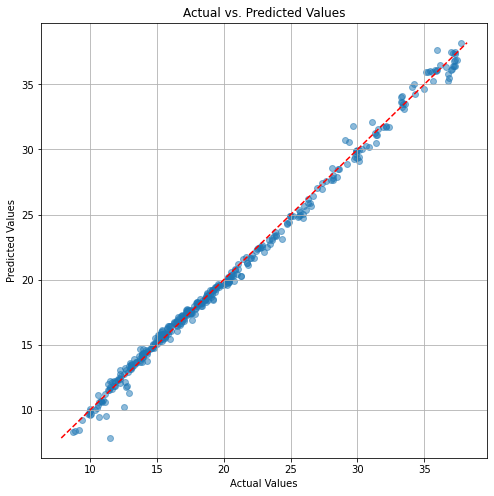

In [30]:
predicted_values = y_pred
actual_values = y_test
# Scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(actual_values, predicted_values, alpha=0.5)
plt.title("Actual vs. Predicted Values")
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")

min_val = min(np.min(actual_values), np.min(predicted_values))
max_val = max(np.max(actual_values), np.max(predicted_values))
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--')

plt.grid(True)
plt.show()

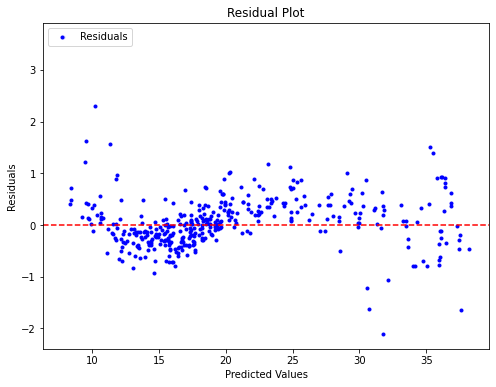

In [31]:
residuals = actual_values.squeeze() - predicted_values

plt.figure(figsize=(8, 6))
plt.scatter(predicted_values, residuals, color='blue', marker='.', label='Residuals')
plt.axhline(y=0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.legend(loc='upper left')
plt.show()

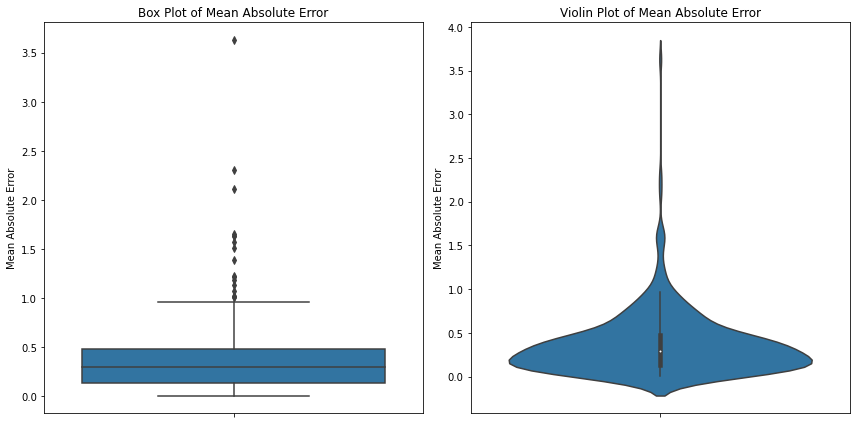

In [32]:
num_samples = len(predicted_values)

mae_values = [abs(residuals[i]) for i in range(num_samples)]


mae_df = pd.DataFrame(mae_values, columns=['MAE'])

plt.figure(figsize=(12, 6))

# Box plot
plt.subplot(1, 2, 1)  
sns.boxplot(data=mae_df, y='MAE')
plt.title('Box Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

# Violin plot
plt.subplot(1, 2, 2)  
sns.violinplot(data=mae_df, y='MAE')
plt.title('Violin Plot of Mean Absolute Error')
plt.ylabel('Mean Absolute Error')

plt.tight_layout()
plt.show()

In [35]:
testing_end
testing_start

1700477581.9991605